# **Parcial 2**

- Santiago Monsalve
- Iván Pinzón 
- Jorfan Vargas 
- Andres Yáñez

In [1]:
import pandas as pd
import numpy as np
import utils as ut
import matplotlib.pyplot as plt
import seaborn as sns
from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler

In [2]:
df = pd.read_csv(r'../base_modelo_40k.csv')
df.head()

,ID,CLIENTE_MORA,SEXO,EDAD,INGRESO,SCORE_DATACREDITO,CRED_REESTRUCTURADO,ANT_SF,SALDO_SF,TIENE_HIPOTECA,ULTIMAPERTURA,SALDO_FIJO,SALDO_ROT,ESTADO_MORA_FIN,ESTADO_MORA_REAL
0,245411,0,F,51,5.373539,675,0,6.83,133.124423,0,35,86.191899,68.093088,0.0,0.0
1,278521,0,M,32,20.009334,812,0,7.83,282.607212,0,18,68.242921,19.081655,0.0,0.0
2,58481,0,M,58,5.537541,812,0,6.17,10.650218,0,3,26.764786,44.264709,0.0,0.0
3,183771,0,F,40,5.838028,840,0,7.00,87.428428,1,7,32.291321,29.558226,0.0,0.0
4,310611,0,M,63,2.192562,625,0,0.00,0.000000,0,-1,0.000000,0.000000,0.0,0.0


In [3]:
df.shape

(40000, 15)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 15 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   40000 non-null  int64  
 1   CLIENTE_MORA         40000 non-null  int64  
 2   SEXO                 40000 non-null  object 
 3   EDAD                 40000 non-null  int64  
 4   INGRESO              40000 non-null  float64
 5   SCORE_DATACREDITO    40000 non-null  int64  
 6   CRED_REESTRUCTURADO  40000 non-null  int64  
 7   ANT_SF               40000 non-null  float64
 8   SALDO_SF             40000 non-null  float64
 9   TIENE_HIPOTECA       40000 non-null  int64  
 10  ULTIMAPERTURA        40000 non-null  int64  
 11  SALDO_FIJO           40000 non-null  float64
 12  SALDO_ROT            40000 non-null  float64
 13  ESTADO_MORA_FIN      40000 non-null  float64
 14  ESTADO_MORA_REAL     40000 non-null  float64
dtypes: float64(7), int64(7), object(1)
m

---
## **EDA**

### **Estadísticas descriptivas**

In [5]:
df = df.drop(['ID'], axis=1) 

In [6]:
df.columns

Index(['CLIENTE_MORA', 'SEXO', 'EDAD', 'INGRESO', 'SCORE_DATACREDITO',
       'CRED_REESTRUCTURADO', 'ANT_SF', 'SALDO_SF', 'TIENE_HIPOTECA',
       'ULTIMAPERTURA', 'SALDO_FIJO', 'SALDO_ROT', 'ESTADO_MORA_FIN',
       'ESTADO_MORA_REAL'],
      dtype='object')

Revisión de la distribución de la variable objetivo del conjunto de datos. 

In [7]:
df['CLIENTE_MORA'].value_counts()/len(df) * 100

CLIENTE_MORA
0    92.1375
1     7.8625
Name: count, dtype: float64

La base con 40.000 clientes, contiene un 7.86% de clientes en mora y un 92.13% de clientes al día. 

### **Análisis Univariado**

In [8]:
df['CRED_REESTRUCTURADO'] = df['CRED_REESTRUCTURADO'].astype('object')
df['TIENE_HIPOTECA'] = df['TIENE_HIPOTECA'].astype('object')

Columna: CLIENTE_MORA


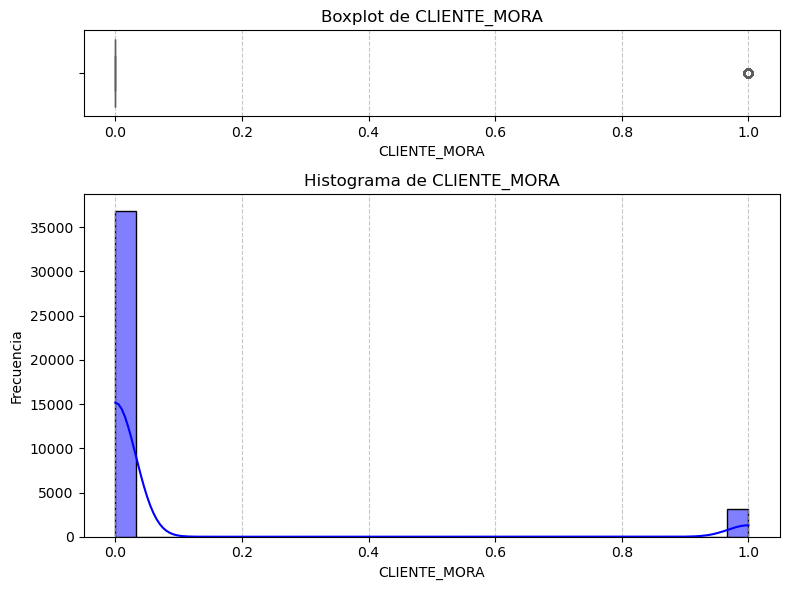

{'Nombre': 'CLIENTE_MORA', 'Tipo de datos': dtype('int64'), 'Porcentaje de valores nulos': 0.0, 'Estadística descriptivas': {'count': 40000.0, 'mean': 0.078625, 'std': 0.2691559408559178, 'min': 0.0, '25%': 0.0, '50%': 0.0, '75%': 0.0, 'max': 1.0}}
Columna: SEXO


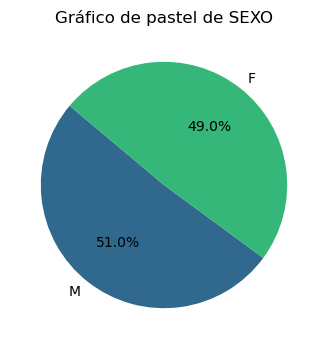

     Nombre Tipo de datos  Porcentaje de valores nulos  \
SEXO                                                     
M      SEXO        object                          0.0   
F      SEXO        object                          0.0   

      Porcentaje por categoría  Porcentaje acumulado  
SEXO                                                  
M                        51.02                 51.02  
F                        48.98                100.00  
Columna: EDAD


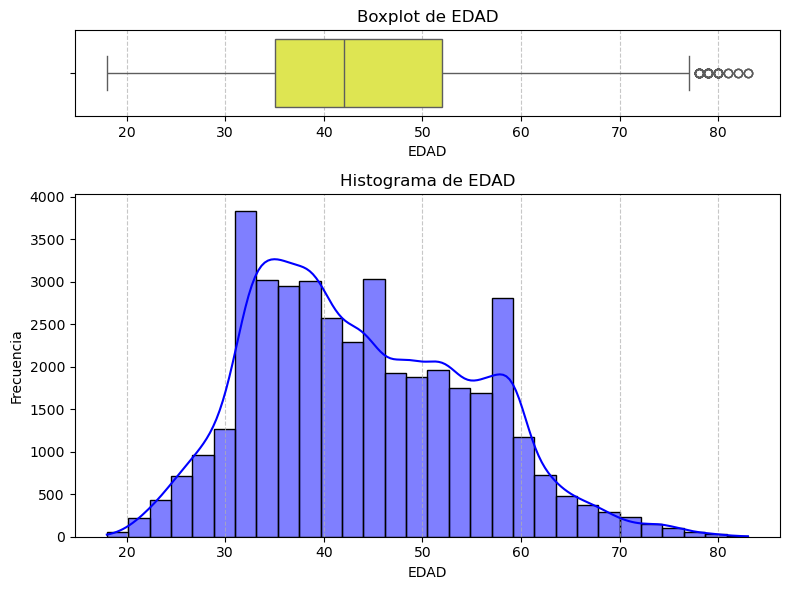

{'Nombre': 'EDAD', 'Tipo de datos': dtype('int64'), 'Porcentaje de valores nulos': 0.0, 'Estadística descriptivas': {'count': 40000.0, 'mean': 43.934075, 'std': 11.145944764645177, 'min': 18.0, '25%': 35.0, '50%': 42.0, '75%': 52.0, 'max': 83.0}}
Columna: INGRESO


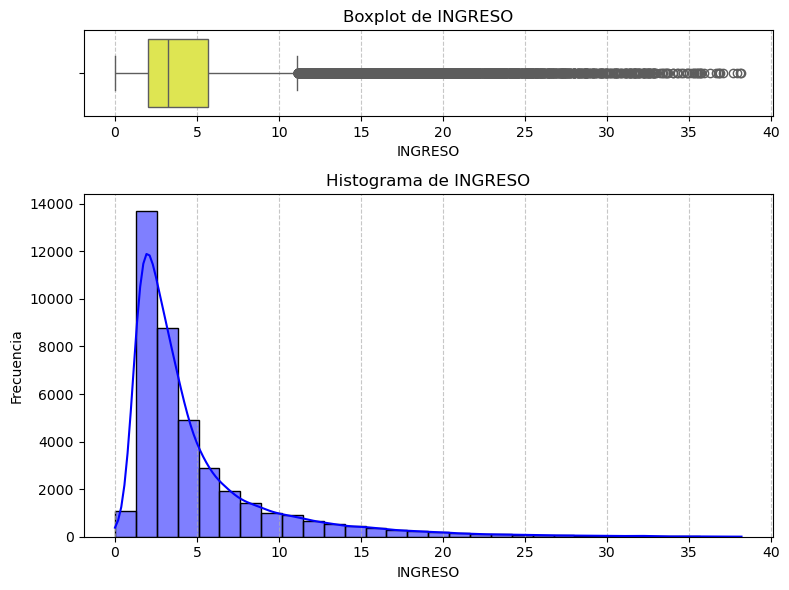

{'Nombre': 'INGRESO', 'Tipo de datos': dtype('float64'), 'Porcentaje de valores nulos': 0.0, 'Estadística descriptivas': {'count': 40000.0, 'mean': 4.854355488553776, 'std': 4.606260157493616, 'min': 0.0, '25%': 2.00984892, '50%': 3.215097861, '75%': 5.65751558, 'max': 38.20474043}}
Columna: SCORE_DATACREDITO


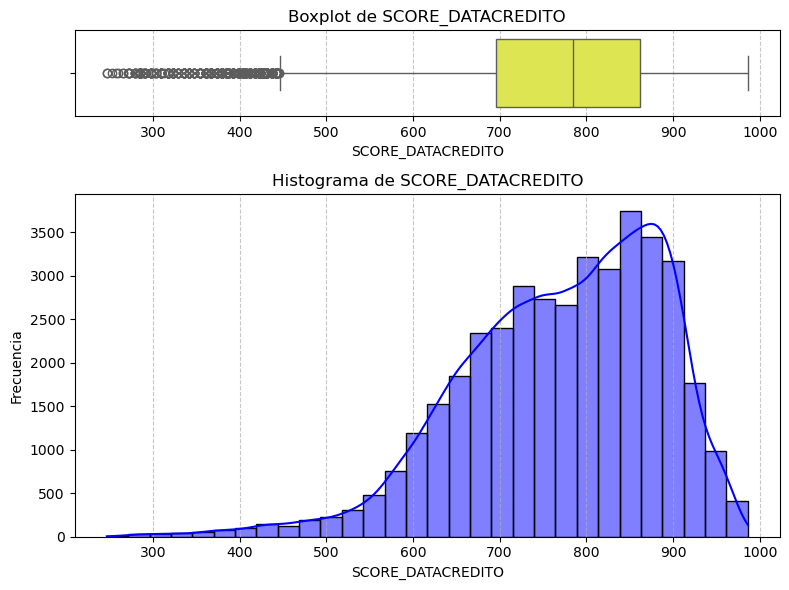

{'Nombre': 'SCORE_DATACREDITO', 'Tipo de datos': dtype('int64'), 'Porcentaje de valores nulos': 0.0, 'Estadística descriptivas': {'count': 40000.0, 'mean': 771.2972, 'std': 114.78577074920399, 'min': 247.0, '25%': 696.0, '50%': 785.0, '75%': 862.0, 'max': 986.0}}
Columna: CRED_REESTRUCTURADO


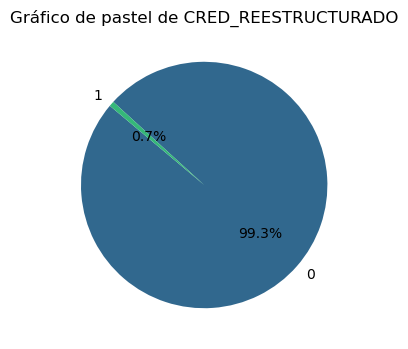

                                  Nombre Tipo de datos  \
CRED_REESTRUCTURADO                                      
0                    CRED_REESTRUCTURADO        object   
1                    CRED_REESTRUCTURADO        object   

                     Porcentaje de valores nulos  Porcentaje por categoría  \
CRED_REESTRUCTURADO                                                          
0                                            0.0                     99.32   
1                                            0.0                      0.68   

                     Porcentaje acumulado  
CRED_REESTRUCTURADO                        
0                                   99.32  
1                                  100.00  
Columna: ANT_SF


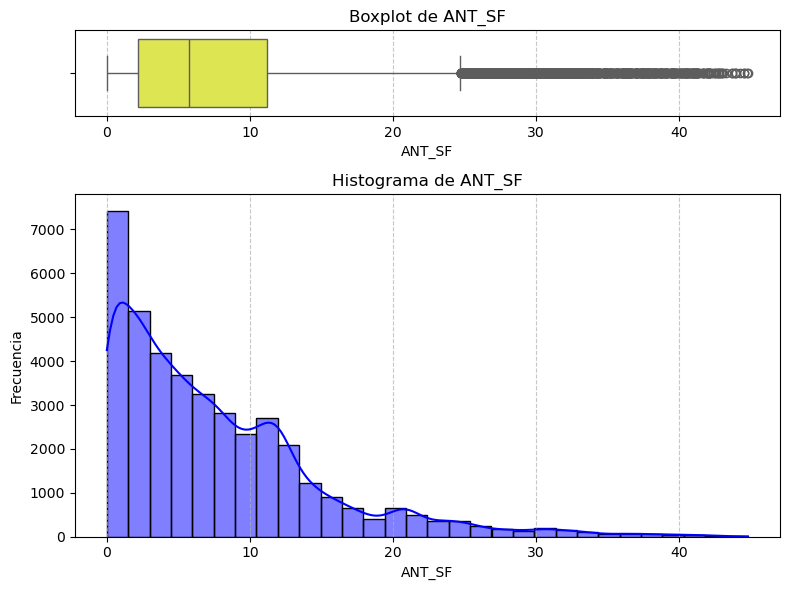

{'Nombre': 'ANT_SF', 'Tipo de datos': dtype('float64'), 'Porcentaje de valores nulos': 0.0, 'Estadística descriptivas': {'count': 40000.0, 'mean': 7.646425250000002, 'std': 7.251674977783201, 'min': 0.0, '25%': 2.17, '50%': 5.75, '75%': 11.17, 'max': 44.83}}
Columna: SALDO_SF


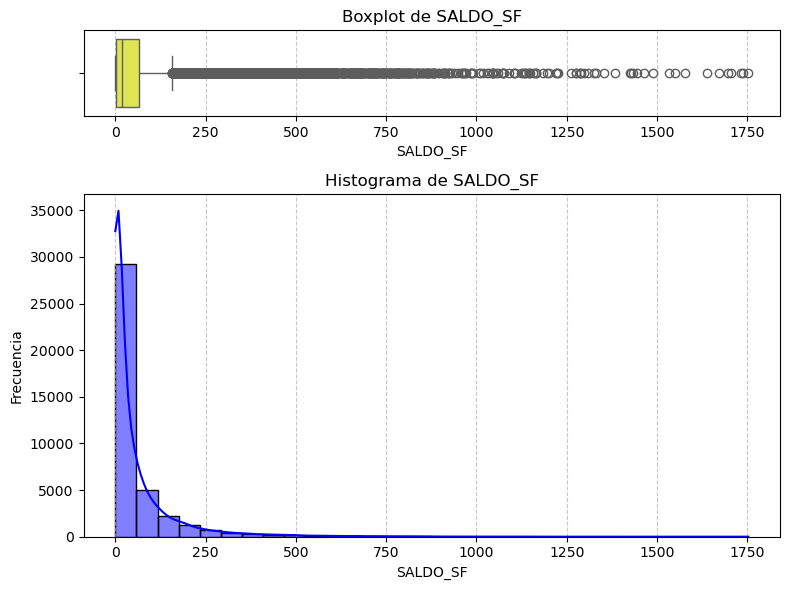

{'Nombre': 'SALDO_SF', 'Tipo de datos': dtype('float64'), 'Porcentaje de valores nulos': 0.0, 'Estadística descriptivas': {'count': 40000.0, 'mean': 58.965099350875, 'std': 113.91603979014376, 'min': 0.0, '25%': 2.236589, '50%': 17.257073, '75%': 64.6704105, 'max': 1752.83261}}
Columna: TIENE_HIPOTECA


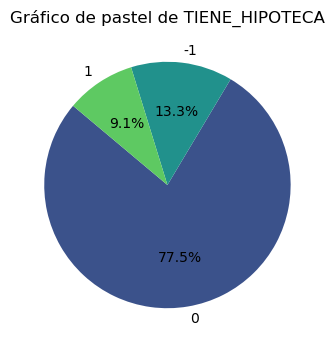

                        Nombre Tipo de datos  Porcentaje de valores nulos  \
TIENE_HIPOTECA                                                              
0               TIENE_HIPOTECA        object                          0.0   
-1              TIENE_HIPOTECA        object                          0.0   
1               TIENE_HIPOTECA        object                          0.0   

                Porcentaje por categoría  Porcentaje acumulado  
TIENE_HIPOTECA                                                  
0                                  77.54                 77.54  
-1                                 13.34                 90.88  
1                                   9.12                100.00  
Columna: ULTIMAPERTURA


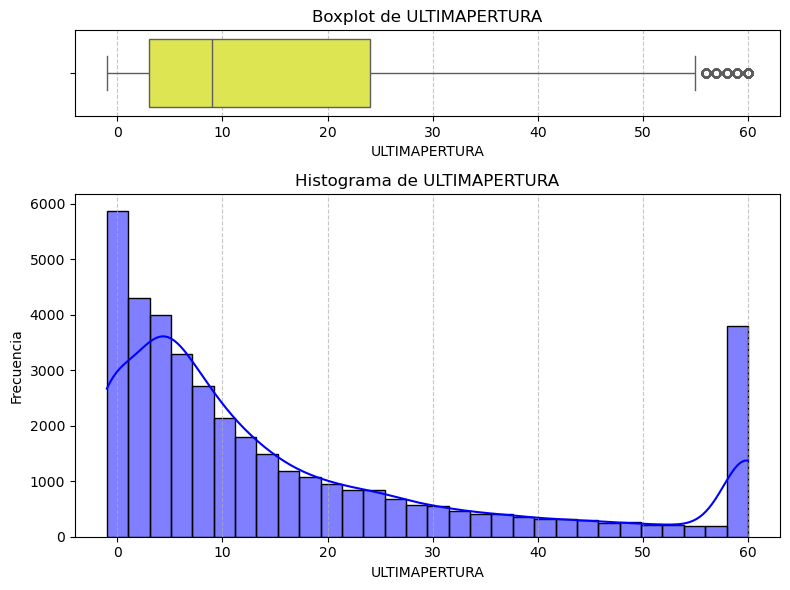

{'Nombre': 'ULTIMAPERTURA', 'Tipo de datos': dtype('int64'), 'Porcentaje de valores nulos': 0.0, 'Estadística descriptivas': {'count': 40000.0, 'mean': 16.88715, 'std': 18.805552533698133, 'min': -1.0, '25%': 3.0, '50%': 9.0, '75%': 24.0, 'max': 60.0}}
Columna: SALDO_FIJO


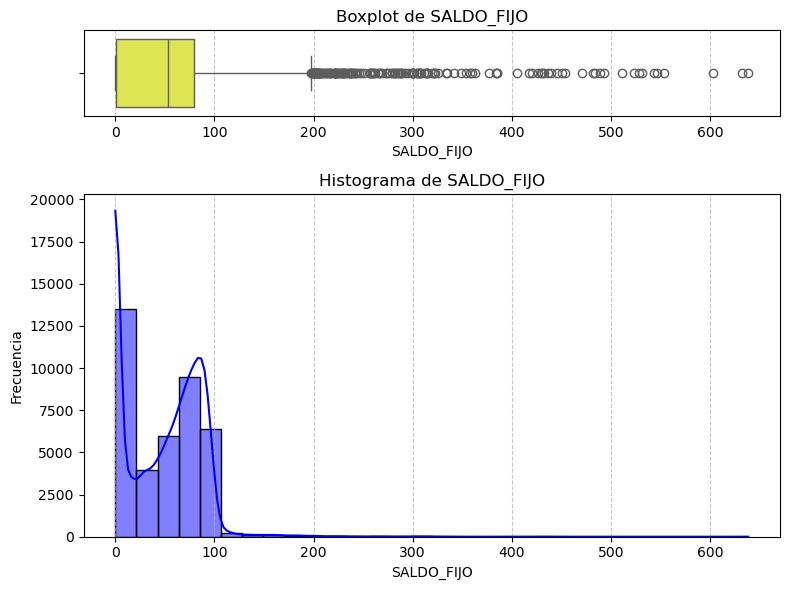

{'Nombre': 'SALDO_FIJO', 'Tipo de datos': dtype('float64'), 'Porcentaje de valores nulos': 0.0, 'Estadística descriptivas': {'count': 40000.0, 'mean': 47.788167558045345, 'std': 40.55842751295093, 'min': 0.0, '25%': 0.43852596125, '50%': 53.164554485, '75%': 79.4127019225, 'max': 638.5886205}}
Columna: SALDO_ROT


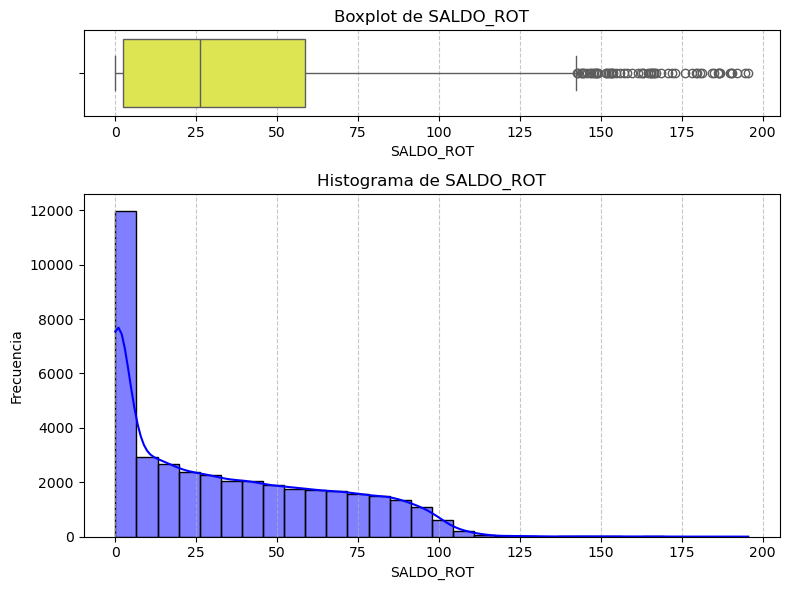

{'Nombre': 'SALDO_ROT', 'Tipo de datos': dtype('float64'), 'Porcentaje de valores nulos': 0.0, 'Estadística descriptivas': {'count': 40000.0, 'mean': 33.77761432987935, 'std': 31.92486244064782, 'min': 0.0, '25%': 2.51588878175, '50%': 26.10695385, '75%': 58.5510778825, 'max': 195.572859}}
Columna: ESTADO_MORA_FIN


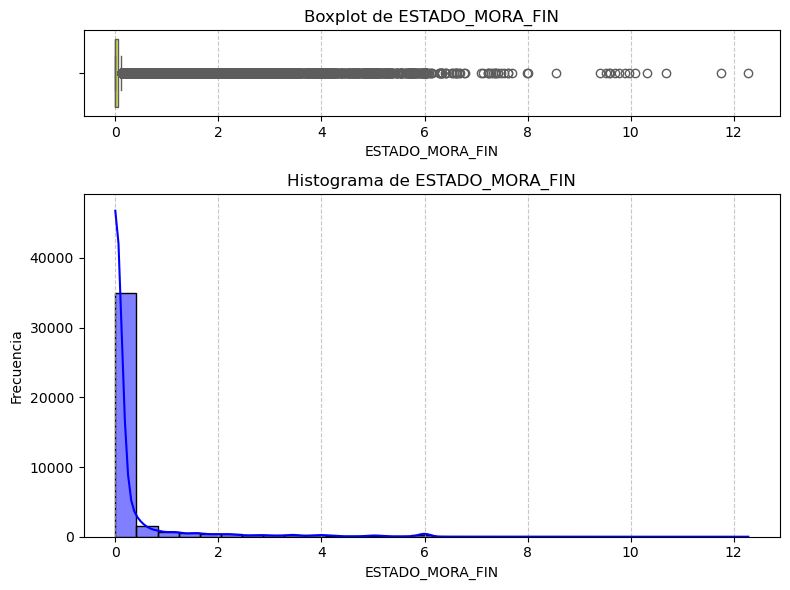

{'Nombre': 'ESTADO_MORA_FIN', 'Tipo de datos': dtype('float64'), 'Porcentaje de valores nulos': 0.0, 'Estadística descriptivas': {'count': 40000.0, 'mean': 0.28452403846365004, 'std': 0.9211134230513605, 'min': 0.0, '25%': 0.0, '50%': 0.0, '75%': 0.051282051, 'max': 12.28205128}}
Columna: ESTADO_MORA_REAL


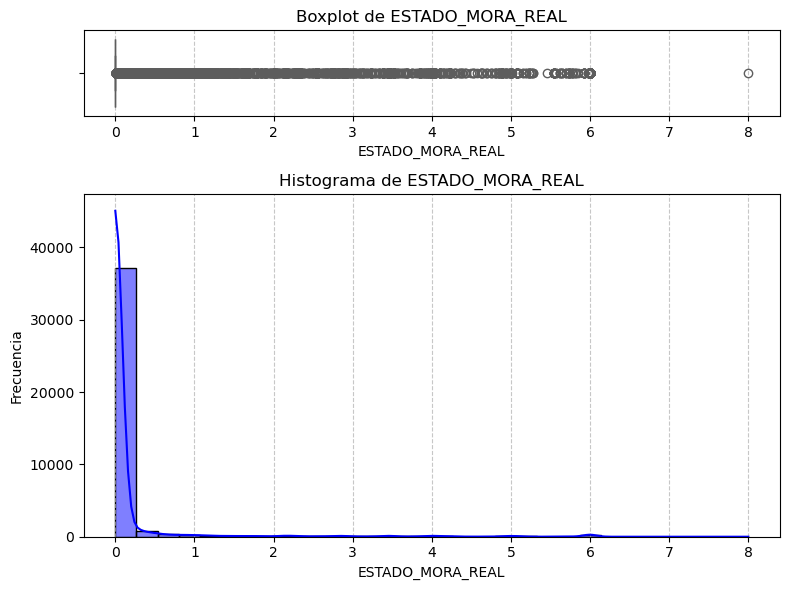

{'Nombre': 'ESTADO_MORA_REAL', 'Tipo de datos': dtype('float64'), 'Porcentaje de valores nulos': 0.0, 'Estadística descriptivas': {'count': 40000.0, 'mean': 0.14684358974577502, 'std': 0.716838372543212, 'min': 0.0, '25%': 0.0, '50%': 0.0, '75%': 0.0, 'max': 8.0}}


In [9]:
for col in df.columns:
    print(f'Columna: {col}')
    ut.analizar_columna(df, col, True, True)

El análisis univariado muestra que las variables numéricas presentan una distribución asimétrica (no normal), con la mayoría de los valores concentrados en el extremo inferior y una cola larga hacia la derecha. Esto indica que hay algunos valores atípicos o extremos que podrían influir en el análisis posterior. Además, las variables categóricas tienen una distribución desigual (exceptuando la variable 'GENERO'), con algunas categorías dominando sobre otras.

### **Análisis Bivariado**

In [11]:
num_cols = df.select_dtypes(include=['int64', 'float64']).columns
cat_cols = df.select_dtypes(include=['object']).columns

#### **Númericas vs Númericas**

Análisis bivariado númerico entre CLIENTE_MORA y EDAD


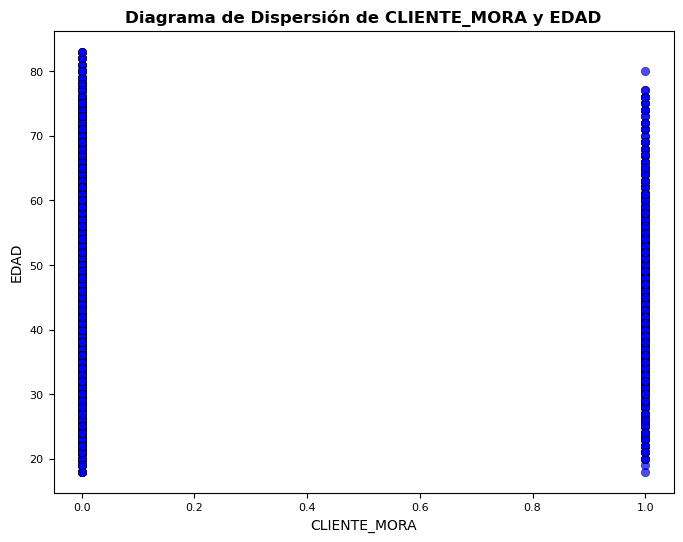

Correlación de Spearman: -0.034613364557586755, p-valor: 4.374211712931695e-12
Análisis bivariado númerico entre CLIENTE_MORA y INGRESO


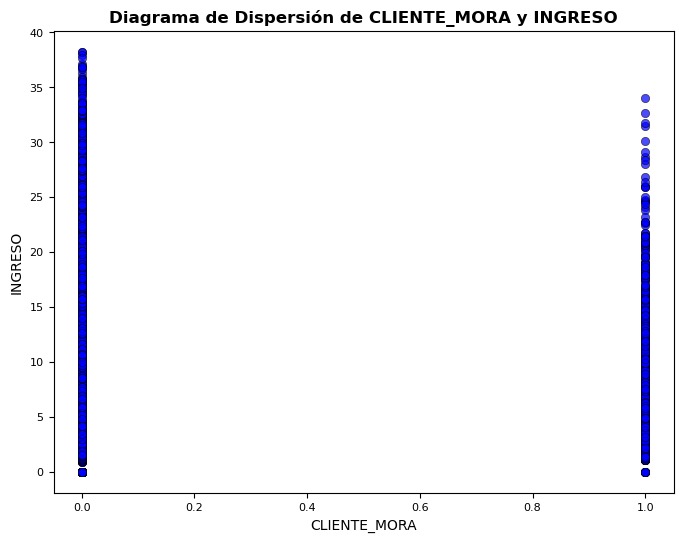

Correlación de Spearman: -0.0564795748849985, p-valor: 1.2454065400465548e-29
Análisis bivariado númerico entre CLIENTE_MORA y SCORE_DATACREDITO


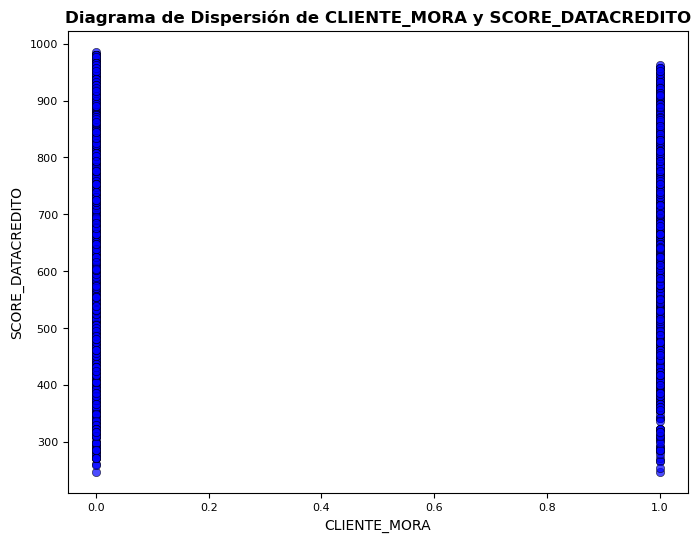

Correlación de Spearman: -0.24708512469012917, p-valor: 0.0
Análisis bivariado númerico entre CLIENTE_MORA y ANT_SF


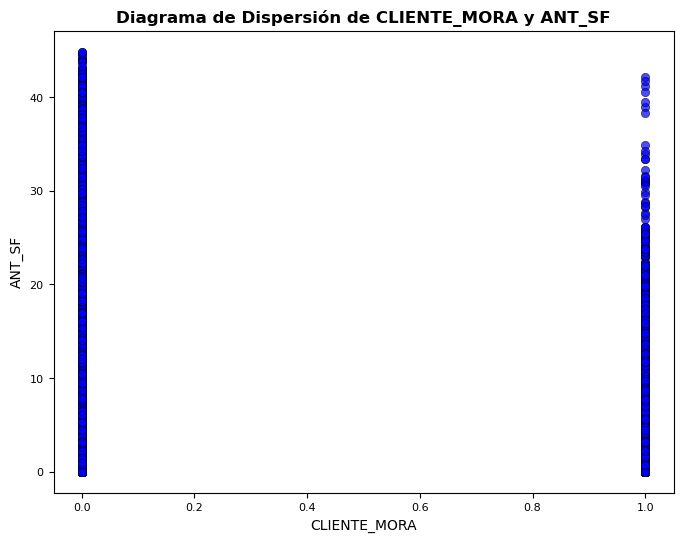

Correlación de Spearman: -0.07040025271584914, p-valor: 3.956830764602972e-45
Análisis bivariado númerico entre CLIENTE_MORA y SALDO_SF


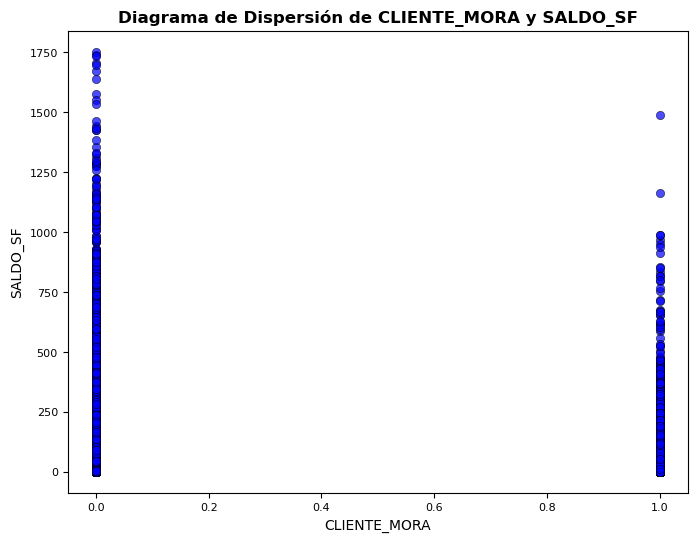

Correlación de Spearman: 0.0019452851526807716, p-valor: 0.6972426804054298
Análisis bivariado númerico entre CLIENTE_MORA y ULTIMAPERTURA


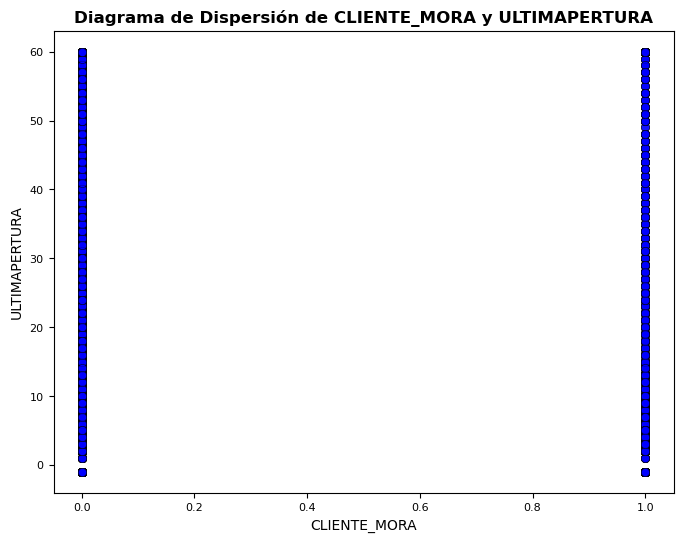

Correlación de Spearman: -0.03770596790713229, p-valor: 4.57030615641514e-14
Análisis bivariado númerico entre CLIENTE_MORA y SALDO_FIJO


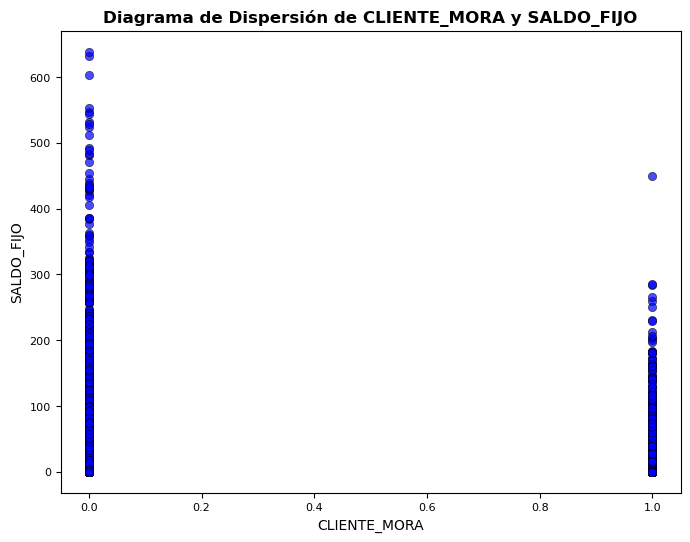

Correlación de Spearman: 0.061764311680788435, p-valor: 4.078423215984627e-35
Análisis bivariado númerico entre CLIENTE_MORA y SALDO_ROT


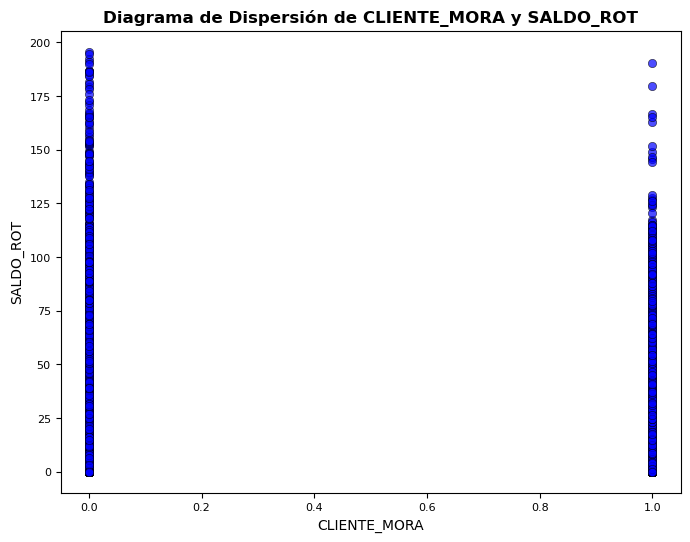

Correlación de Spearman: 0.08530064241593056, p-valor: 1.739208140983358e-65
Análisis bivariado númerico entre CLIENTE_MORA y ESTADO_MORA_FIN


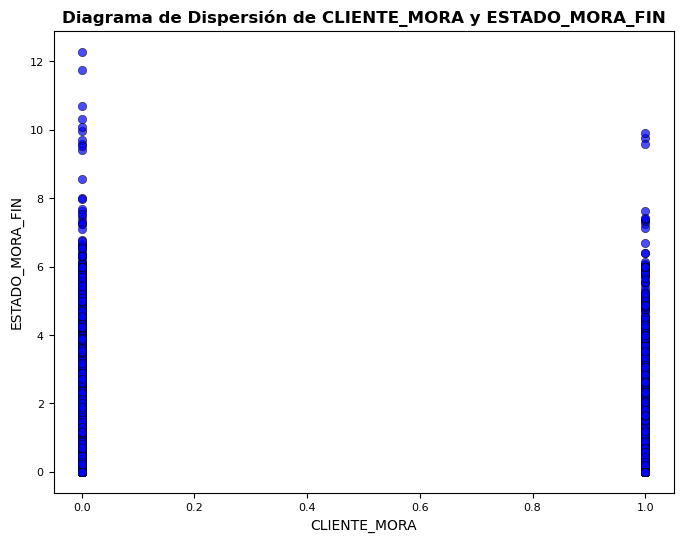

Correlación de Spearman: 0.14921941817029322, p-valor: 7.028929137659719e-198
Análisis bivariado númerico entre CLIENTE_MORA y ESTADO_MORA_REAL


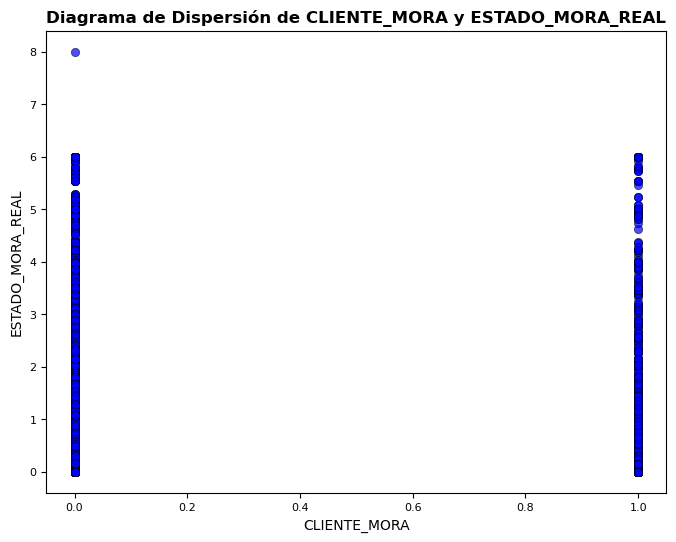

Correlación de Spearman: 0.08653032387363548, p-valor: 2.4283719194536808e-67
Análisis bivariado númerico entre EDAD y CLIENTE_MORA


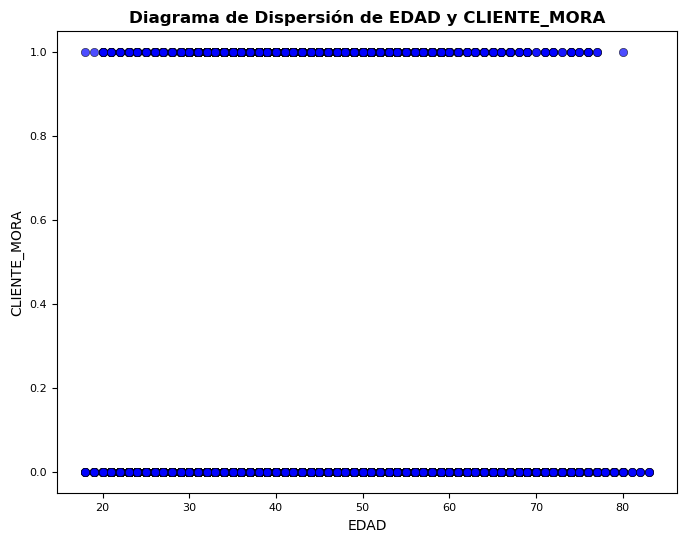

Correlación de Spearman: -0.034613364557586755, p-valor: 4.374211712931695e-12
Análisis bivariado númerico entre EDAD y INGRESO


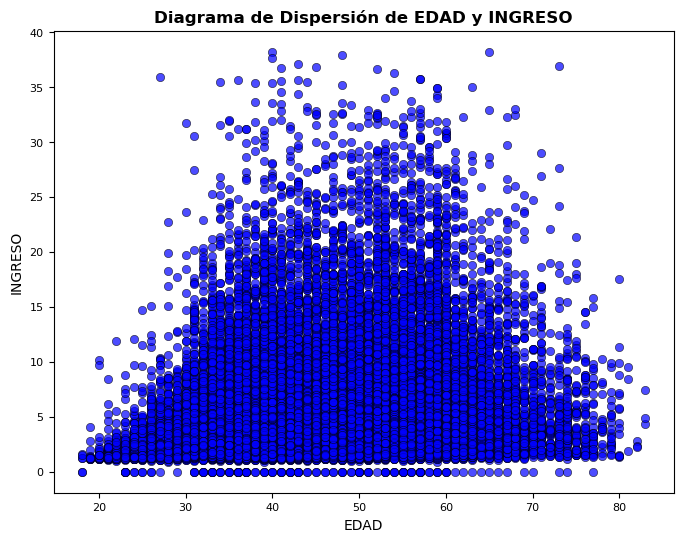

Correlación de Spearman: 0.272487141045149, p-valor: 0.0
Análisis bivariado númerico entre EDAD y SCORE_DATACREDITO


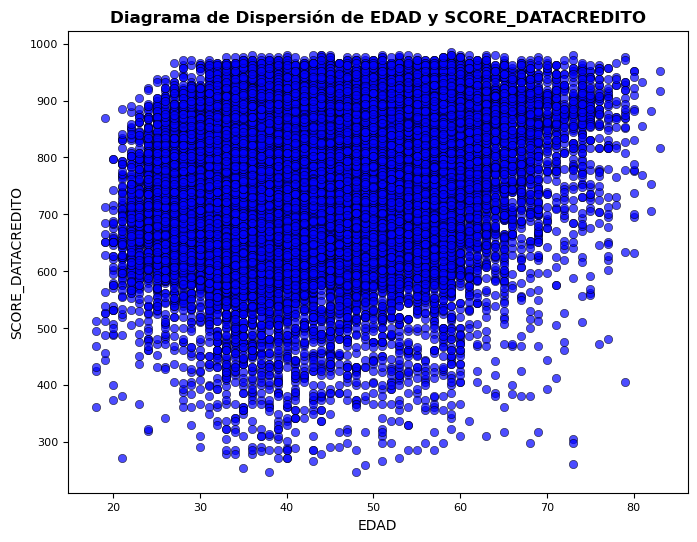

Correlación de Spearman: 0.20253489304544844, p-valor: 0.0
Análisis bivariado númerico entre EDAD y ANT_SF


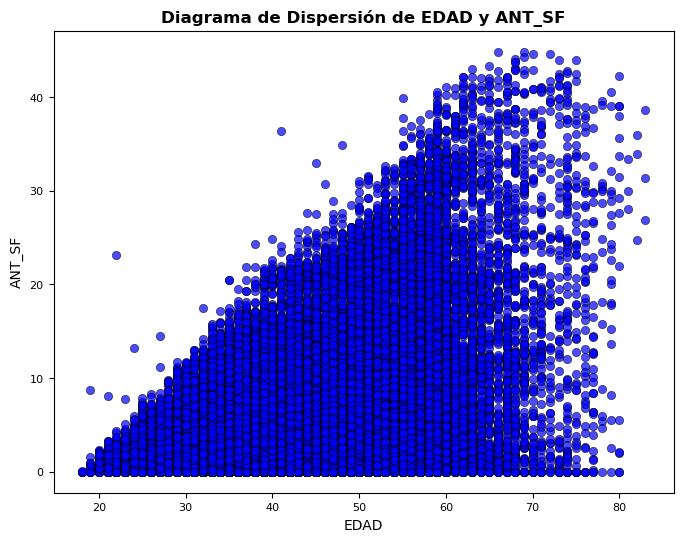

Correlación de Spearman: 0.3875770469648529, p-valor: 0.0
Análisis bivariado númerico entre EDAD y SALDO_SF


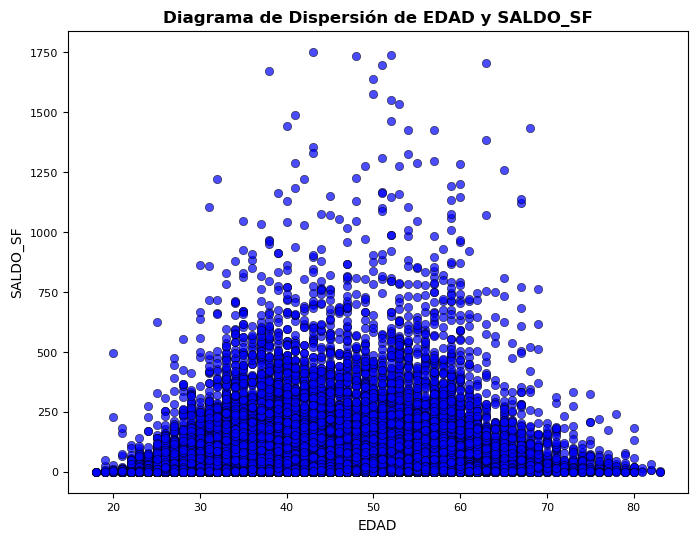

Correlación de Spearman: 0.08925410625639896, p-valor: 1.516961581494496e-71
Análisis bivariado númerico entre EDAD y ULTIMAPERTURA


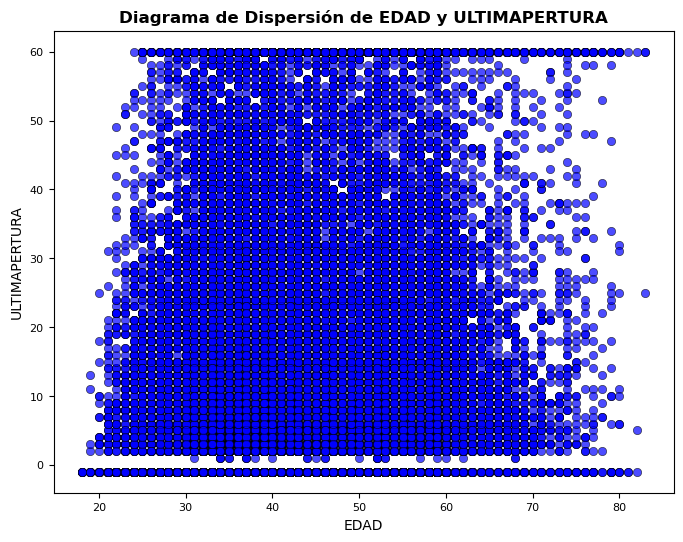

Correlación de Spearman: 0.0825414139473095, p-valor: 2.020367986223448e-61
Análisis bivariado númerico entre EDAD y SALDO_FIJO


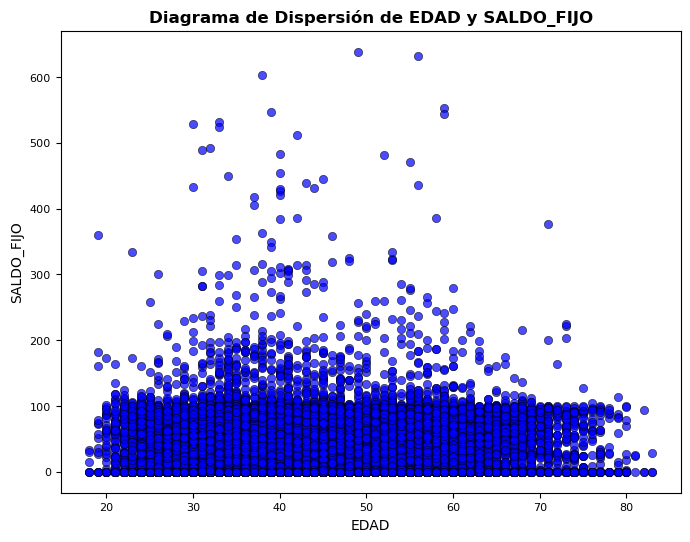

Correlación de Spearman: 0.00603810454384283, p-valor: 0.22720340011478876
Análisis bivariado númerico entre EDAD y SALDO_ROT


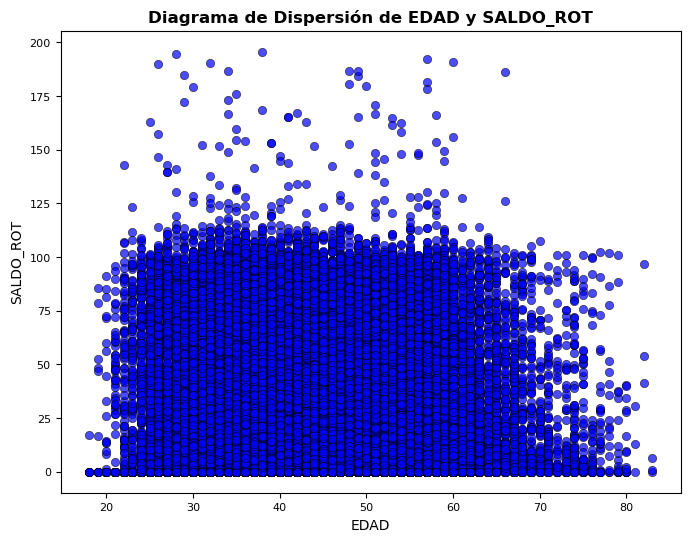

Correlación de Spearman: -0.0436299222173789, p-valor: 2.5496878571013226e-18
Análisis bivariado númerico entre EDAD y ESTADO_MORA_FIN


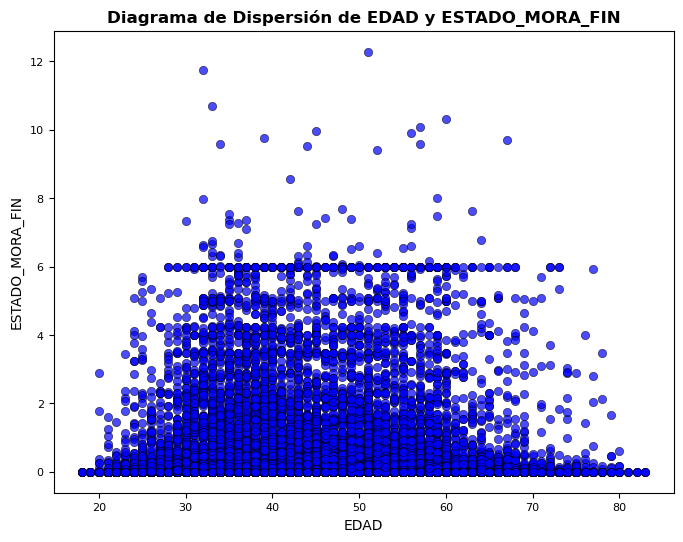

Correlación de Spearman: -0.0037912947405212834, p-valor: 0.4483085300266555
Análisis bivariado númerico entre EDAD y ESTADO_MORA_REAL


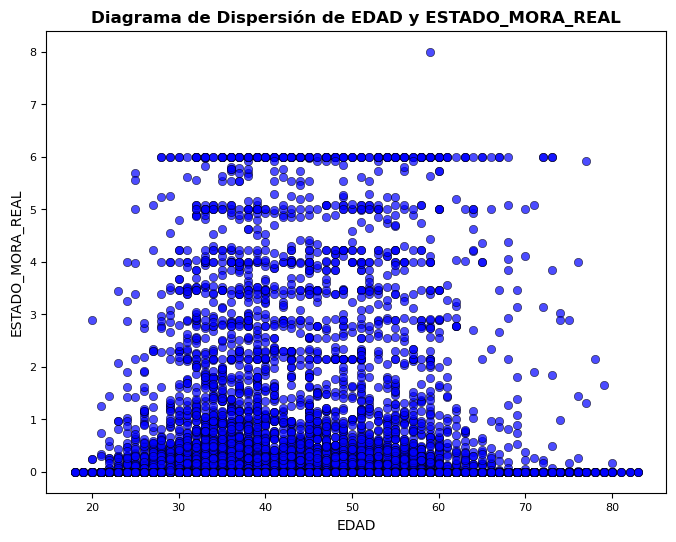

Correlación de Spearman: -0.028102325624633787, p-valor: 1.8941656573591953e-08
Análisis bivariado númerico entre INGRESO y CLIENTE_MORA


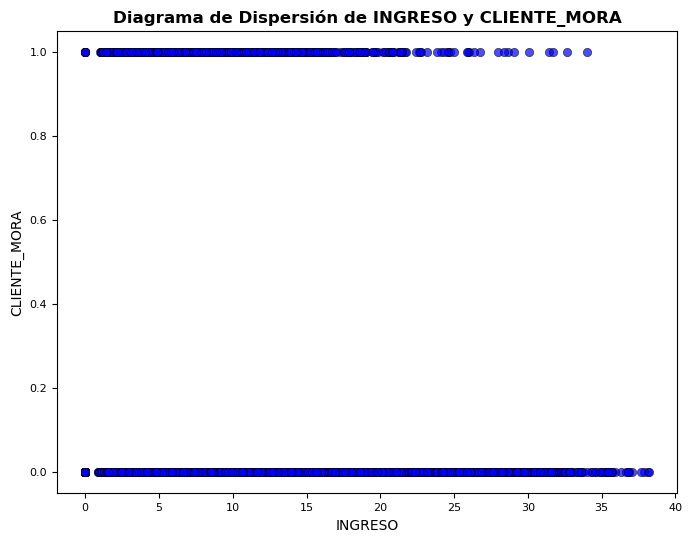

Correlación de Spearman: -0.05647957488499851, p-valor: 1.2454065400465548e-29
Análisis bivariado númerico entre INGRESO y EDAD


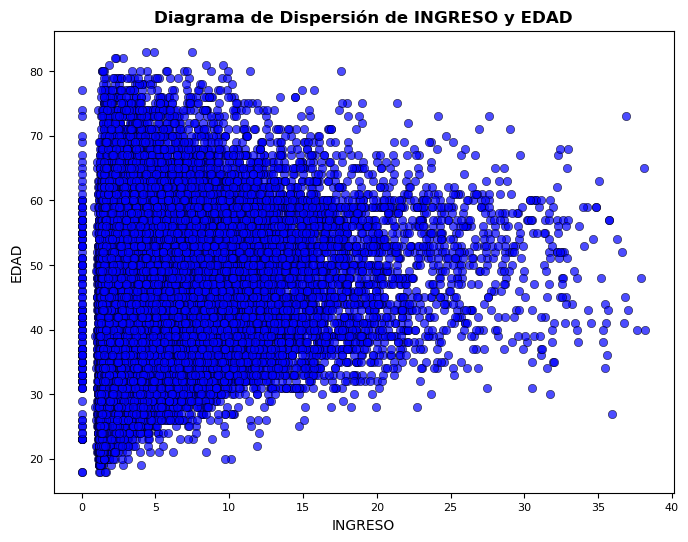

Correlación de Spearman: 0.272487141045149, p-valor: 0.0
Análisis bivariado númerico entre INGRESO y SCORE_DATACREDITO


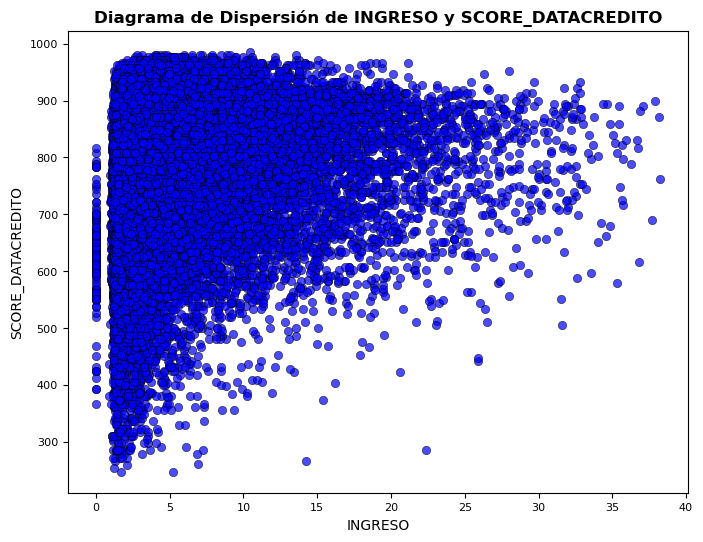

Correlación de Spearman: 0.27312579242150287, p-valor: 0.0
Análisis bivariado númerico entre INGRESO y ANT_SF


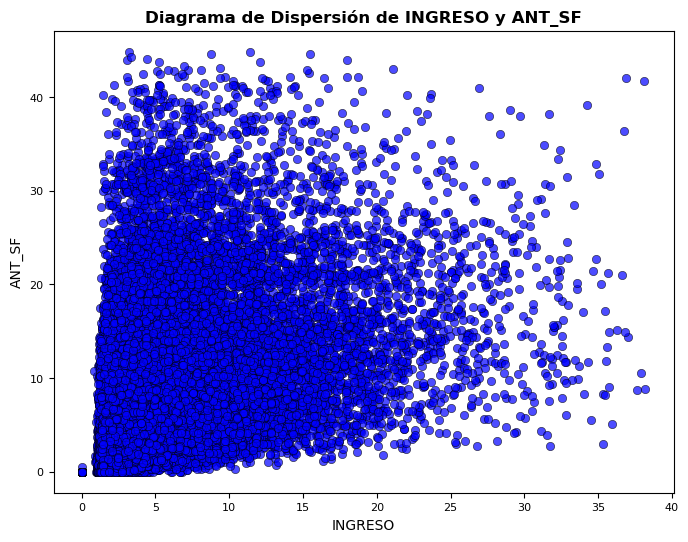

Correlación de Spearman: 0.5923516566931861, p-valor: 0.0
Análisis bivariado númerico entre INGRESO y SALDO_SF


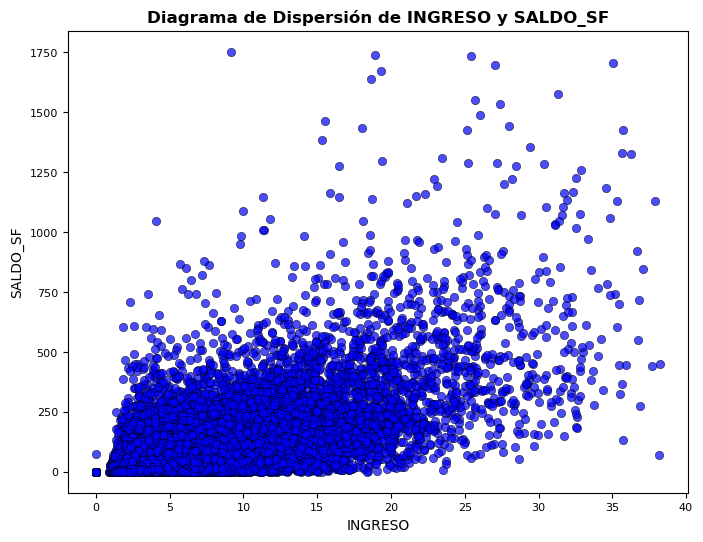

Correlación de Spearman: 0.6898870154464052, p-valor: 0.0
Análisis bivariado númerico entre INGRESO y ULTIMAPERTURA


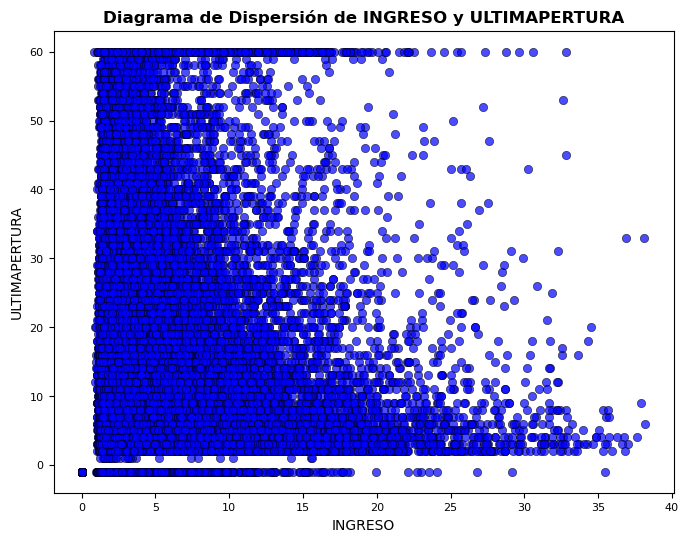

Correlación de Spearman: 0.12154079686632402, p-valor: 1.800525336730545e-131
Análisis bivariado númerico entre INGRESO y SALDO_FIJO


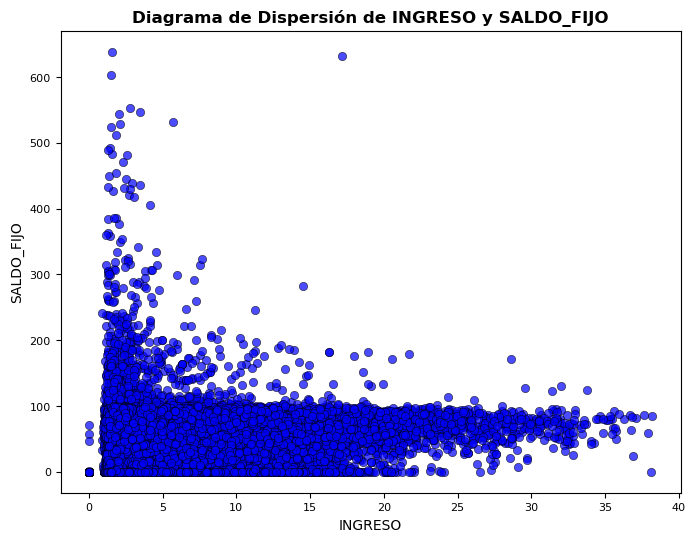

Correlación de Spearman: 0.22009716588474032, p-valor: 0.0
Análisis bivariado númerico entre INGRESO y SALDO_ROT


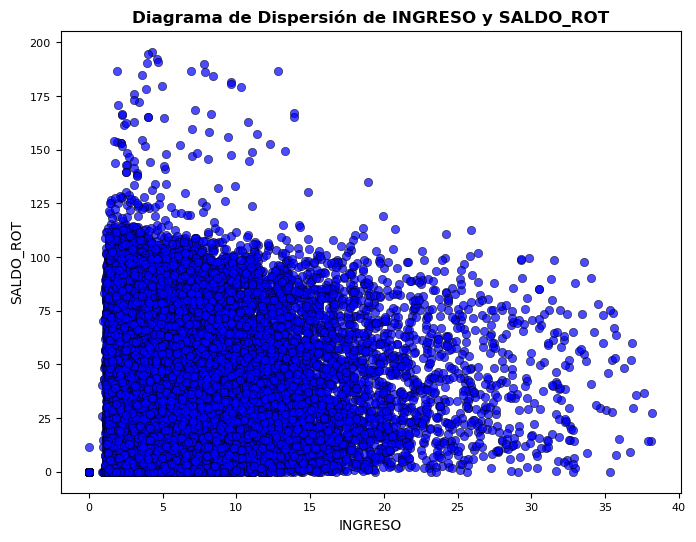

Correlación de Spearman: 0.3014301930640202, p-valor: 0.0
Análisis bivariado númerico entre INGRESO y ESTADO_MORA_FIN


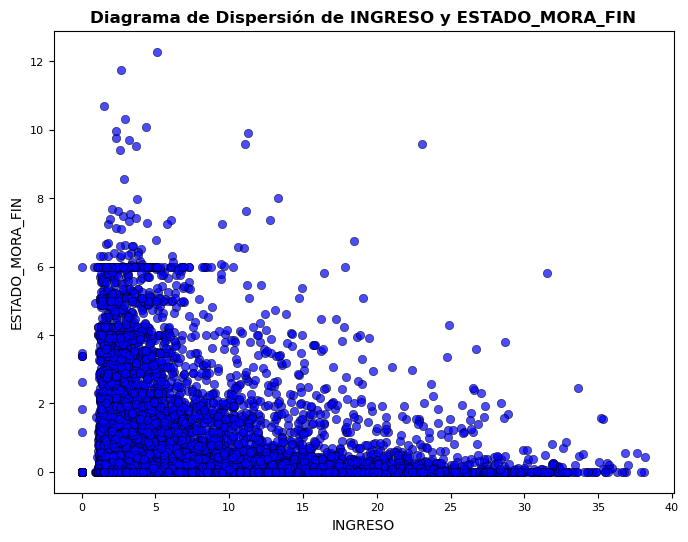

Correlación de Spearman: 0.07781356356771923, p-valor: 9.083104017749773e-55
Análisis bivariado númerico entre INGRESO y ESTADO_MORA_REAL


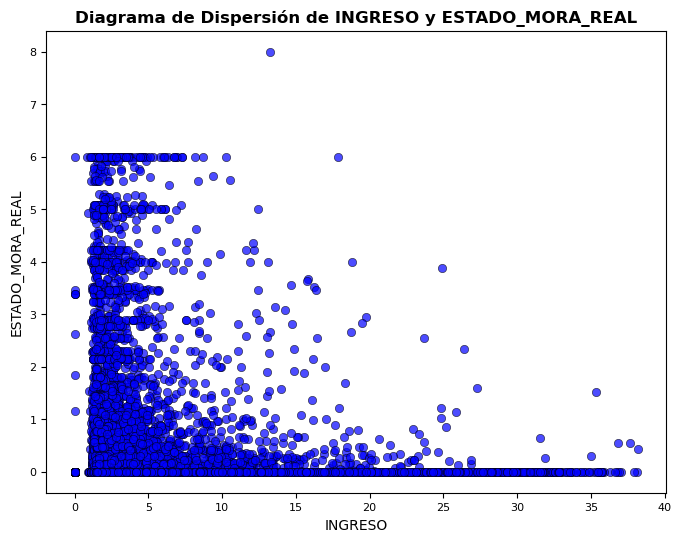

Correlación de Spearman: -0.07894641901054204, p-valor: 2.512197012364088e-56
Análisis bivariado númerico entre SCORE_DATACREDITO y CLIENTE_MORA


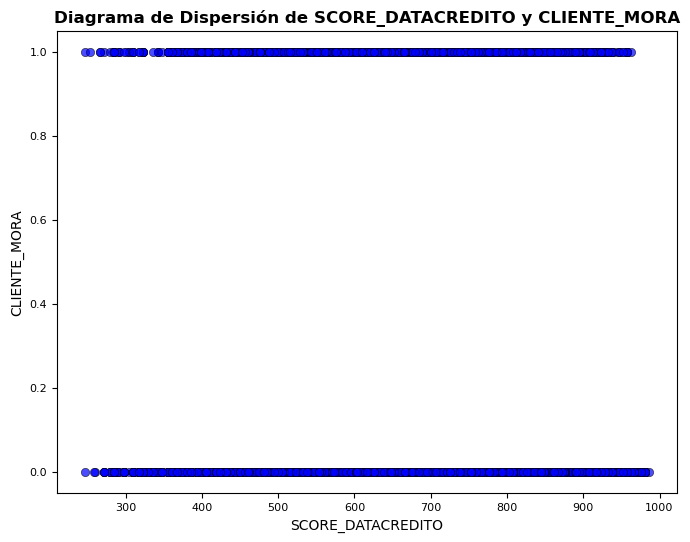

Correlación de Spearman: -0.2470851246901292, p-valor: 0.0
Análisis bivariado númerico entre SCORE_DATACREDITO y EDAD


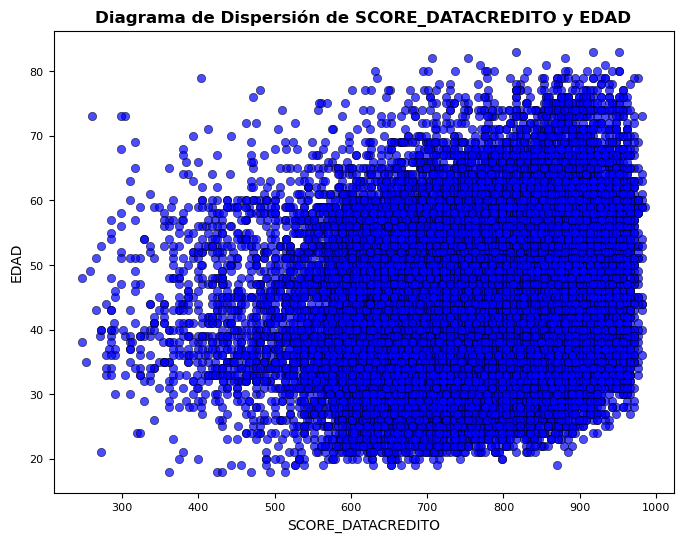

Correlación de Spearman: 0.20253489304544844, p-valor: 0.0
Análisis bivariado númerico entre SCORE_DATACREDITO y INGRESO


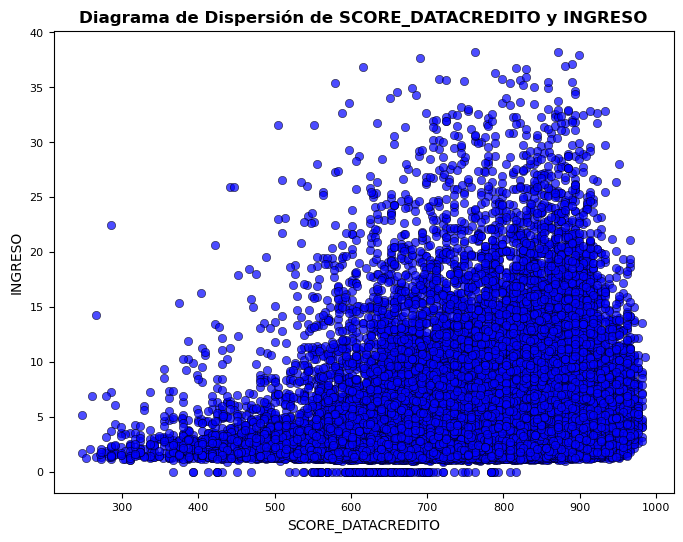

Correlación de Spearman: 0.27312579242150287, p-valor: 0.0
Análisis bivariado númerico entre SCORE_DATACREDITO y ANT_SF


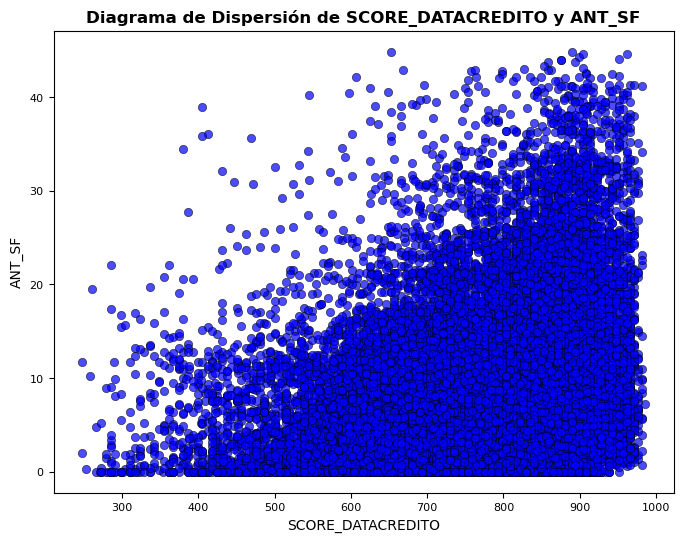

Correlación de Spearman: 0.3314421840413383, p-valor: 0.0
Análisis bivariado númerico entre SCORE_DATACREDITO y SALDO_SF


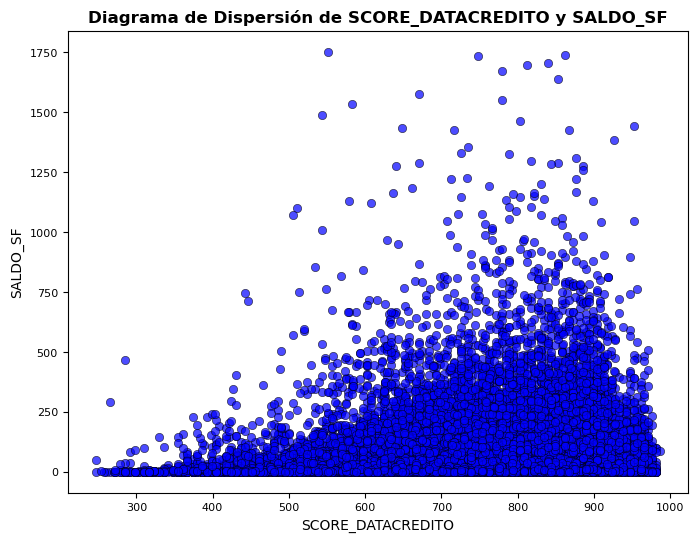

Correlación de Spearman: 0.0687554755877066, p-valor: 4.028202261327409e-43
Análisis bivariado númerico entre SCORE_DATACREDITO y ULTIMAPERTURA


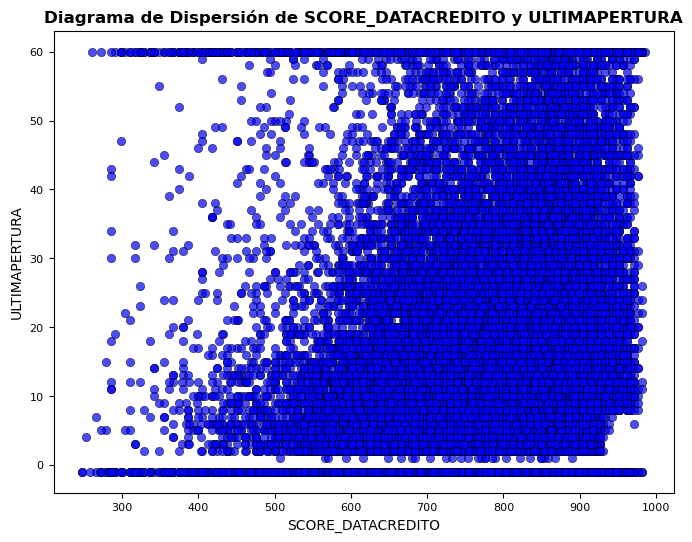

Correlación de Spearman: 0.23651450072483818, p-valor: 0.0
Análisis bivariado númerico entre SCORE_DATACREDITO y SALDO_FIJO


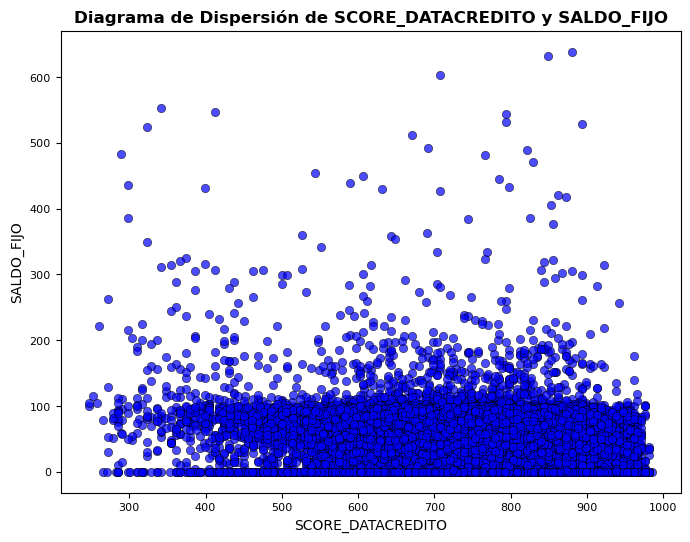

Correlación de Spearman: -0.20522712269050947, p-valor: 0.0
Análisis bivariado númerico entre SCORE_DATACREDITO y SALDO_ROT


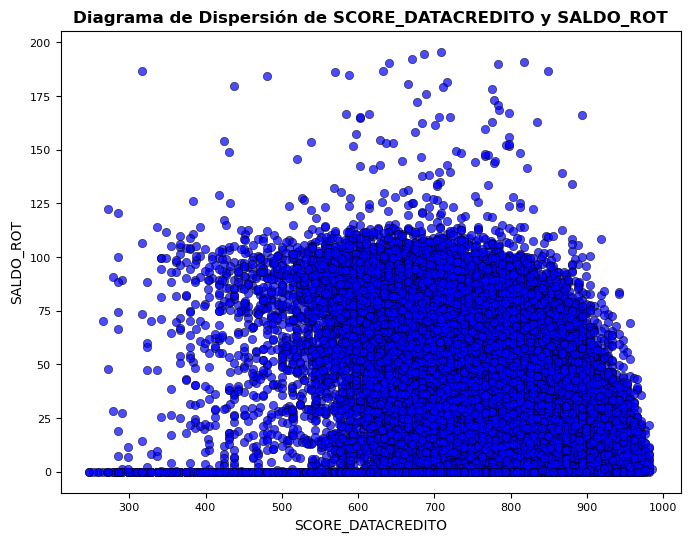

Correlación de Spearman: -0.2682053627334179, p-valor: 0.0
Análisis bivariado númerico entre SCORE_DATACREDITO y ESTADO_MORA_FIN


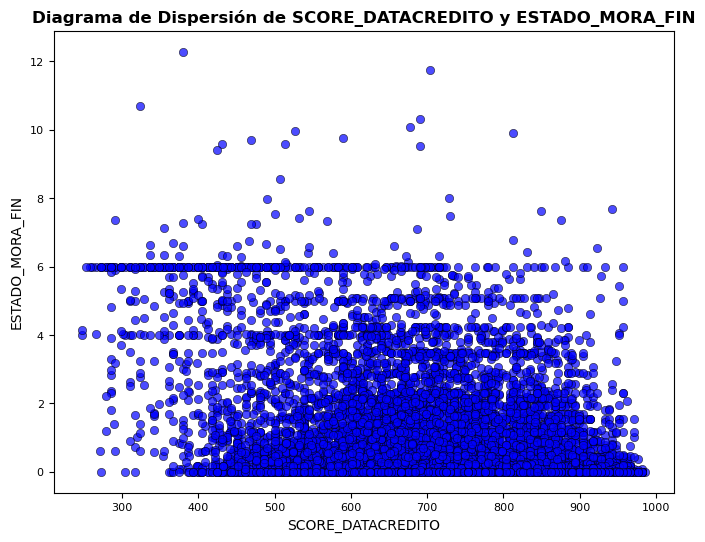

Correlación de Spearman: -0.29114975389822817, p-valor: 0.0
Análisis bivariado númerico entre SCORE_DATACREDITO y ESTADO_MORA_REAL


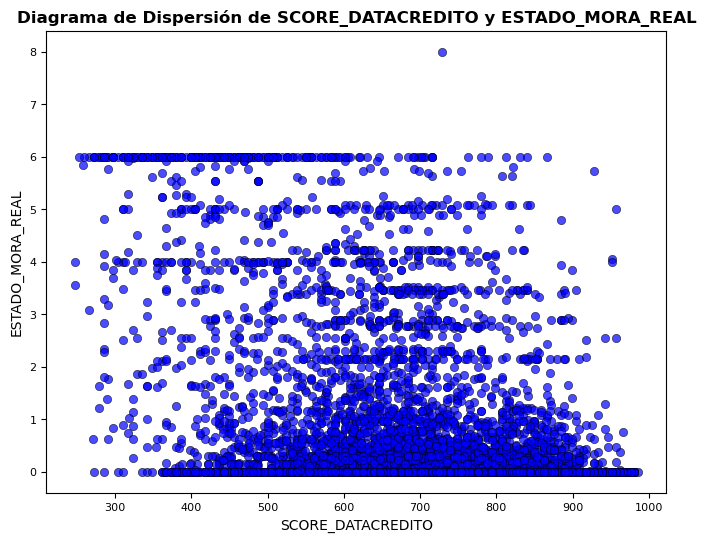

Correlación de Spearman: -0.2801108170170822, p-valor: 0.0
Análisis bivariado númerico entre ANT_SF y CLIENTE_MORA


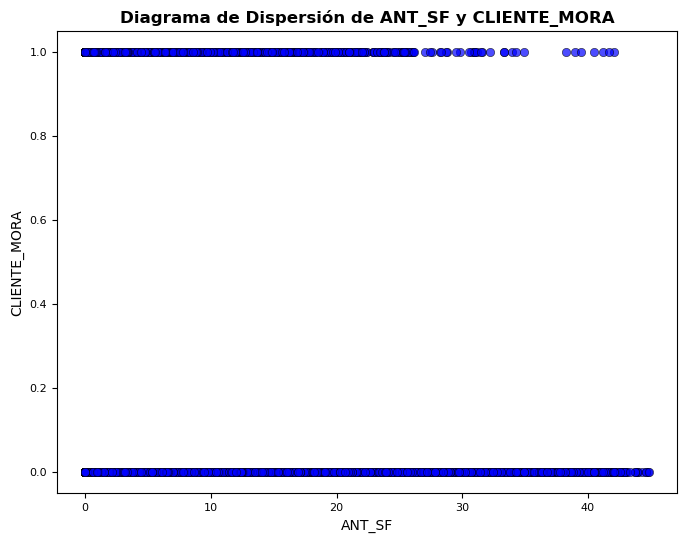

Correlación de Spearman: -0.07040025271584913, p-valor: 3.956830764603141e-45
Análisis bivariado númerico entre ANT_SF y EDAD


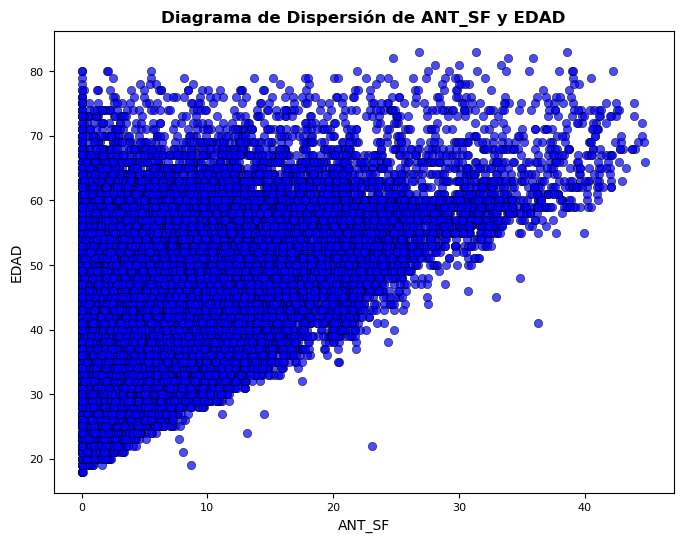

Correlación de Spearman: 0.38757704696485284, p-valor: 0.0
Análisis bivariado númerico entre ANT_SF y INGRESO


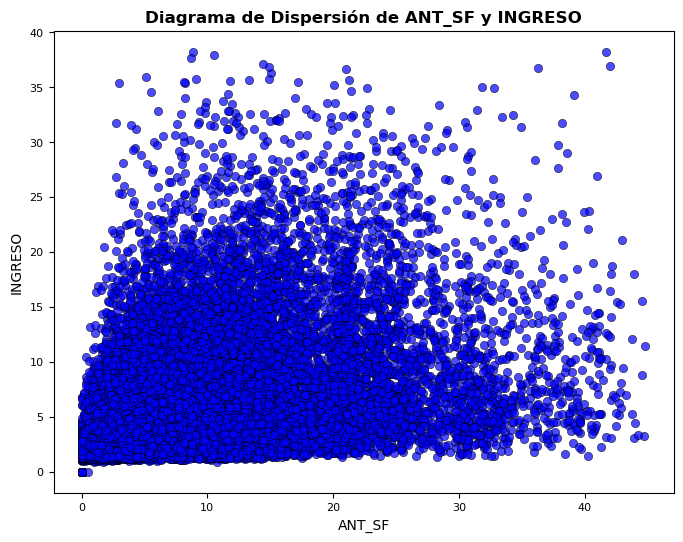

Correlación de Spearman: 0.5923516566931861, p-valor: 0.0
Análisis bivariado númerico entre ANT_SF y SCORE_DATACREDITO


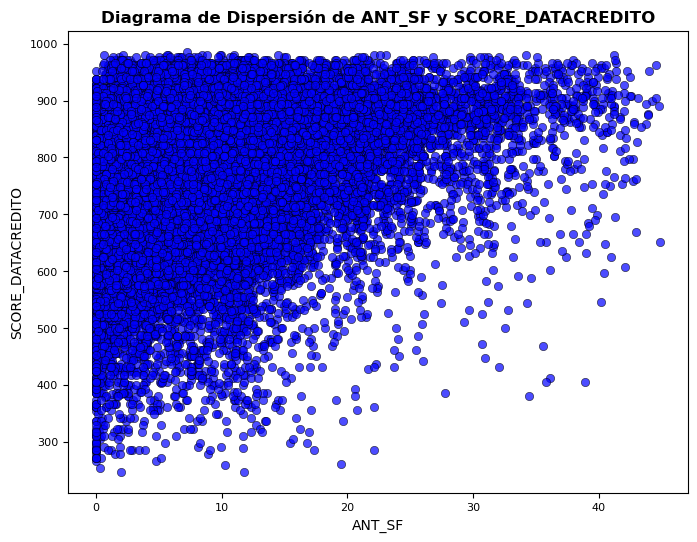

Correlación de Spearman: 0.3314421840413383, p-valor: 0.0
Análisis bivariado númerico entre ANT_SF y SALDO_SF


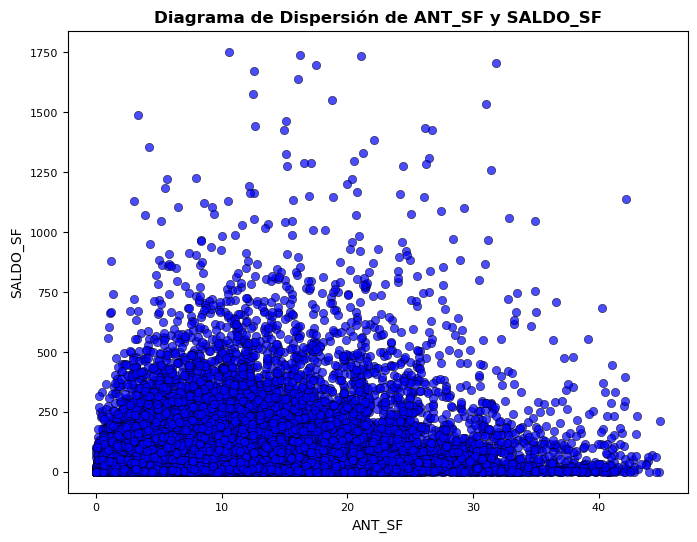

Correlación de Spearman: 0.4393145764951858, p-valor: 0.0
Análisis bivariado númerico entre ANT_SF y ULTIMAPERTURA


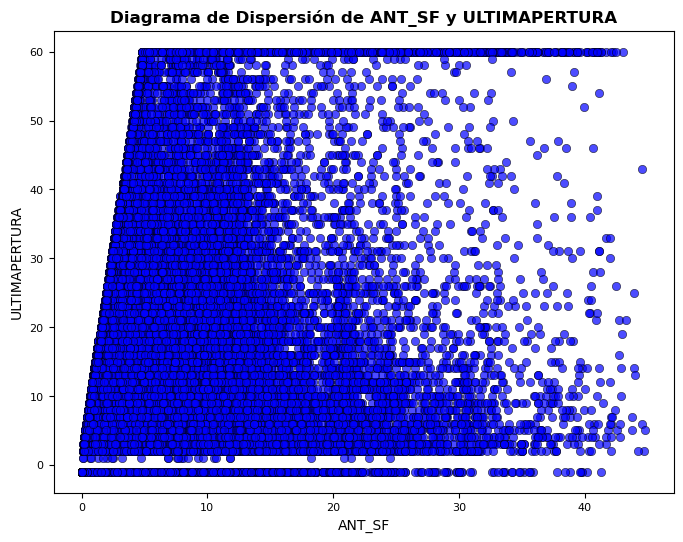

Correlación de Spearman: 0.3669080183180145, p-valor: 0.0
Análisis bivariado númerico entre ANT_SF y SALDO_FIJO


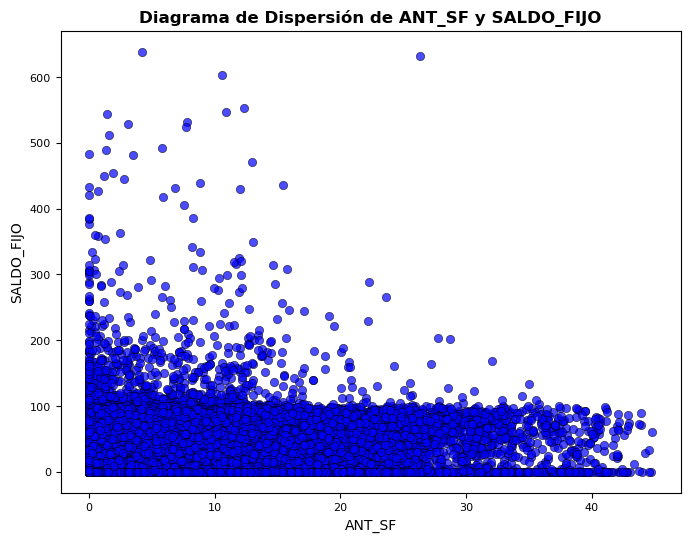

Correlación de Spearman: 0.08122623959907452, p-valor: 1.5692169409793365e-59
Análisis bivariado númerico entre ANT_SF y SALDO_ROT


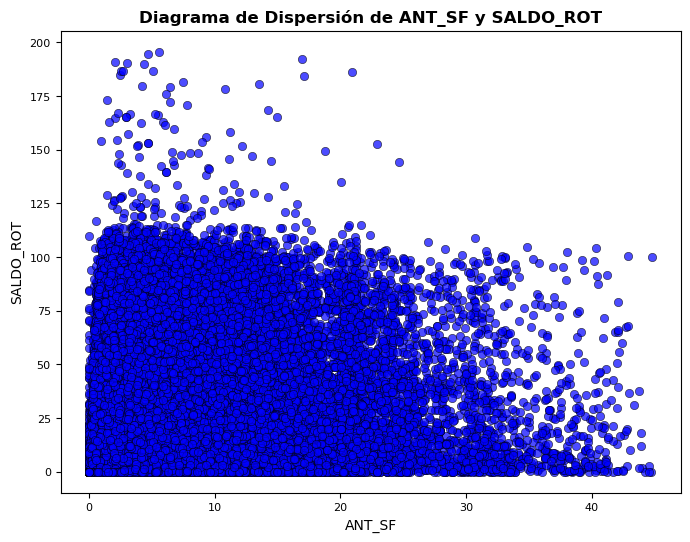

Correlación de Spearman: 0.2805778809218711, p-valor: 0.0
Análisis bivariado númerico entre ANT_SF y ESTADO_MORA_FIN


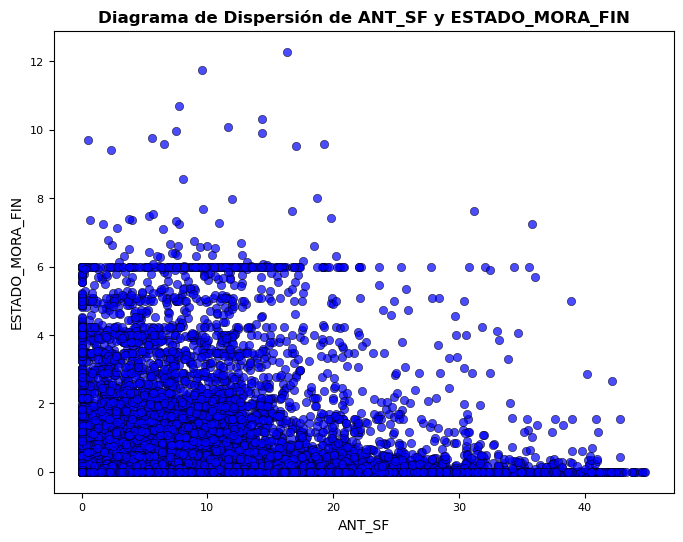

Correlación de Spearman: 0.08120687651153354, p-valor: 1.672186440425917e-59
Análisis bivariado númerico entre ANT_SF y ESTADO_MORA_REAL


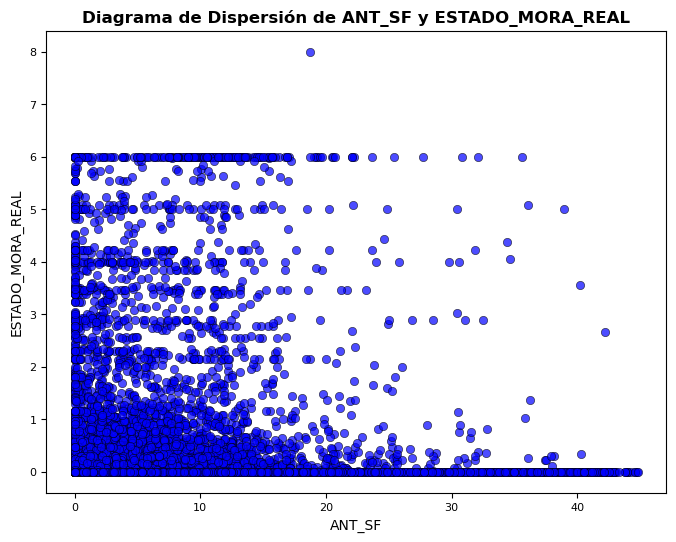

Correlación de Spearman: -0.06967514334421063, p-valor: 3.0784312036528813e-44
Análisis bivariado númerico entre SALDO_SF y CLIENTE_MORA


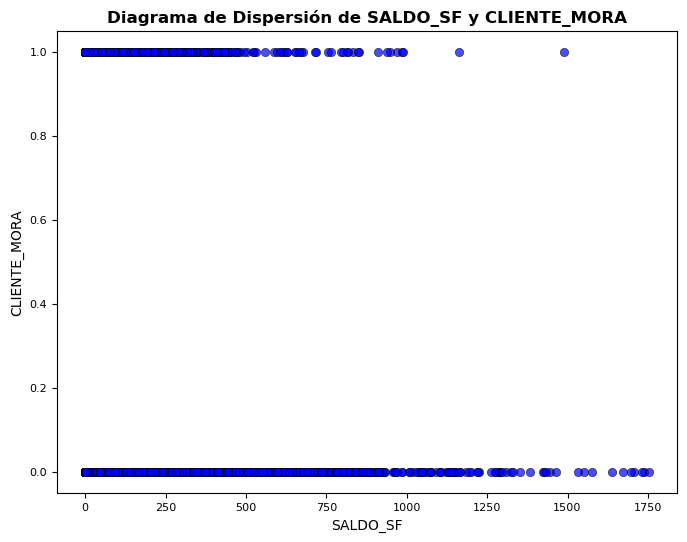

Correlación de Spearman: 0.0019452851526807714, p-valor: 0.6972426804054298
Análisis bivariado númerico entre SALDO_SF y EDAD


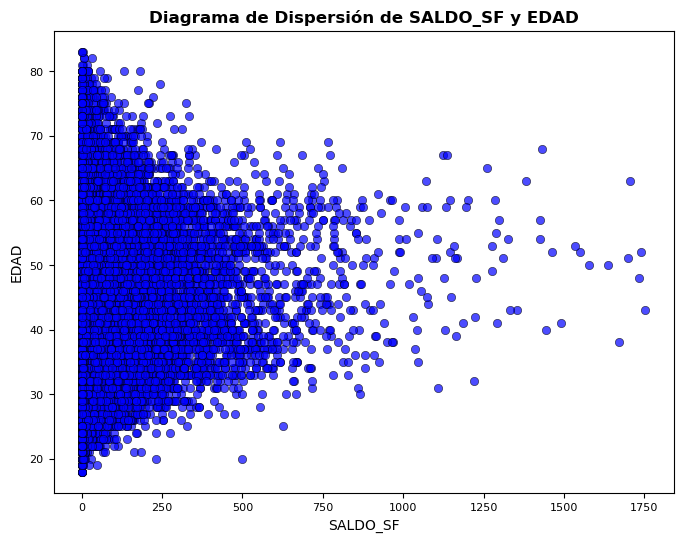

Correlación de Spearman: 0.08925410625639897, p-valor: 1.5169615814944096e-71
Análisis bivariado númerico entre SALDO_SF y INGRESO


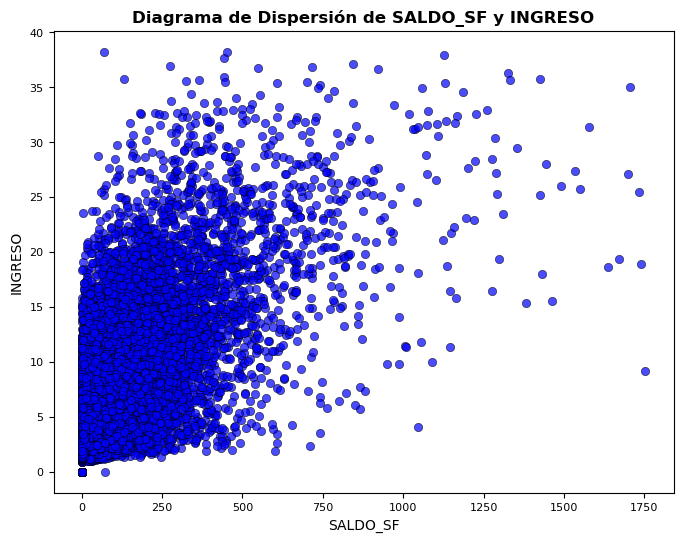

Correlación de Spearman: 0.6898870154464051, p-valor: 0.0
Análisis bivariado númerico entre SALDO_SF y SCORE_DATACREDITO


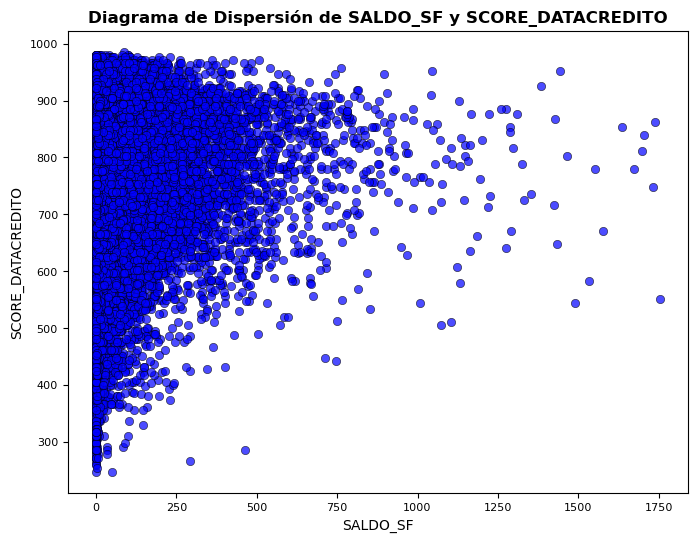

Correlación de Spearman: 0.0687554755877066, p-valor: 4.028202261327409e-43
Análisis bivariado númerico entre SALDO_SF y ANT_SF


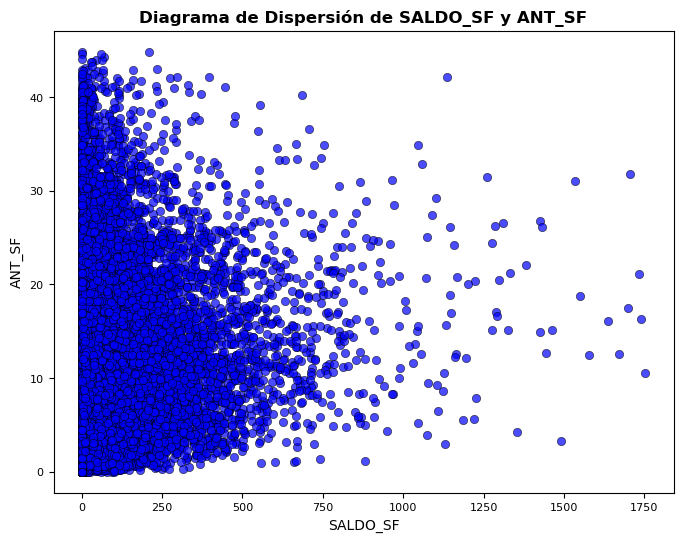

Correlación de Spearman: 0.43931457649518574, p-valor: 0.0
Análisis bivariado númerico entre SALDO_SF y ULTIMAPERTURA


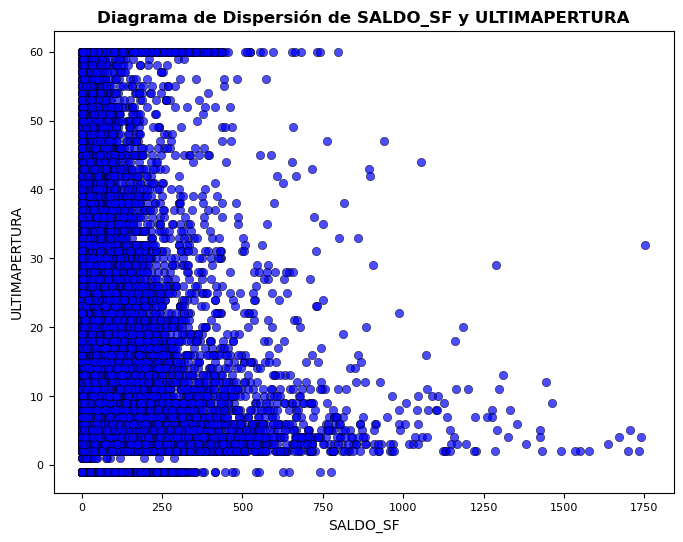

Correlación de Spearman: 0.0763329432763727, p-valor: 9.133945392098624e-53
Análisis bivariado númerico entre SALDO_SF y SALDO_FIJO


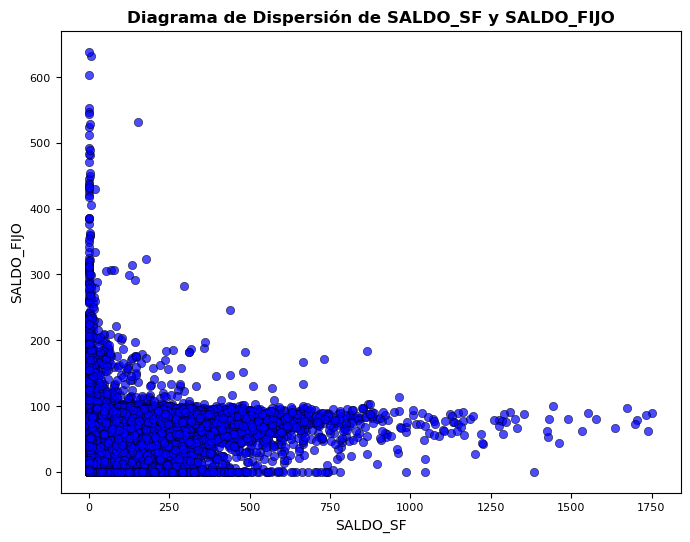

Correlación de Spearman: 0.4171330246908946, p-valor: 0.0
Análisis bivariado númerico entre SALDO_SF y SALDO_ROT


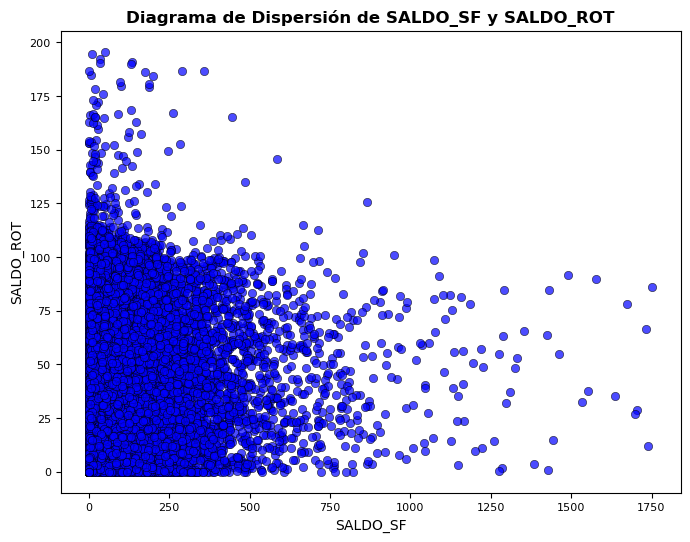

Correlación de Spearman: 0.4119537873032981, p-valor: 0.0
Análisis bivariado númerico entre SALDO_SF y ESTADO_MORA_FIN


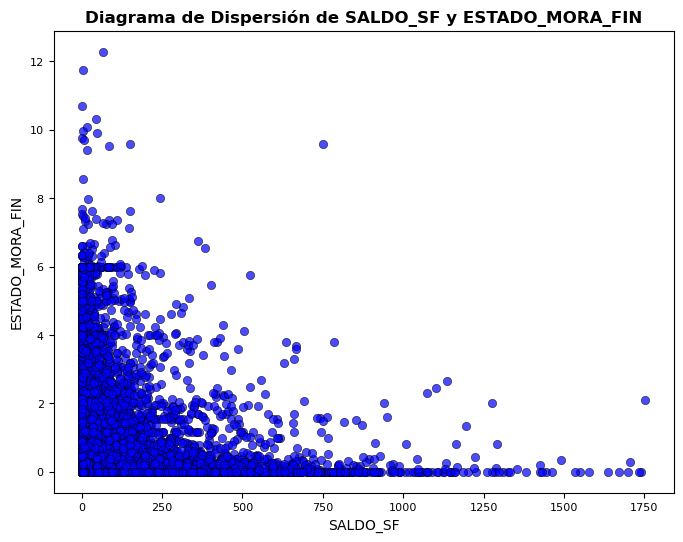

Correlación de Spearman: 0.10397431720186653, p-valor: 1.500678334106588e-96
Análisis bivariado númerico entre SALDO_SF y ESTADO_MORA_REAL


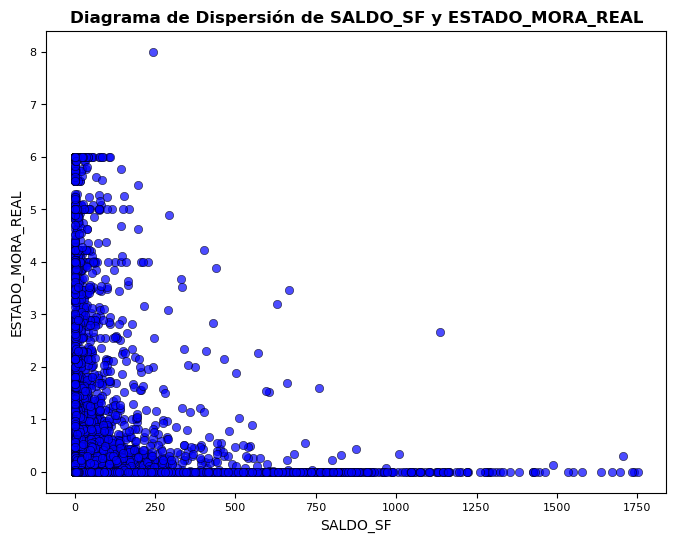

Correlación de Spearman: -0.07458083937487983, p-valor: 1.9071640824711573e-50
Análisis bivariado númerico entre ULTIMAPERTURA y CLIENTE_MORA


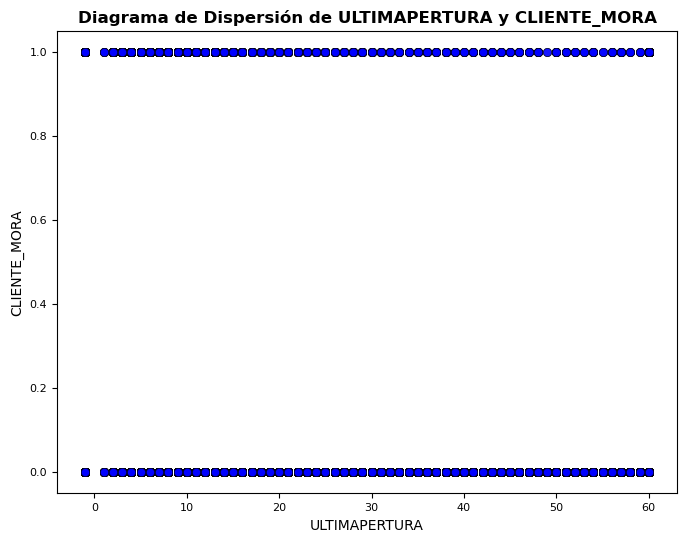

Correlación de Spearman: -0.0377059679071323, p-valor: 4.570306156415091e-14
Análisis bivariado númerico entre ULTIMAPERTURA y EDAD


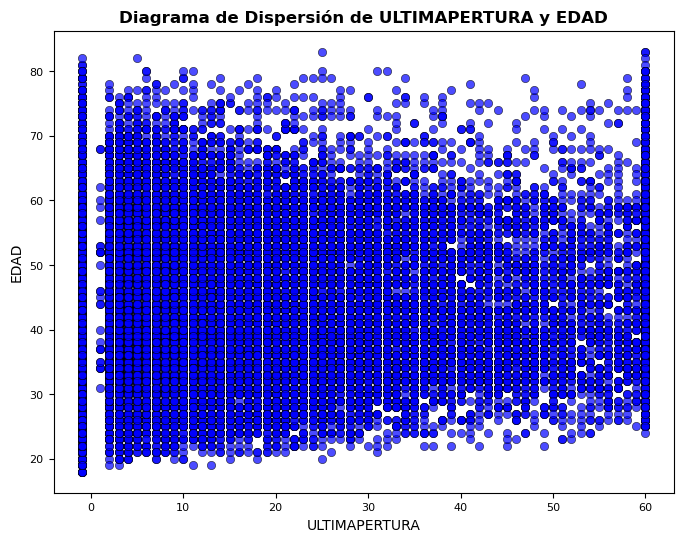

Correlación de Spearman: 0.08254141394730952, p-valor: 2.020367986223448e-61
Análisis bivariado númerico entre ULTIMAPERTURA y INGRESO


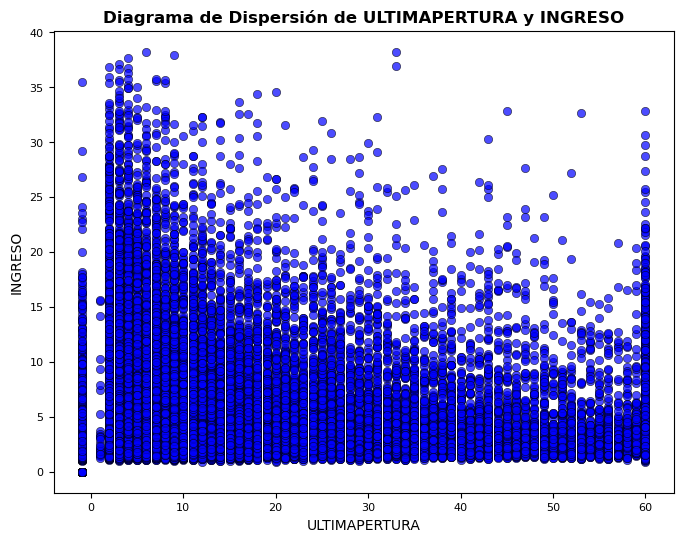

Correlación de Spearman: 0.12154079686632402, p-valor: 1.800525336730545e-131
Análisis bivariado númerico entre ULTIMAPERTURA y SCORE_DATACREDITO


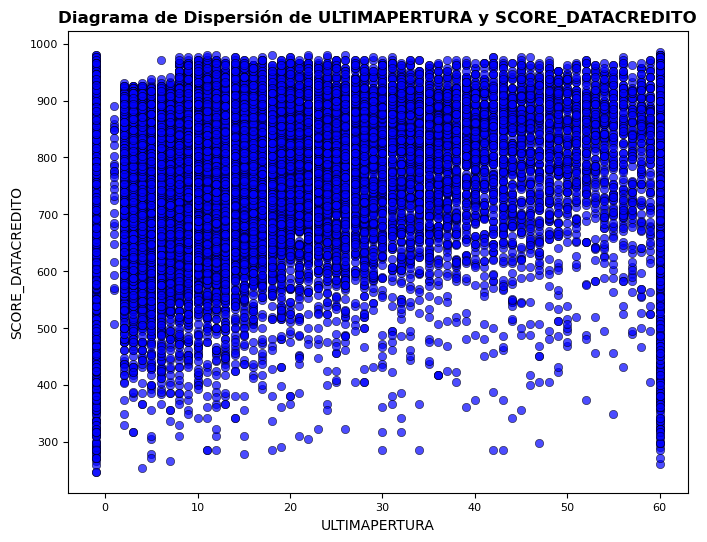

Correlación de Spearman: 0.23651450072483818, p-valor: 0.0
Análisis bivariado númerico entre ULTIMAPERTURA y ANT_SF


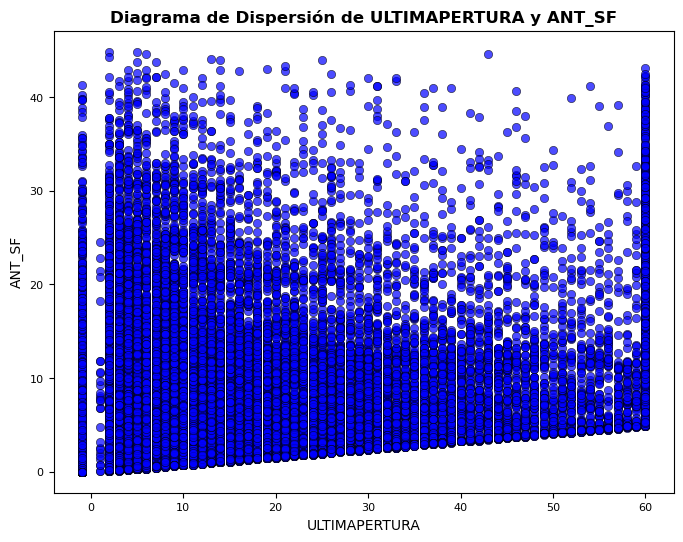

Correlación de Spearman: 0.36690801831801456, p-valor: 0.0
Análisis bivariado númerico entre ULTIMAPERTURA y SALDO_SF


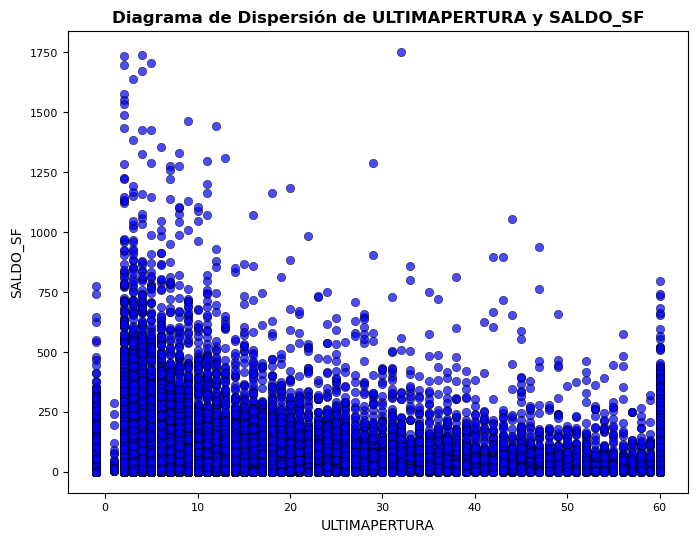

Correlación de Spearman: 0.0763329432763727, p-valor: 9.133945392098624e-53
Análisis bivariado númerico entre ULTIMAPERTURA y SALDO_FIJO


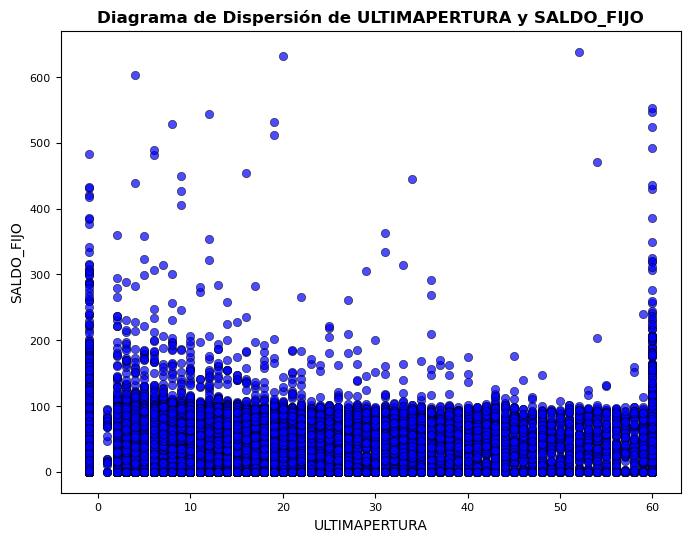

Correlación de Spearman: -0.05338398338206126, p-valor: 1.2083941077969572e-26
Análisis bivariado númerico entre ULTIMAPERTURA y SALDO_ROT


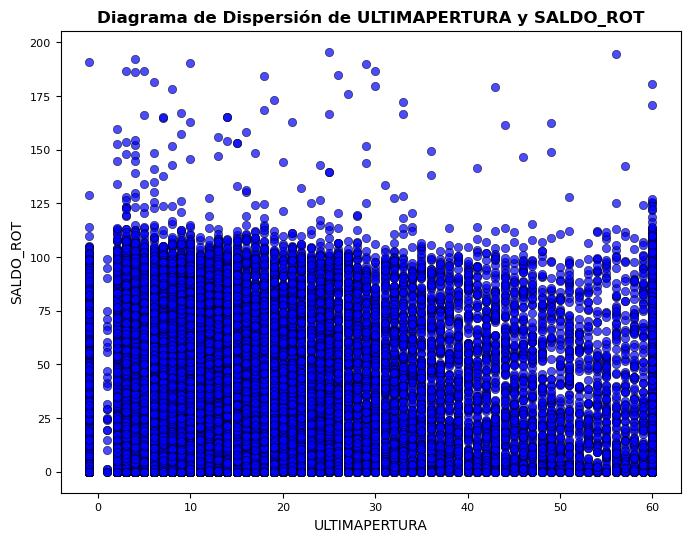

Correlación de Spearman: 0.1730028631931769, p-valor: 2.736992757379446e-266
Análisis bivariado númerico entre ULTIMAPERTURA y ESTADO_MORA_FIN


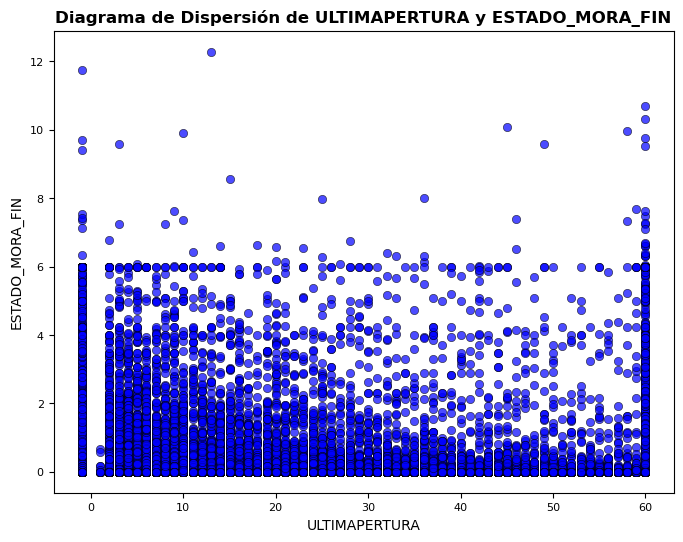

Correlación de Spearman: 0.03043491840457662, p-valor: 1.1418453914665036e-09
Análisis bivariado númerico entre ULTIMAPERTURA y ESTADO_MORA_REAL


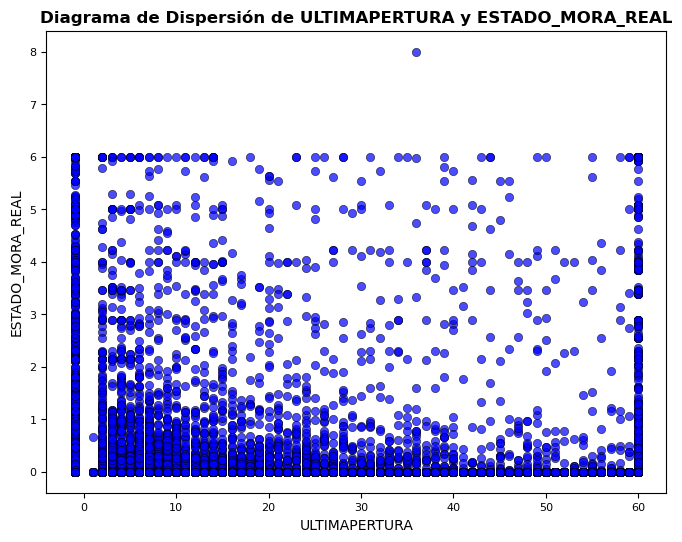

Correlación de Spearman: -0.03360109472662597, p-valor: 1.7936157416604316e-11
Análisis bivariado númerico entre SALDO_FIJO y CLIENTE_MORA


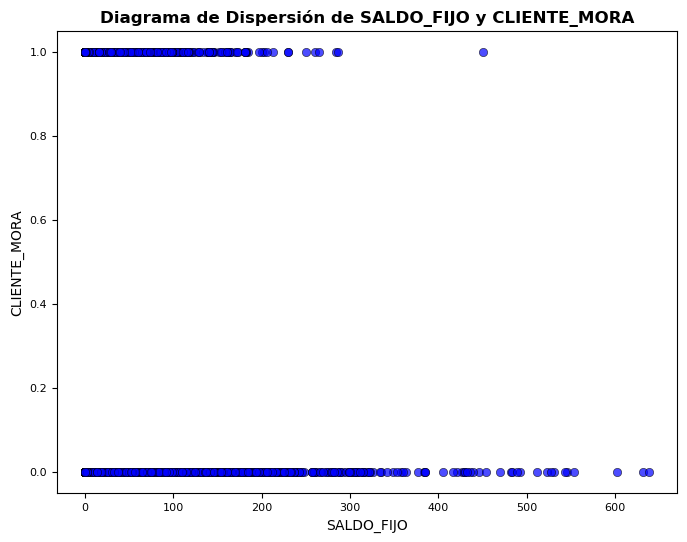

Correlación de Spearman: 0.06176431168078844, p-valor: 4.0784232159845106e-35
Análisis bivariado númerico entre SALDO_FIJO y EDAD


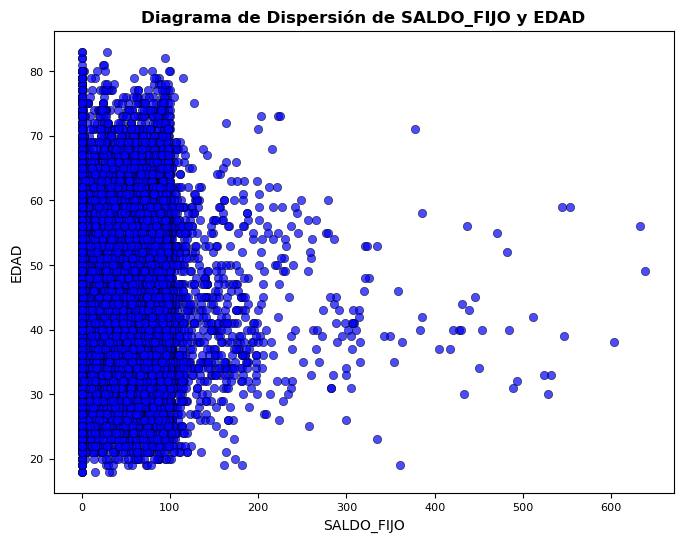

Correlación de Spearman: 0.006038104543842829, p-valor: 0.22720340011478882
Análisis bivariado númerico entre SALDO_FIJO y INGRESO


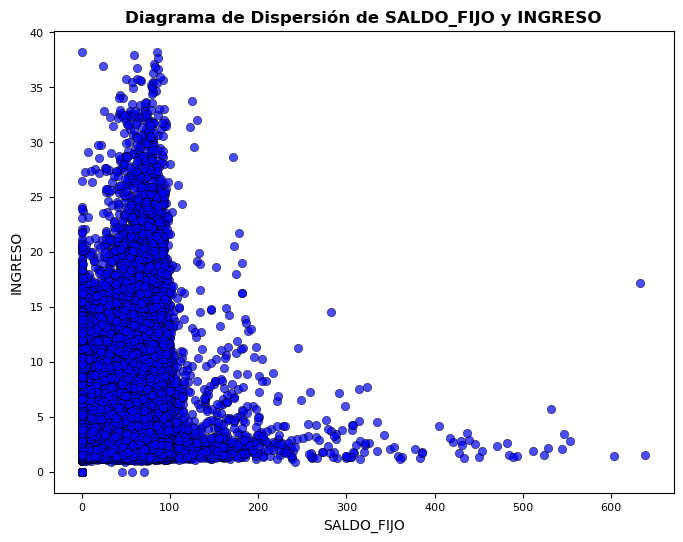

Correlación de Spearman: 0.22009716588474032, p-valor: 0.0
Análisis bivariado númerico entre SALDO_FIJO y SCORE_DATACREDITO


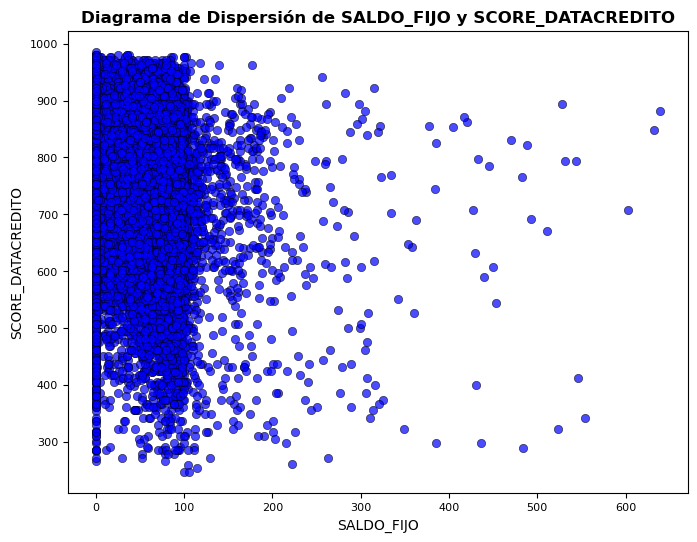

Correlación de Spearman: -0.2052271226905095, p-valor: 0.0
Análisis bivariado númerico entre SALDO_FIJO y ANT_SF


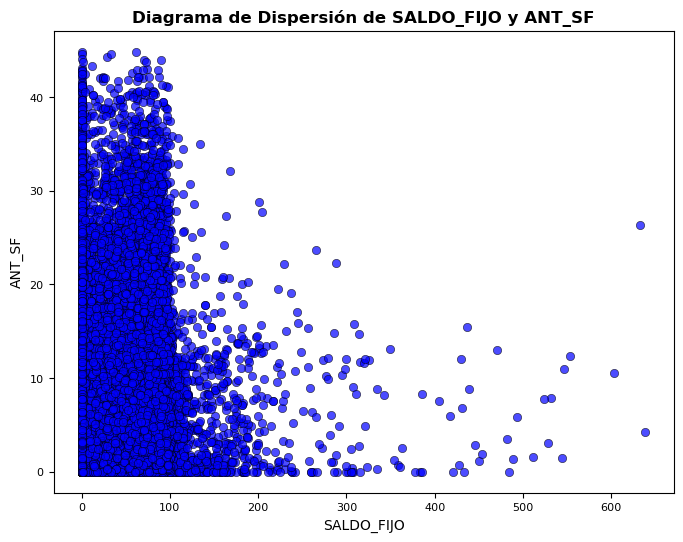

Correlación de Spearman: 0.08122623959907452, p-valor: 1.5692169409793365e-59
Análisis bivariado númerico entre SALDO_FIJO y SALDO_SF


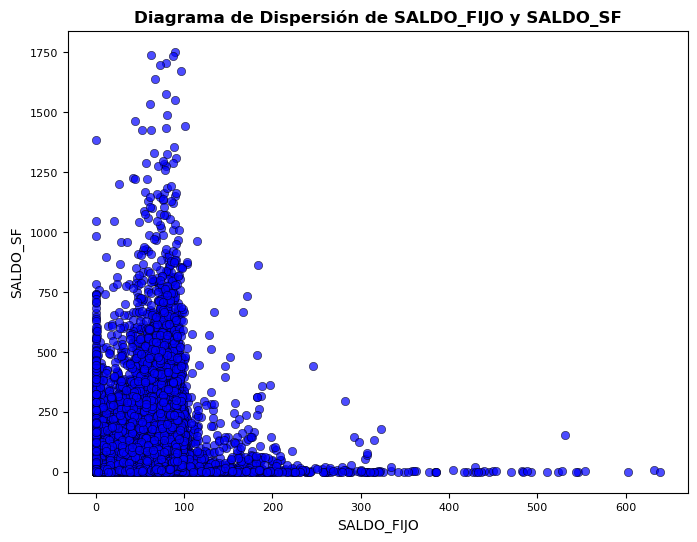

Correlación de Spearman: 0.4171330246908946, p-valor: 0.0
Análisis bivariado númerico entre SALDO_FIJO y ULTIMAPERTURA


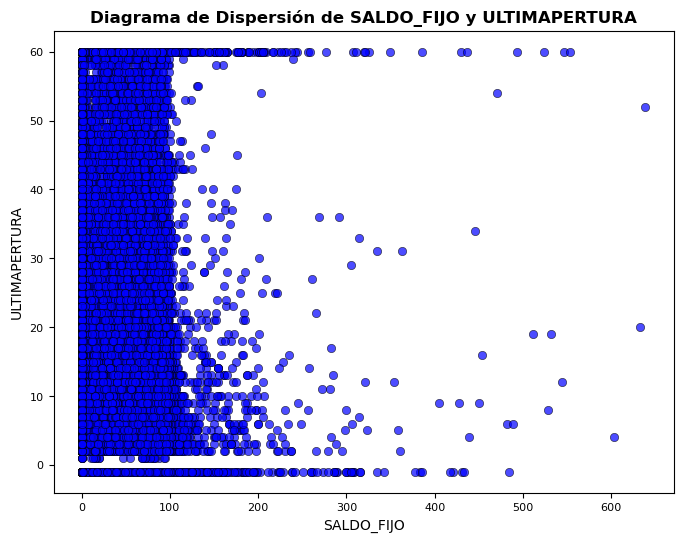

Correlación de Spearman: -0.05338398338206126, p-valor: 1.2083941077969572e-26
Análisis bivariado númerico entre SALDO_FIJO y SALDO_ROT


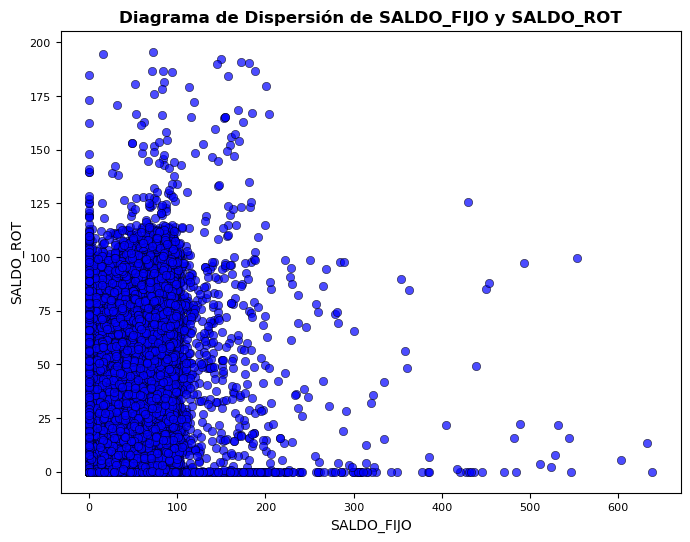

Correlación de Spearman: 0.2444785703898407, p-valor: 0.0
Análisis bivariado númerico entre SALDO_FIJO y ESTADO_MORA_FIN


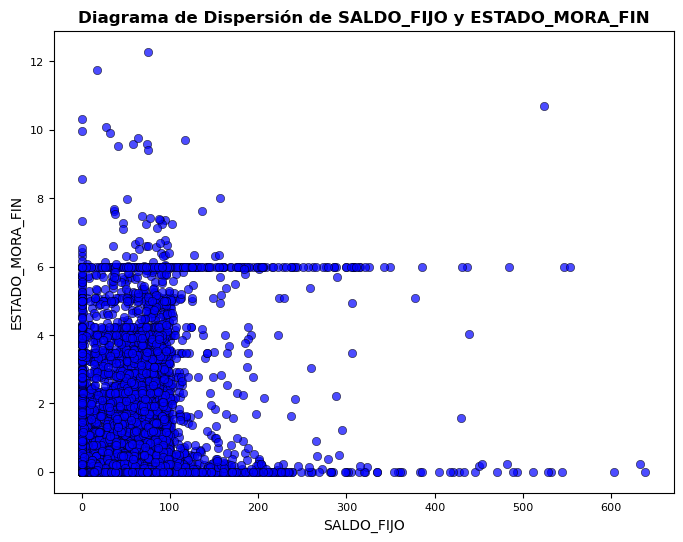

Correlación de Spearman: 0.13925997598795947, p-valor: 2.3004467703860958e-172
Análisis bivariado númerico entre SALDO_FIJO y ESTADO_MORA_REAL


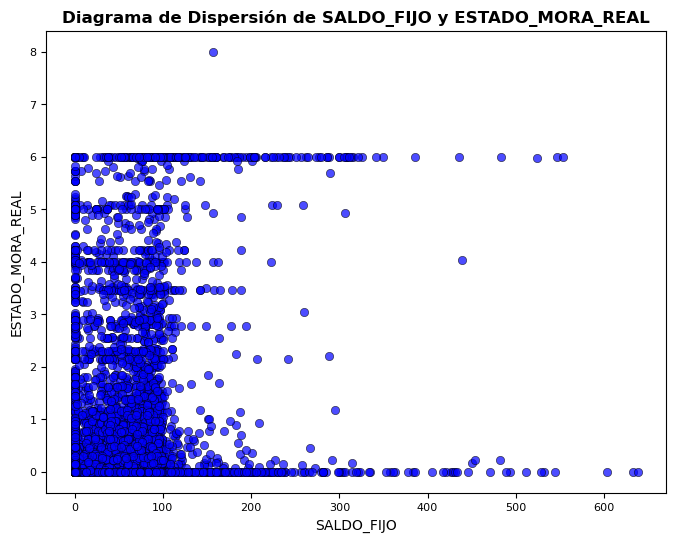

Correlación de Spearman: 0.08124521330362804, p-valor: 1.4744495452514142e-59
Análisis bivariado númerico entre SALDO_ROT y CLIENTE_MORA


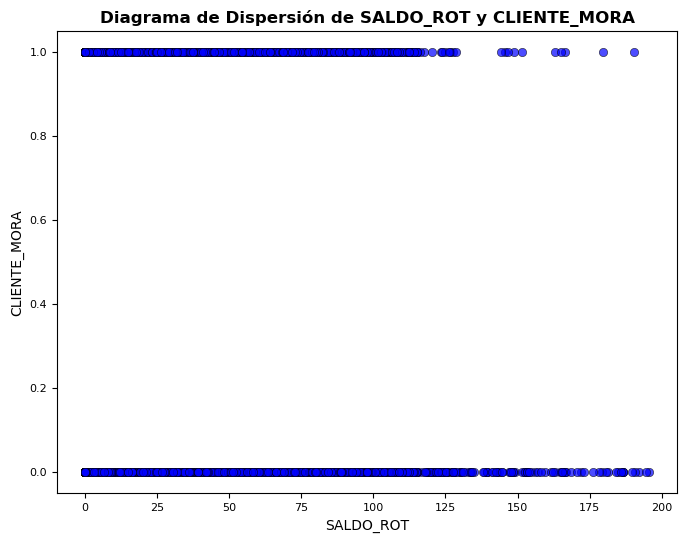

Correlación de Spearman: 0.08530064241593056, p-valor: 1.739208140983358e-65
Análisis bivariado númerico entre SALDO_ROT y EDAD


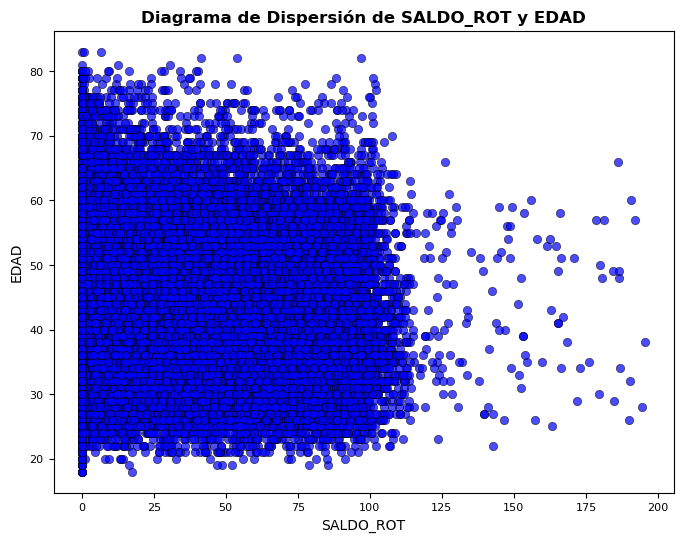

Correlación de Spearman: -0.0436299222173789, p-valor: 2.5496878571013226e-18
Análisis bivariado númerico entre SALDO_ROT y INGRESO


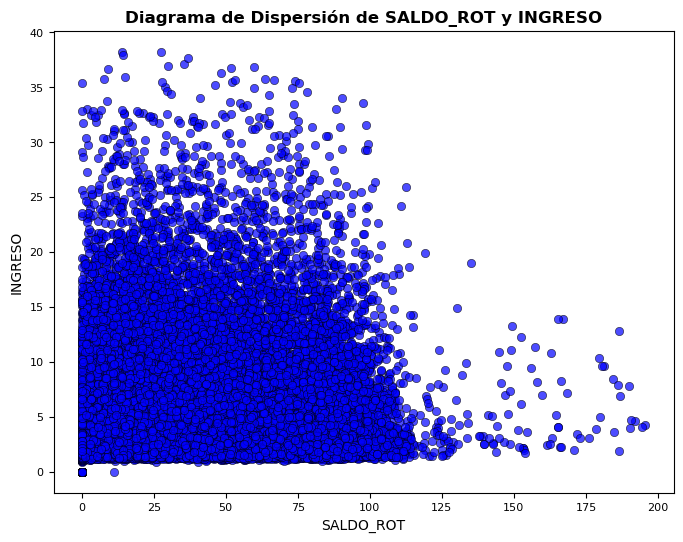

Correlación de Spearman: 0.3014301930640202, p-valor: 0.0
Análisis bivariado númerico entre SALDO_ROT y SCORE_DATACREDITO


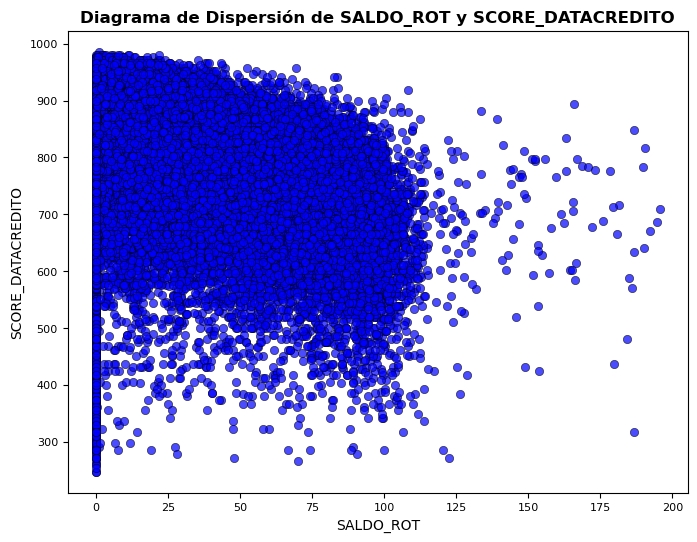

Correlación de Spearman: -0.2682053627334179, p-valor: 0.0
Análisis bivariado númerico entre SALDO_ROT y ANT_SF


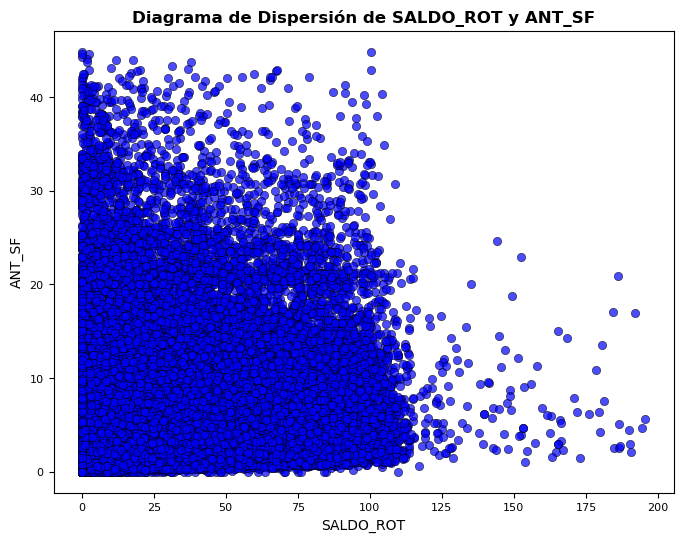

Correlación de Spearman: 0.2805778809218711, p-valor: 0.0
Análisis bivariado númerico entre SALDO_ROT y SALDO_SF


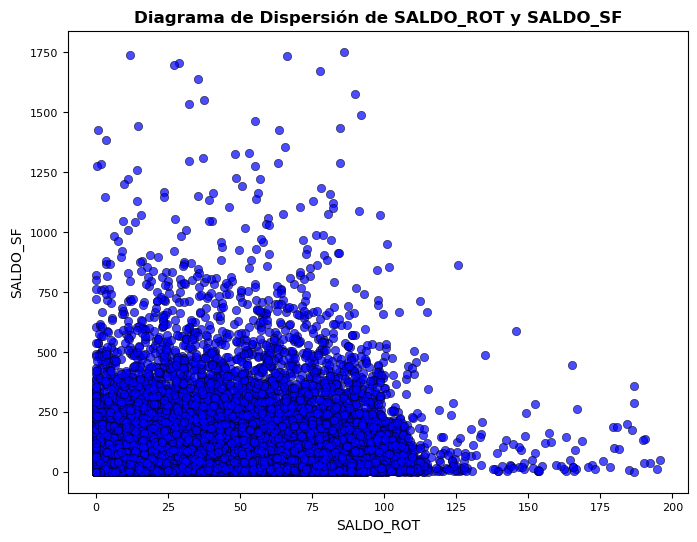

Correlación de Spearman: 0.41195378730329807, p-valor: 0.0
Análisis bivariado númerico entre SALDO_ROT y ULTIMAPERTURA


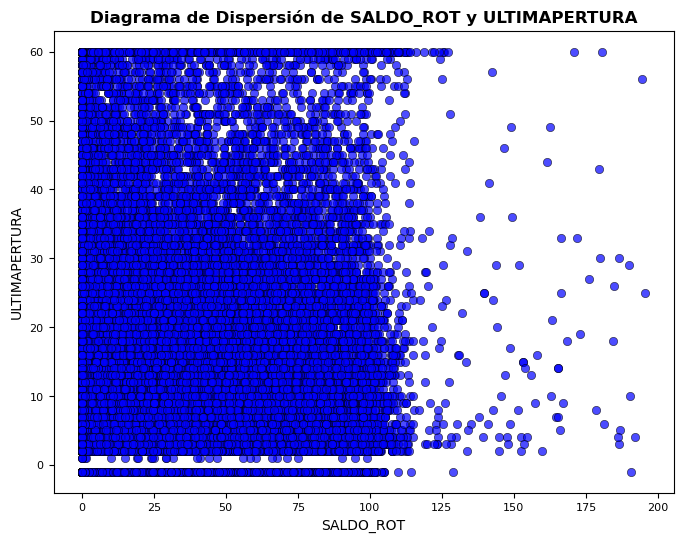

Correlación de Spearman: 0.1730028631931769, p-valor: 2.736992757379446e-266
Análisis bivariado númerico entre SALDO_ROT y SALDO_FIJO


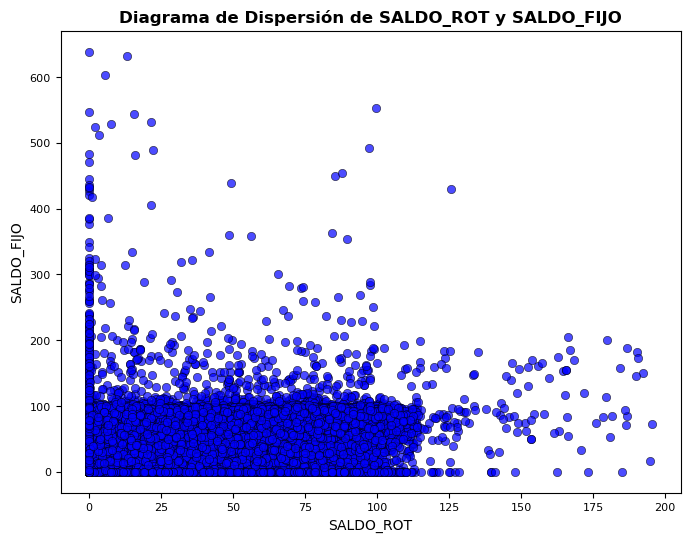

Correlación de Spearman: 0.24447857038984067, p-valor: 0.0
Análisis bivariado númerico entre SALDO_ROT y ESTADO_MORA_FIN


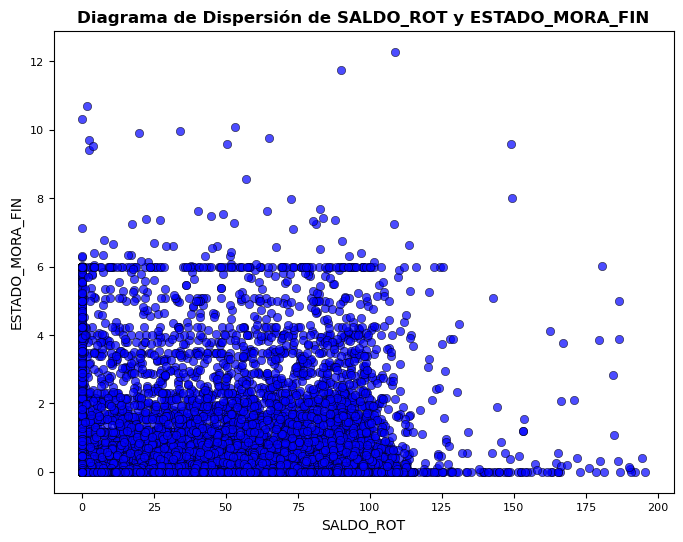

Correlación de Spearman: 0.17217852814219736, p-valor: 9.696748626842127e-264
Análisis bivariado númerico entre SALDO_ROT y ESTADO_MORA_REAL


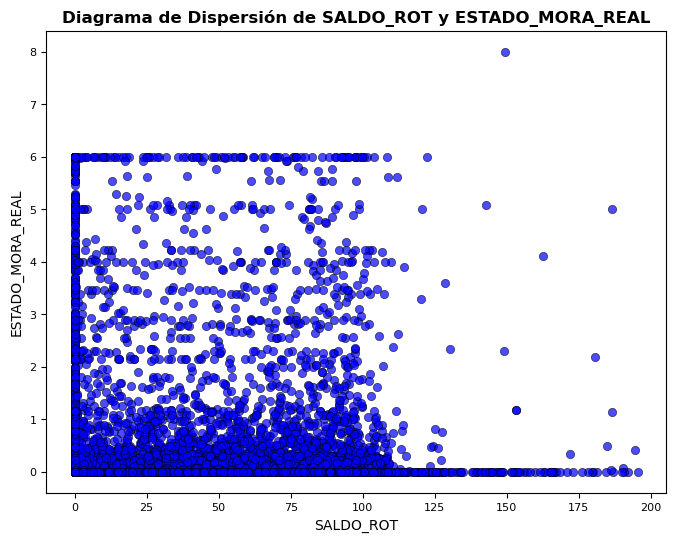

Correlación de Spearman: 0.004643097289739494, p-valor: 0.35309878441058806
Análisis bivariado númerico entre ESTADO_MORA_FIN y CLIENTE_MORA


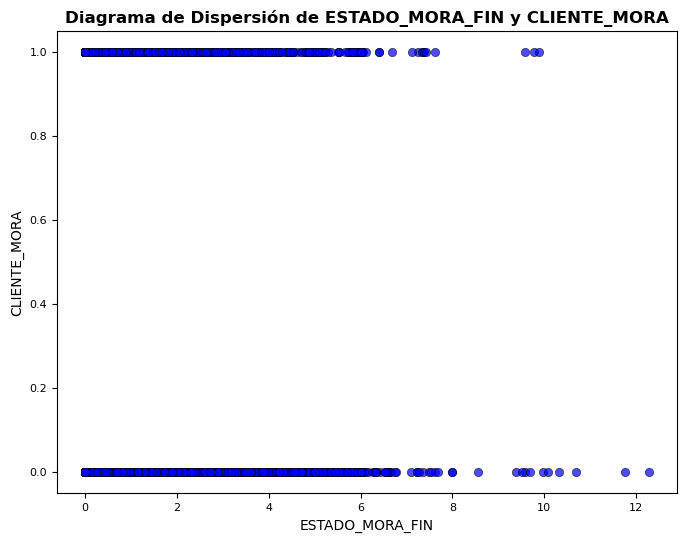

Correlación de Spearman: 0.14921941817029322, p-valor: 7.028929137659719e-198
Análisis bivariado númerico entre ESTADO_MORA_FIN y EDAD


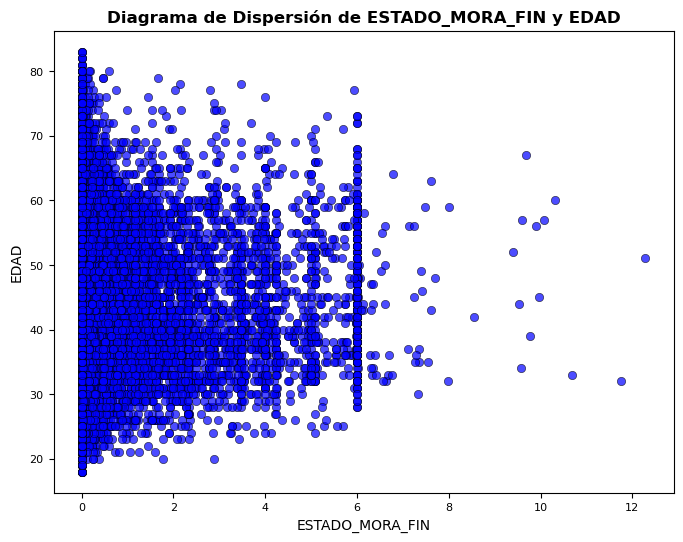

Correlación de Spearman: -0.003791294740521284, p-valor: 0.44830853002665494
Análisis bivariado númerico entre ESTADO_MORA_FIN y INGRESO


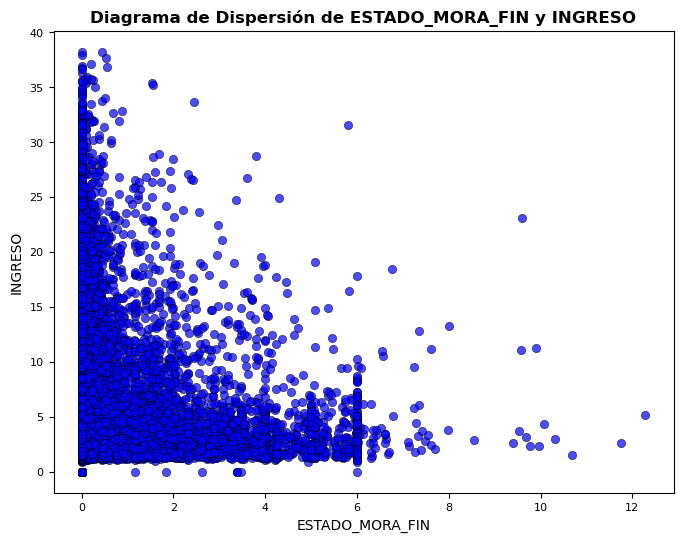

Correlación de Spearman: 0.07781356356771923, p-valor: 9.083104017749773e-55
Análisis bivariado númerico entre ESTADO_MORA_FIN y SCORE_DATACREDITO


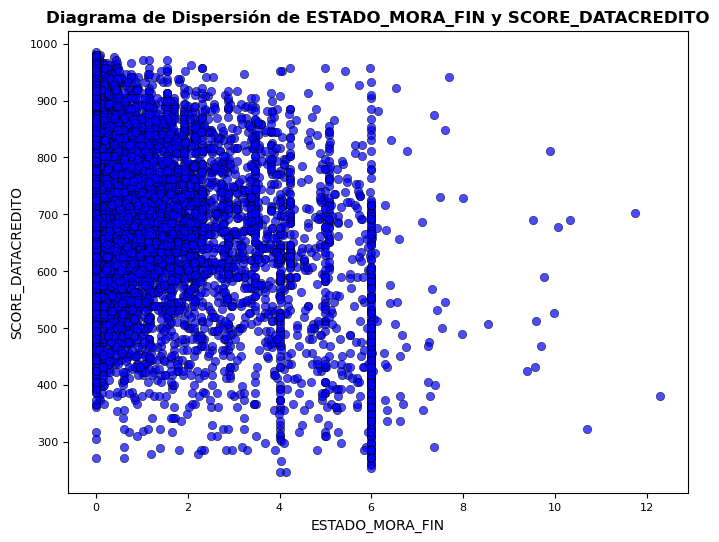

Correlación de Spearman: -0.29114975389822817, p-valor: 0.0
Análisis bivariado númerico entre ESTADO_MORA_FIN y ANT_SF


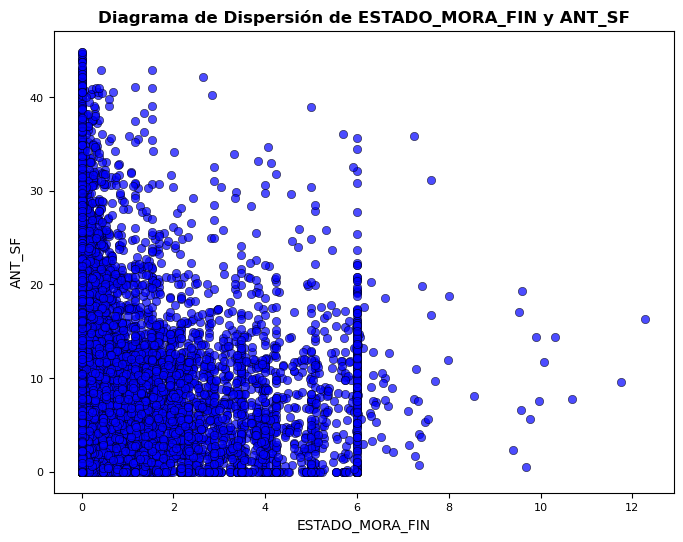

Correlación de Spearman: 0.08120687651153354, p-valor: 1.672186440425917e-59
Análisis bivariado númerico entre ESTADO_MORA_FIN y SALDO_SF


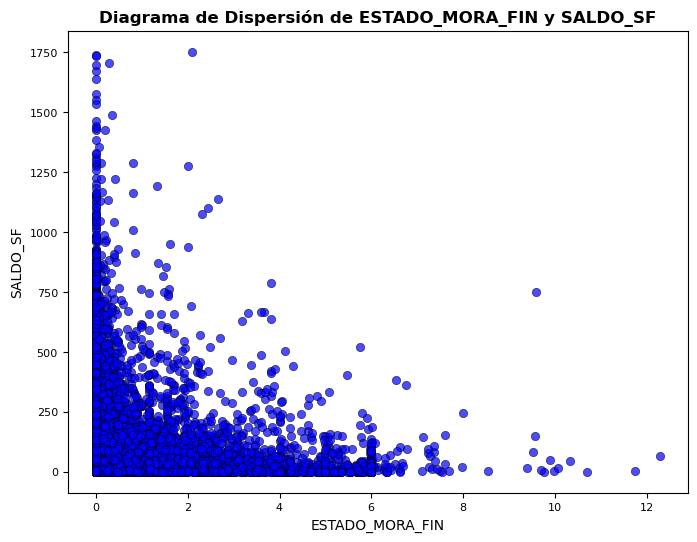

Correlación de Spearman: 0.10397431720186652, p-valor: 1.5006783341067164e-96
Análisis bivariado númerico entre ESTADO_MORA_FIN y ULTIMAPERTURA


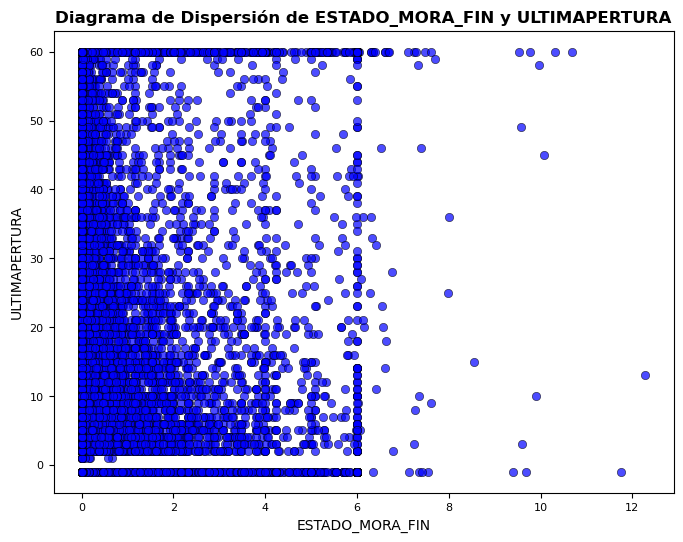

Correlación de Spearman: 0.03043491840457662, p-valor: 1.1418453914665036e-09
Análisis bivariado númerico entre ESTADO_MORA_FIN y SALDO_FIJO


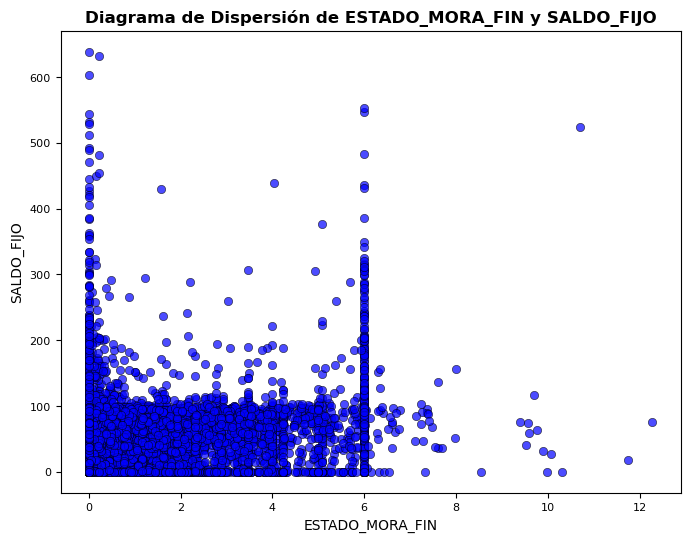

Correlación de Spearman: 0.13925997598795947, p-valor: 2.3004467703860958e-172
Análisis bivariado númerico entre ESTADO_MORA_FIN y SALDO_ROT


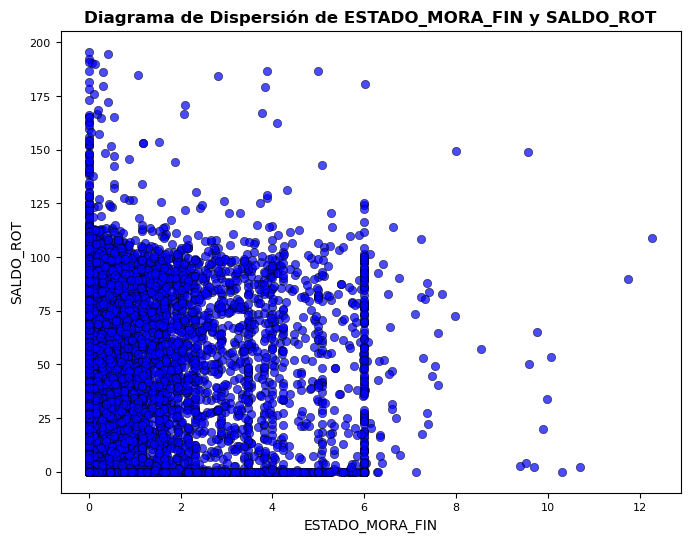

Correlación de Spearman: 0.17217852814219736, p-valor: 9.696748626842127e-264
Análisis bivariado númerico entre ESTADO_MORA_FIN y ESTADO_MORA_REAL


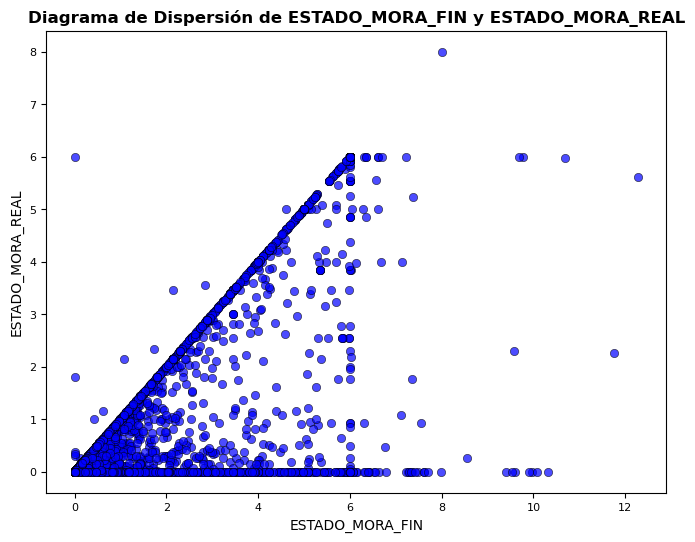

Correlación de Spearman: 0.5962296544247879, p-valor: 0.0
Análisis bivariado númerico entre ESTADO_MORA_REAL y CLIENTE_MORA


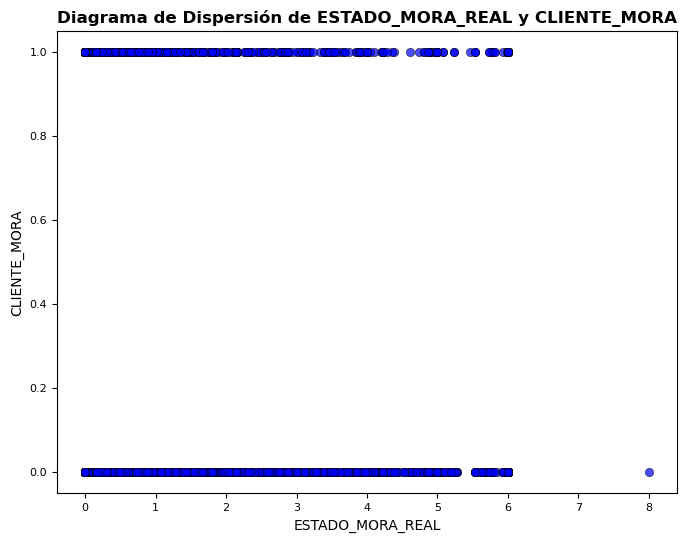

Correlación de Spearman: 0.08653032387363548, p-valor: 2.4283719194536808e-67
Análisis bivariado númerico entre ESTADO_MORA_REAL y EDAD


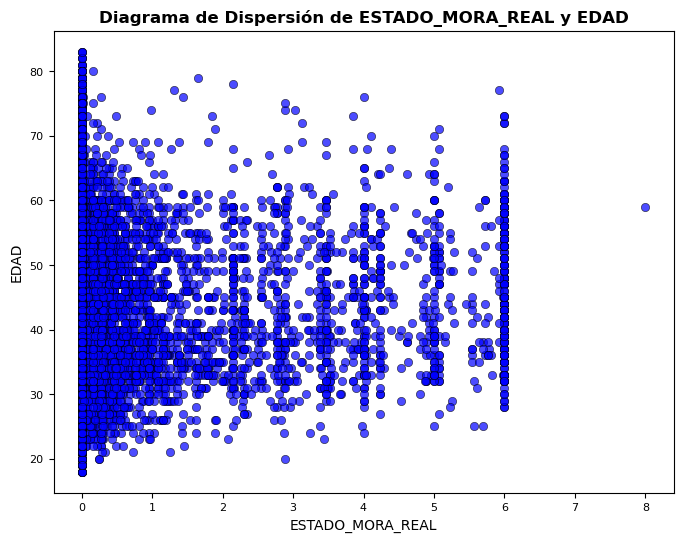

Correlación de Spearman: -0.028102325624633787, p-valor: 1.8941656573591953e-08
Análisis bivariado númerico entre ESTADO_MORA_REAL y INGRESO


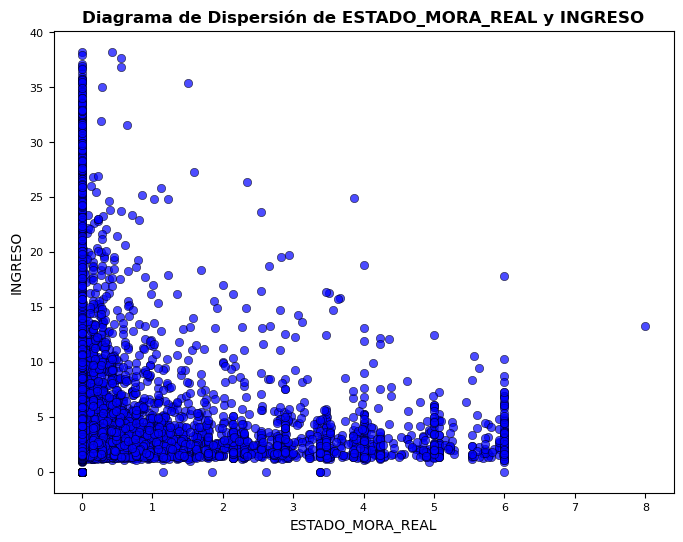

Correlación de Spearman: -0.07894641901054204, p-valor: 2.512197012364088e-56
Análisis bivariado númerico entre ESTADO_MORA_REAL y SCORE_DATACREDITO


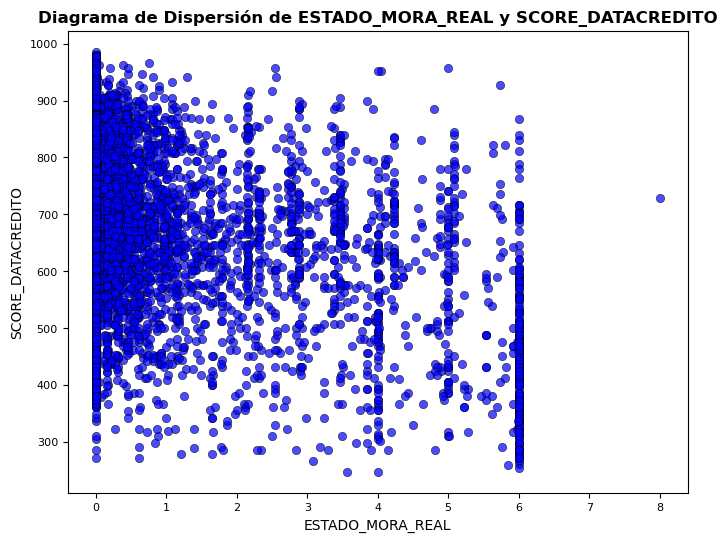

Correlación de Spearman: -0.28011081701708224, p-valor: 0.0
Análisis bivariado númerico entre ESTADO_MORA_REAL y ANT_SF


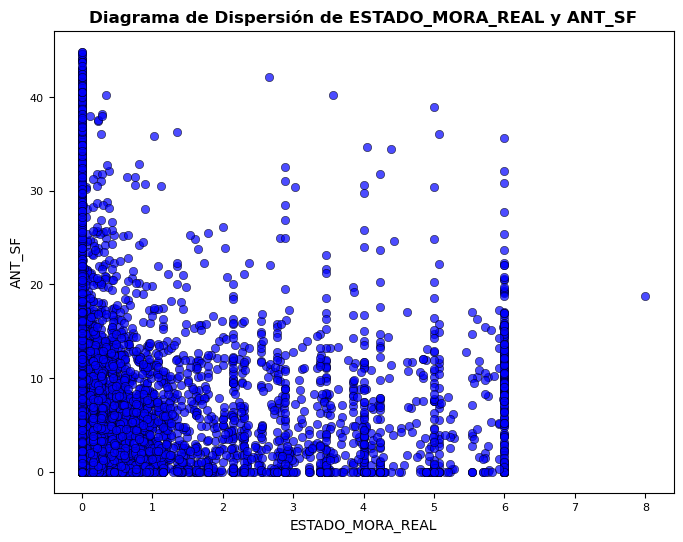

Correlación de Spearman: -0.06967514334421061, p-valor: 3.07843120365297e-44
Análisis bivariado númerico entre ESTADO_MORA_REAL y SALDO_SF


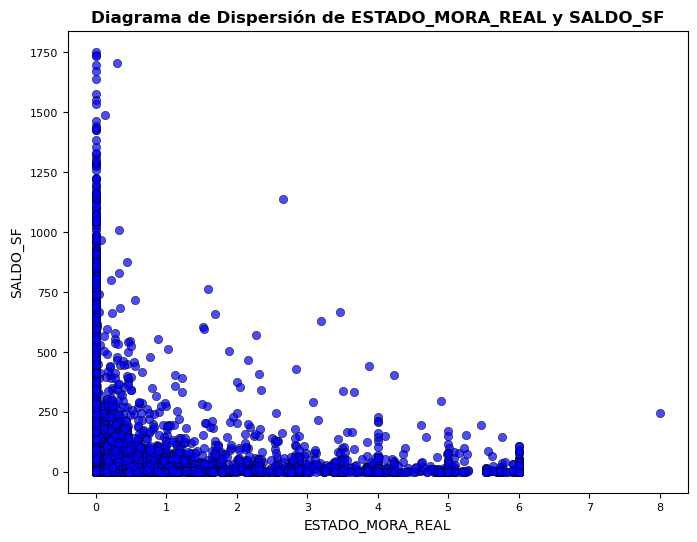

Correlación de Spearman: -0.07458083937487985, p-valor: 1.9071640824710762e-50
Análisis bivariado númerico entre ESTADO_MORA_REAL y ULTIMAPERTURA


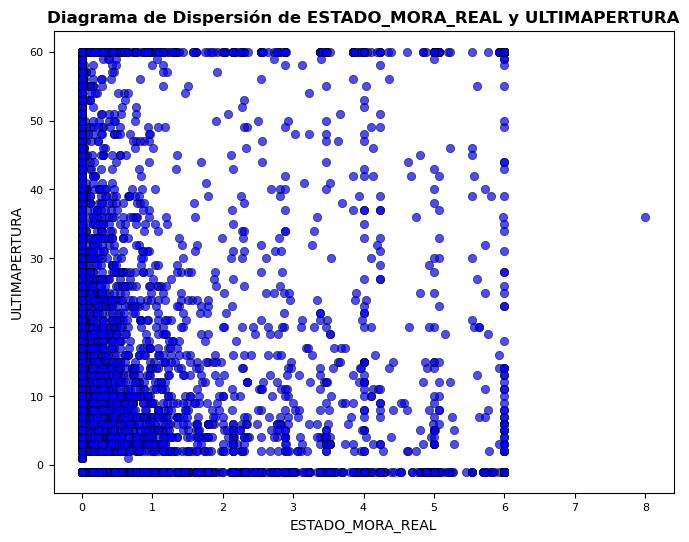

Correlación de Spearman: -0.03360109472662597, p-valor: 1.7936157416604316e-11
Análisis bivariado númerico entre ESTADO_MORA_REAL y SALDO_FIJO


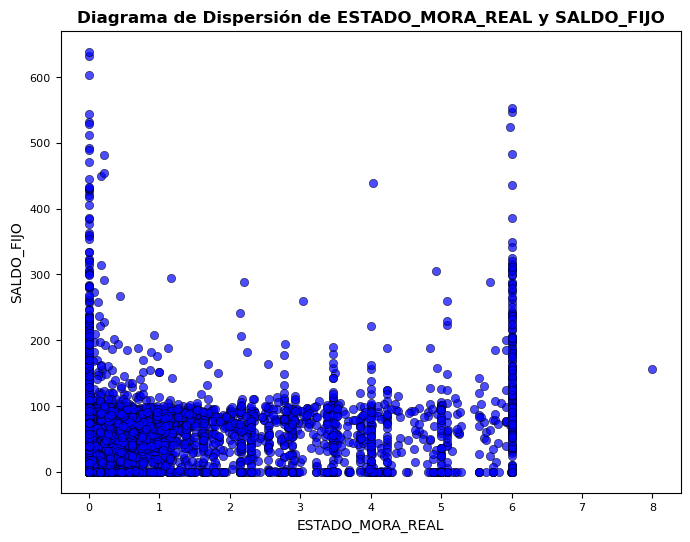

Correlación de Spearman: 0.08124521330362804, p-valor: 1.4744495452514142e-59
Análisis bivariado númerico entre ESTADO_MORA_REAL y SALDO_ROT


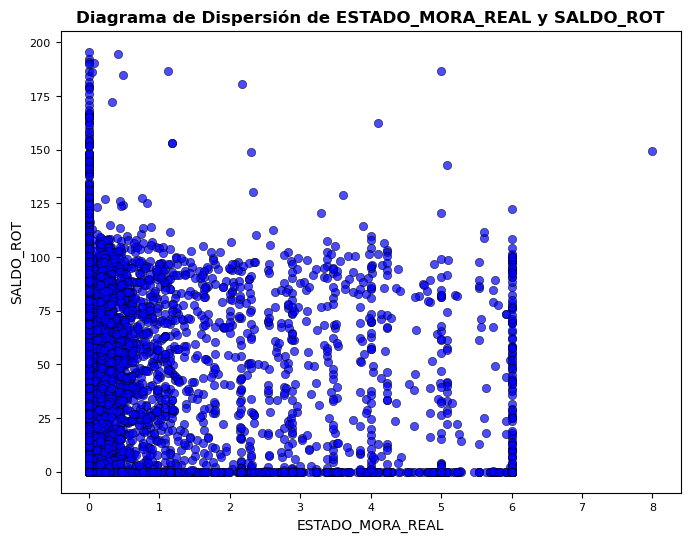

Correlación de Spearman: 0.004643097289739494, p-valor: 0.35309878441058806
Análisis bivariado númerico entre ESTADO_MORA_REAL y ESTADO_MORA_FIN


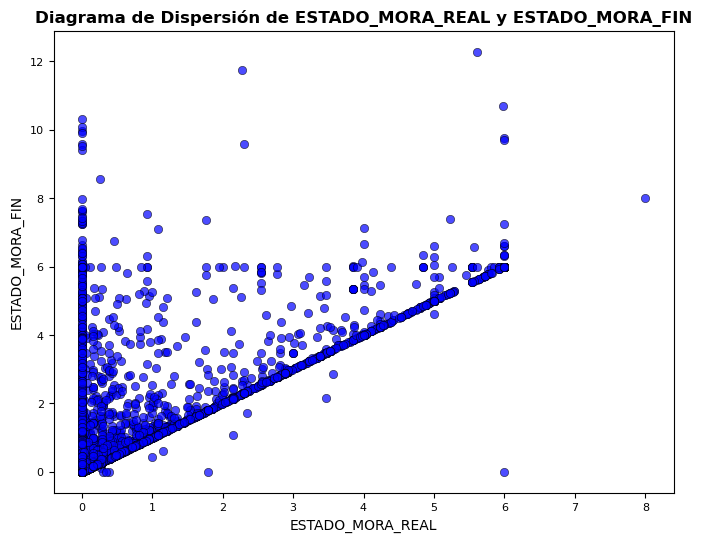

Correlación de Spearman: 0.5962296544247879, p-valor: 0.0


In [12]:
tumplas_nums = []
for col_num in num_cols:
    for col_num1 in num_cols:
        # tupla = (col_num, col_num1)
        # tumplas_nums.append(tupla)
        #if tumpla not in tumplas_nums:
            #tumplas_nums.append(tupla)
        if col_num != col_num1:
            print(f'Análisis bivariado númerico entre {col_num} y {col_num1}')
            ut.analisis_bivariado_numerico(df, col_num, col_num1)

#### **Categóricas vs Categóricas**

In [13]:
for col_cat1 in cat_cols:
    for col_cat in cat_cols:
        print(f'Análisis bivariado categórico entre {col_cat1} y {col_cat}')
        ut.analisis_bivariado_categorico(df, col_cat1, col_cat)

Análisis bivariado categórico entre SEXO y SEXO
Prueba Chi-cuadrado de las variables SEXO y SEXO
Chi-cuadrado: 39995.99841837736, p-valor: 0.0, Cramer´s V: 0.9999499789786658
Análisis bivariado categórico entre SEXO y CRED_REESTRUCTURADO
Análisis bivariado categórico entre SEXO y TIENE_HIPOTECA
Análisis bivariado categórico entre CRED_REESTRUCTURADO y SEXO
Análisis bivariado categórico entre CRED_REESTRUCTURADO y CRED_REESTRUCTURADO
Prueba Chi-cuadrado de las variables CRED_REESTRUCTURADO y CRED_REESTRUCTURADO
Chi-cuadrado: 39852.07135143061, p-valor: 0.0, Cramer´s V: 0.998149179123925
Análisis bivariado categórico entre CRED_REESTRUCTURADO y TIENE_HIPOTECA
Análisis bivariado categórico entre TIENE_HIPOTECA y SEXO
Análisis bivariado categórico entre TIENE_HIPOTECA y CRED_REESTRUCTURADO
Análisis bivariado categórico entre TIENE_HIPOTECA y TIENE_HIPOTECA
Prueba Chi-cuadrado de las variables TIENE_HIPOTECA y TIENE_HIPOTECA
Chi-cuadrado: 80000.0, p-valor: 0.0, Cramer´s V: 1.0


#### **Númericas vs Categoricas** 

Análisis bivariado mixto entre CLIENTE_MORA y SEXO


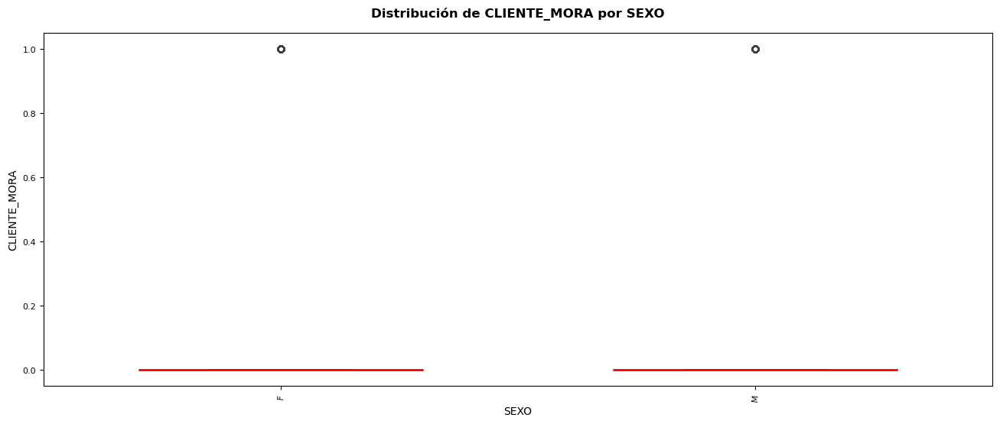

Prueba de Mann-Whitney U: U-valor = 198030675.0, p-valor = 0.00046016418836939354
Análisis bivariado mixto entre CLIENTE_MORA y CRED_REESTRUCTURADO


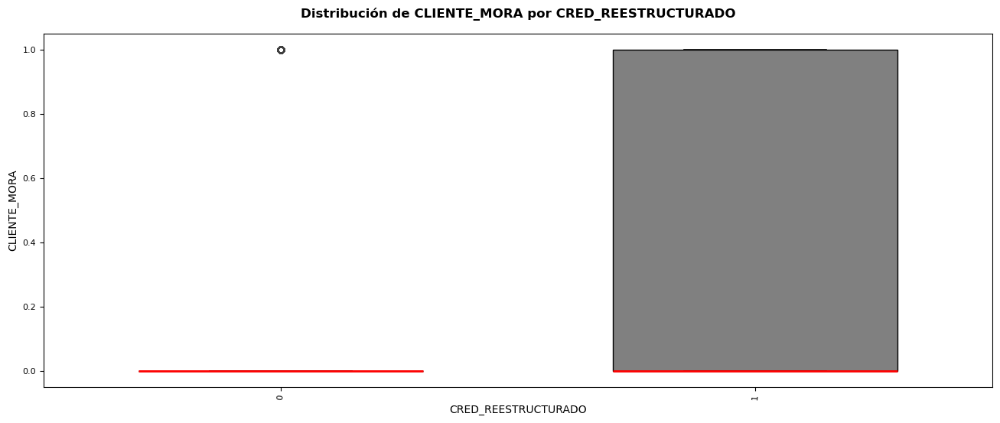

Prueba de Mann-Whitney U: U-valor = 3810728.0, p-valor = 2.0838497508377978e-72
Análisis bivariado mixto entre CLIENTE_MORA y TIENE_HIPOTECA


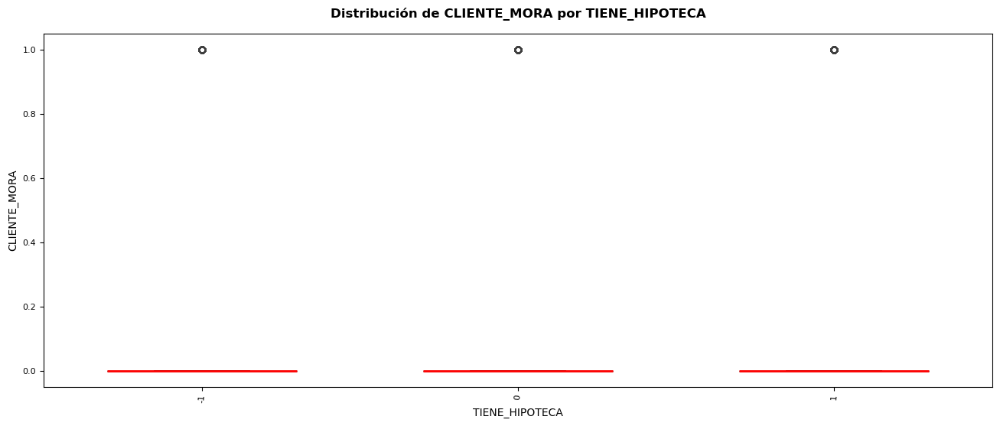

Prueba de Kruskal-Wallis: H-valor = 31.20951556380113, p-valor = 1.6708590060404132e-07
Análisis bivariado mixto entre EDAD y SEXO


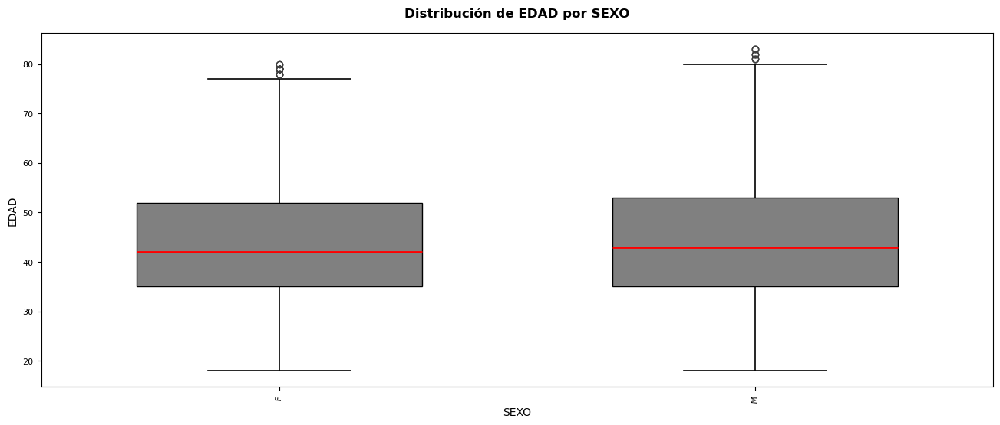

Prueba de Mann-Whitney U: U-valor = 192119705.5, p-valor = 1.421103945412225e-11
Análisis bivariado mixto entre EDAD y CRED_REESTRUCTURADO


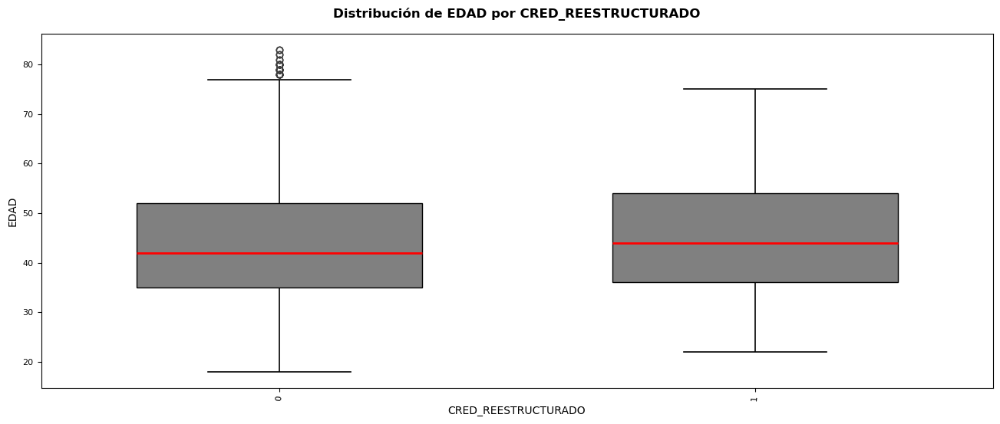

Prueba de Mann-Whitney U: U-valor = 5034162.5, p-valor = 0.05187337220804159
Análisis bivariado mixto entre EDAD y TIENE_HIPOTECA


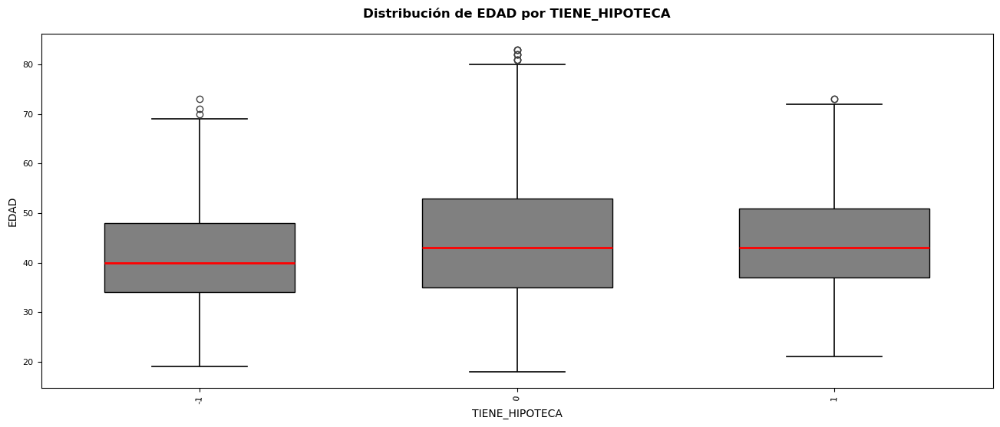

Prueba de Kruskal-Wallis: H-valor = 232.38084509366237, p-valor = 3.460514217719637e-51
Análisis bivariado mixto entre INGRESO y SEXO


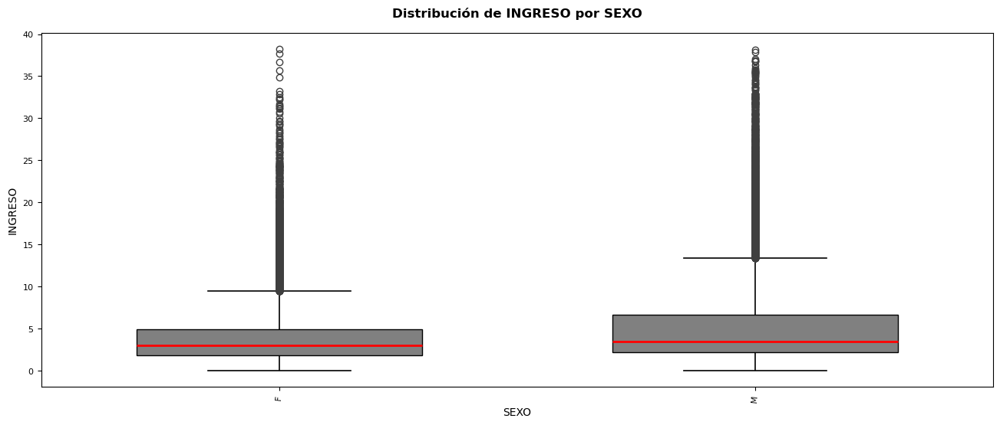

Prueba de Mann-Whitney U: U-valor = 170750530.0, p-valor = 8.145012487779125e-141
Análisis bivariado mixto entre INGRESO y CRED_REESTRUCTURADO


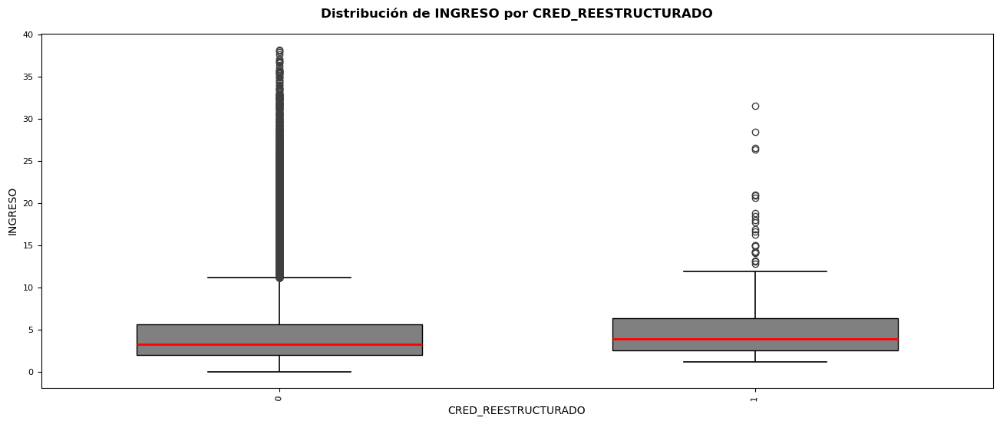

Prueba de Mann-Whitney U: U-valor = 4596313.5, p-valor = 2.1336867727769355e-05
Análisis bivariado mixto entre INGRESO y TIENE_HIPOTECA


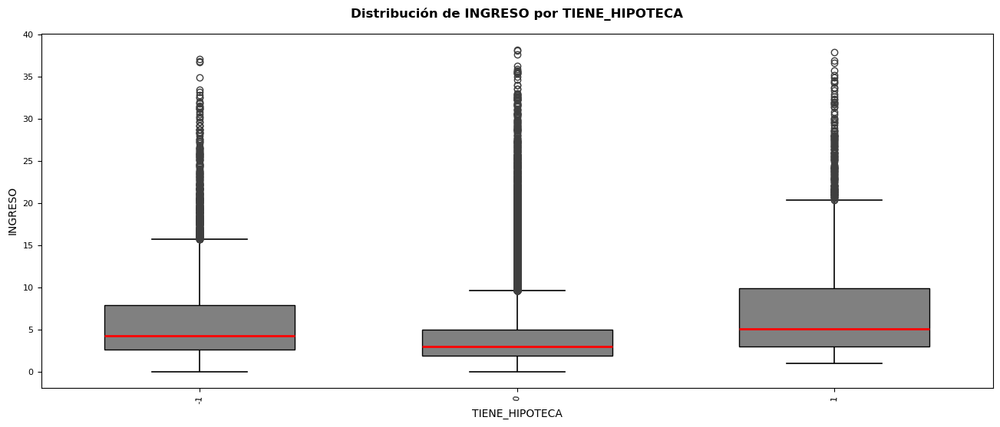

Prueba de Kruskal-Wallis: H-valor = 2030.6640817432053, p-valor = 0.0
Análisis bivariado mixto entre SCORE_DATACREDITO y SEXO


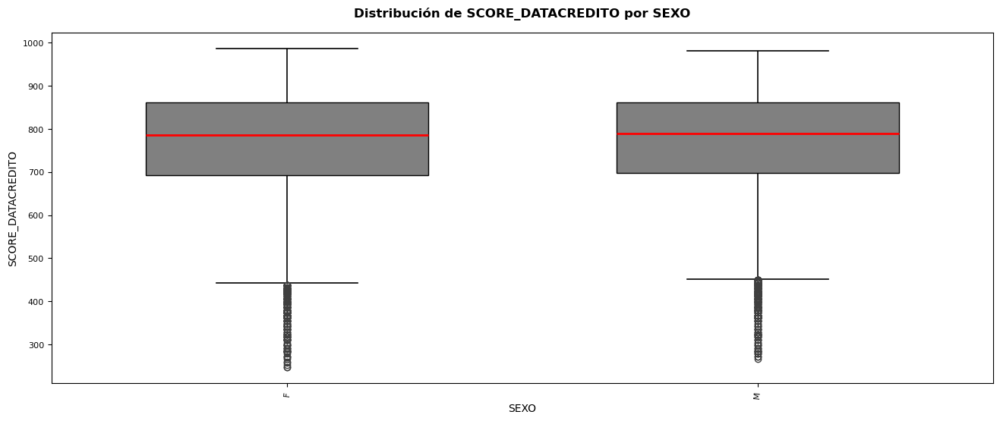

Prueba de Mann-Whitney U: U-valor = 197743016.0, p-valor = 0.059799055021175516
Análisis bivariado mixto entre SCORE_DATACREDITO y CRED_REESTRUCTURADO


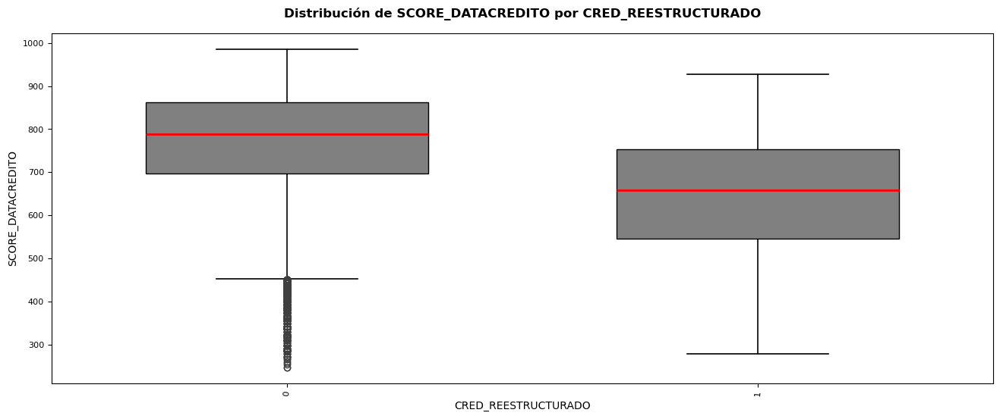

Prueba de Mann-Whitney U: U-valor = 8131577.0, p-valor = 7.1861757975028155e-47
Análisis bivariado mixto entre SCORE_DATACREDITO y TIENE_HIPOTECA


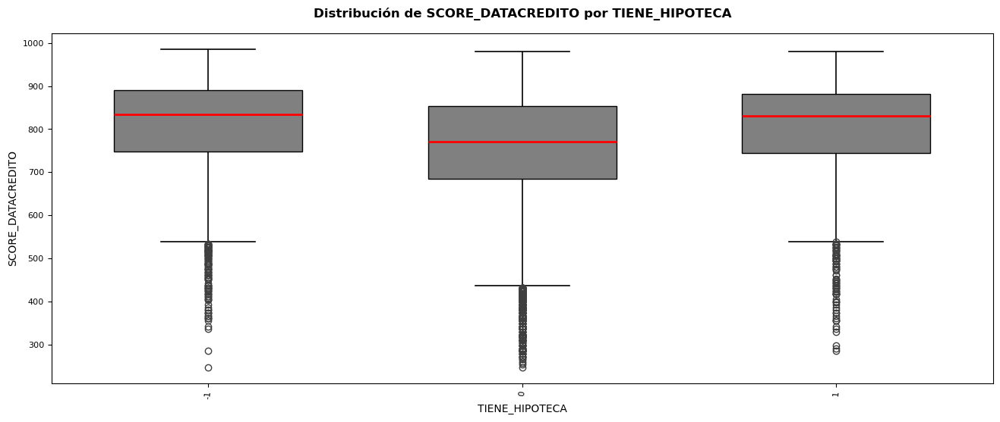

Prueba de Kruskal-Wallis: H-valor = 1289.8388788822945, p-valor = 8.223300837304483e-281
Análisis bivariado mixto entre ANT_SF y SEXO


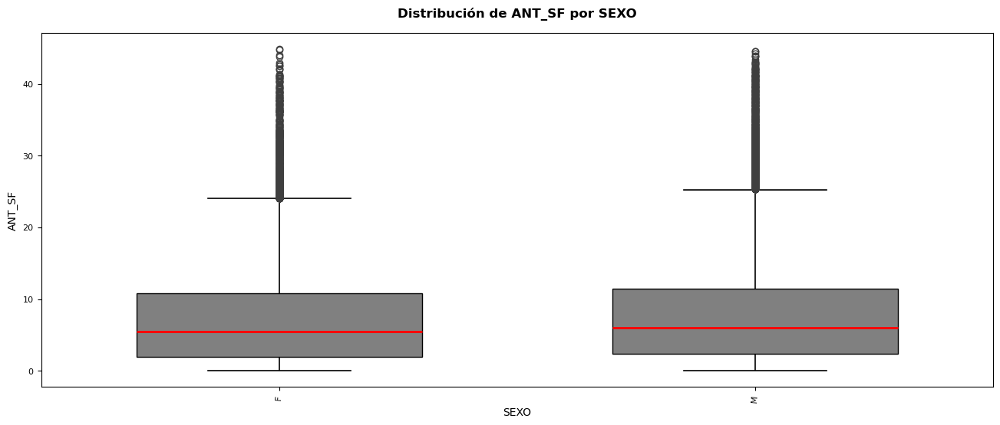

Prueba de Mann-Whitney U: U-valor = 188877111.5, p-valor = 1.1323524700128493e-21
Análisis bivariado mixto entre ANT_SF y CRED_REESTRUCTURADO


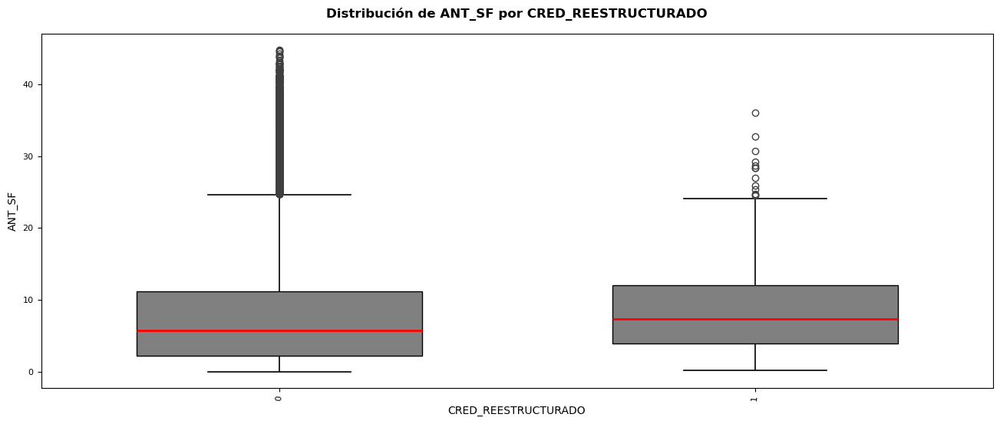

Prueba de Mann-Whitney U: U-valor = 4580931.0, p-valor = 1.4743826062631517e-05
Análisis bivariado mixto entre ANT_SF y TIENE_HIPOTECA


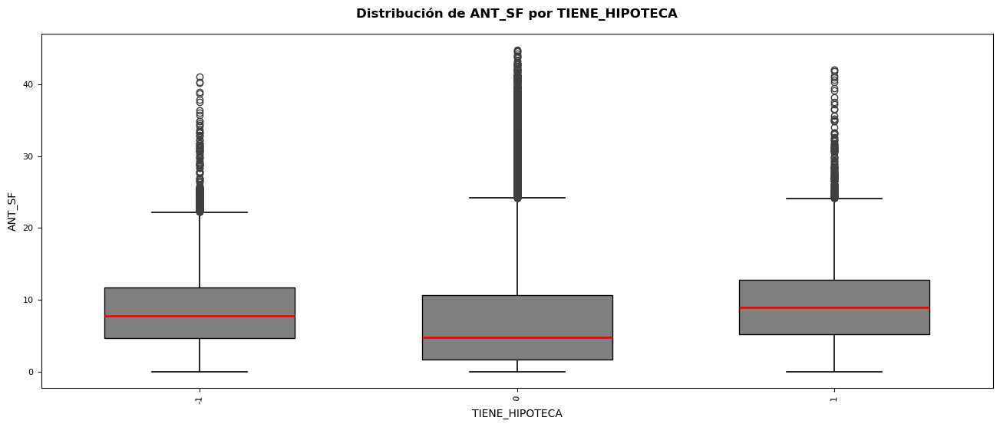

Prueba de Kruskal-Wallis: H-valor = 1754.293201817685, p-valor = 0.0
Análisis bivariado mixto entre SALDO_SF y SEXO


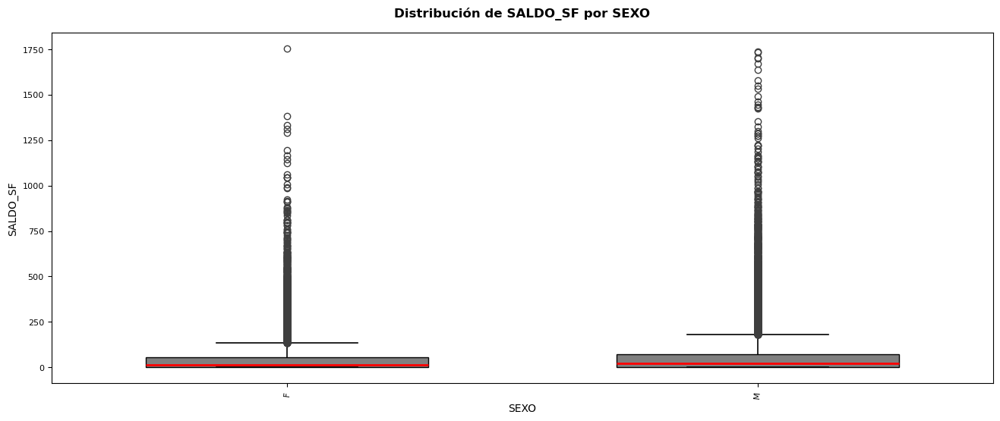

Prueba de Mann-Whitney U: U-valor = 180853956.0, p-valor = 2.2971255099949154e-61
Análisis bivariado mixto entre SALDO_SF y CRED_REESTRUCTURADO


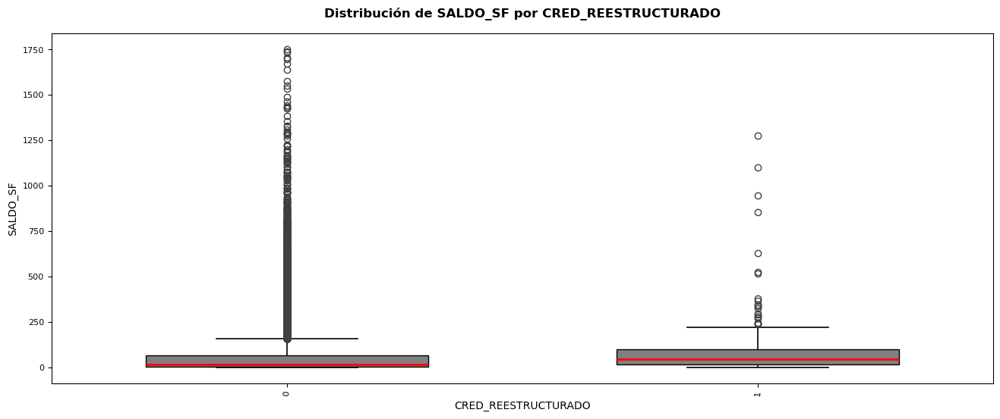

Prueba de Mann-Whitney U: U-valor = 3909675.5, p-valor = 3.3728534448068034e-15
Análisis bivariado mixto entre SALDO_SF y TIENE_HIPOTECA


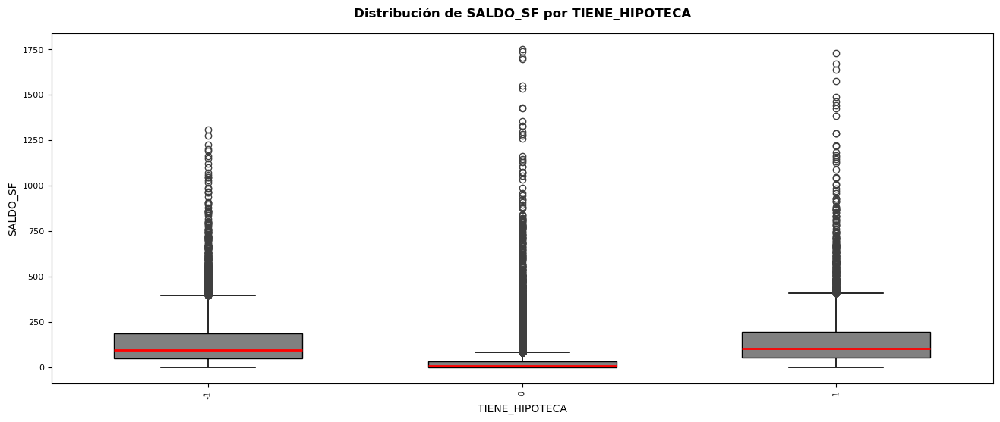

Prueba de Kruskal-Wallis: H-valor = 12013.839633915486, p-valor = 0.0
Análisis bivariado mixto entre ULTIMAPERTURA y SEXO


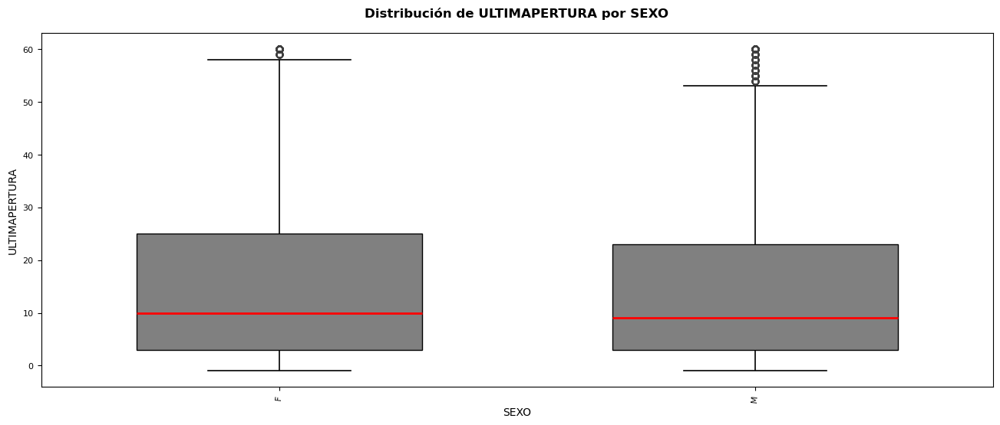

Prueba de Mann-Whitney U: U-valor = 202978086.0, p-valor = 0.007844373299531637
Análisis bivariado mixto entre ULTIMAPERTURA y CRED_REESTRUCTURADO


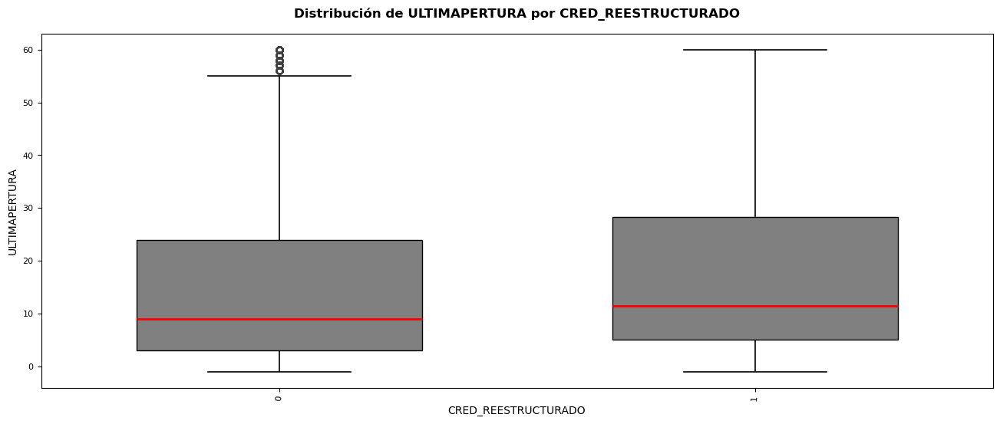

Prueba de Mann-Whitney U: U-valor = 4752407.5, p-valor = 0.0005901799503754679
Análisis bivariado mixto entre ULTIMAPERTURA y TIENE_HIPOTECA


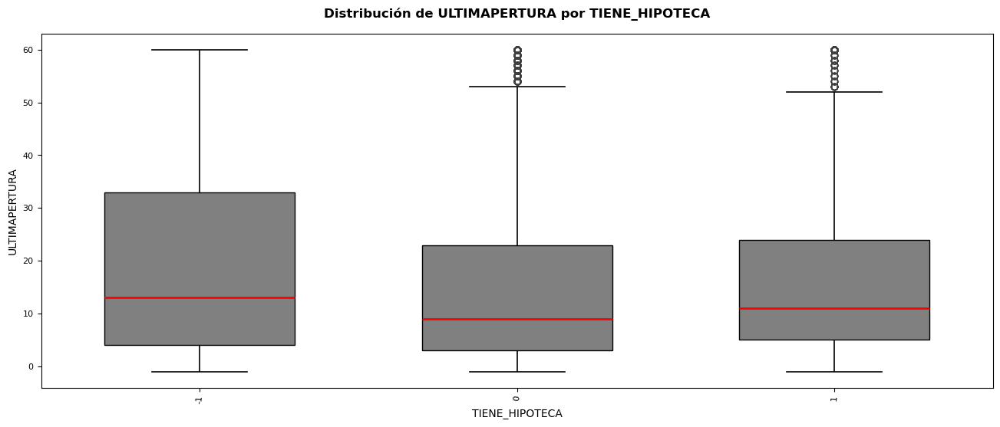

Prueba de Kruskal-Wallis: H-valor = 352.58808448886975, p-valor = 2.731934362844094e-77
Análisis bivariado mixto entre SALDO_FIJO y SEXO


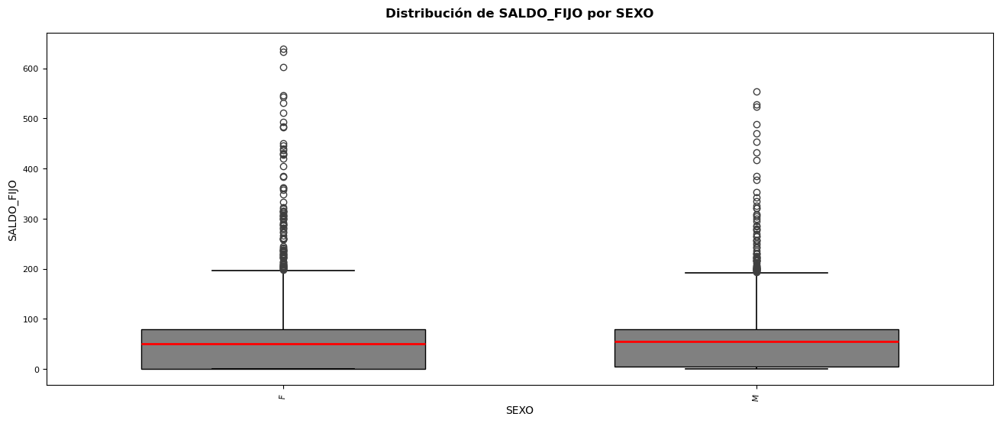

Prueba de Mann-Whitney U: U-valor = 192041276.0, p-valor = 6.3921352676173015e-12
Análisis bivariado mixto entre SALDO_FIJO y CRED_REESTRUCTURADO


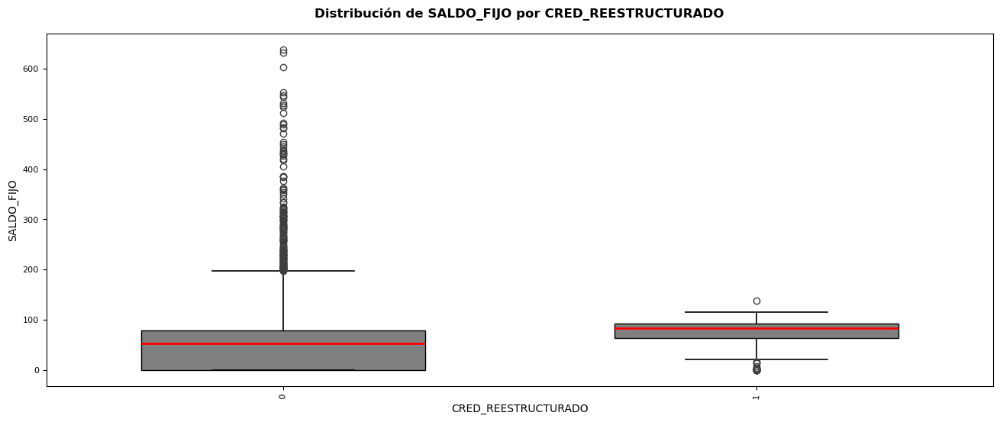

Prueba de Mann-Whitney U: U-valor = 2915236.0, p-valor = 8.405603528001552e-40
Análisis bivariado mixto entre SALDO_FIJO y TIENE_HIPOTECA


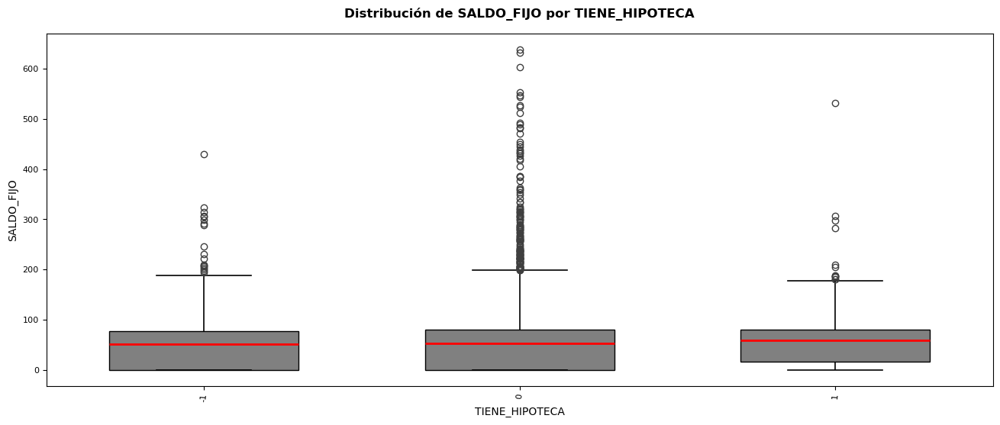

Prueba de Kruskal-Wallis: H-valor = 50.91906869483136, p-valor = 8.771315266486985e-12
Análisis bivariado mixto entre SALDO_ROT y SEXO


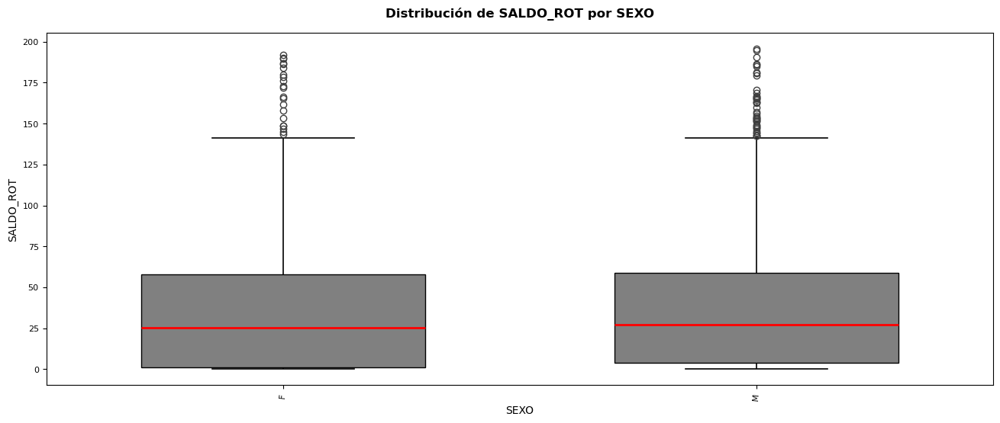

Prueba de Mann-Whitney U: U-valor = 193764461.0, p-valor = 8.750902695734014e-08
Análisis bivariado mixto entre SALDO_ROT y CRED_REESTRUCTURADO


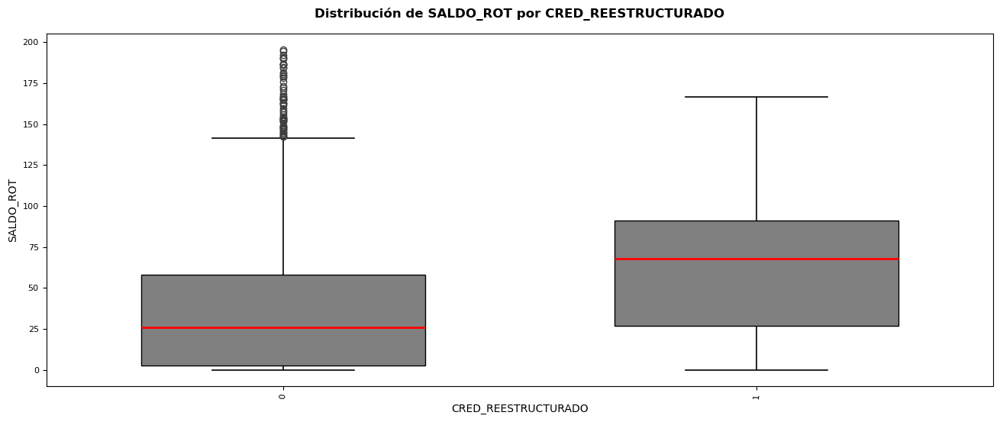

Prueba de Mann-Whitney U: U-valor = 3253189.0, p-valor = 5.562914334009551e-30
Análisis bivariado mixto entre SALDO_ROT y TIENE_HIPOTECA


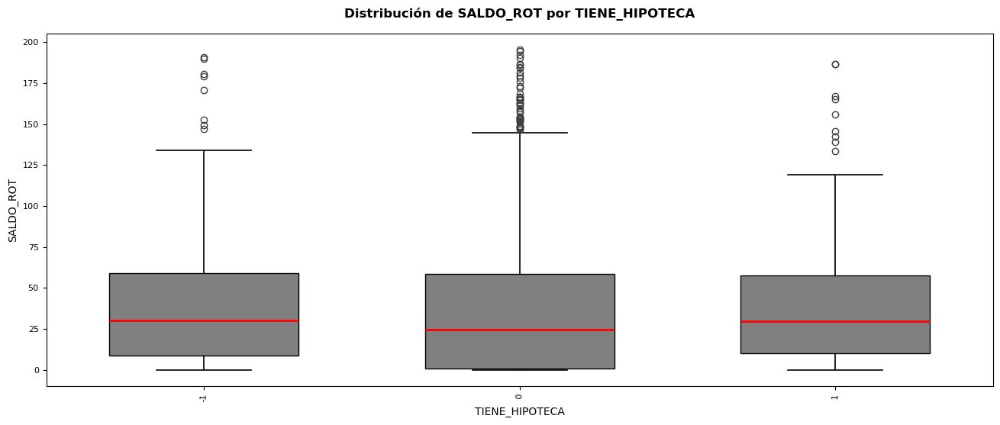

Prueba de Kruskal-Wallis: H-valor = 181.34318608805899, p-valor = 4.1862723153090585e-40
Análisis bivariado mixto entre ESTADO_MORA_FIN y SEXO


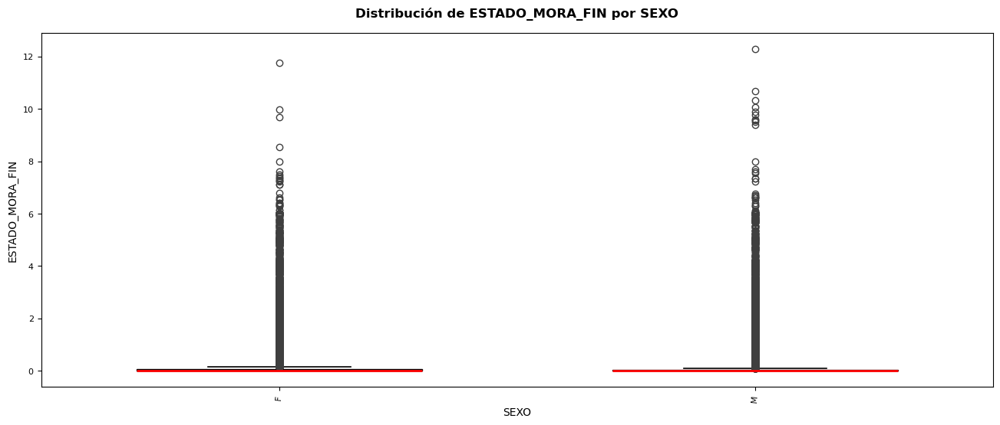

Prueba de Mann-Whitney U: U-valor = 201149094.0, p-valor = 0.17044939458915287
Análisis bivariado mixto entre ESTADO_MORA_FIN y CRED_REESTRUCTURADO


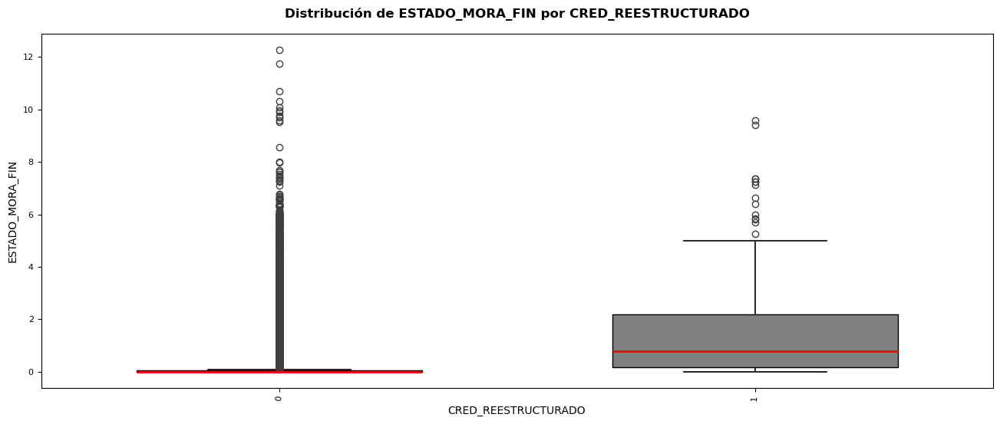

Prueba de Mann-Whitney U: U-valor = 1944942.0, p-valor = 6.469484694140219e-121
Análisis bivariado mixto entre ESTADO_MORA_FIN y TIENE_HIPOTECA


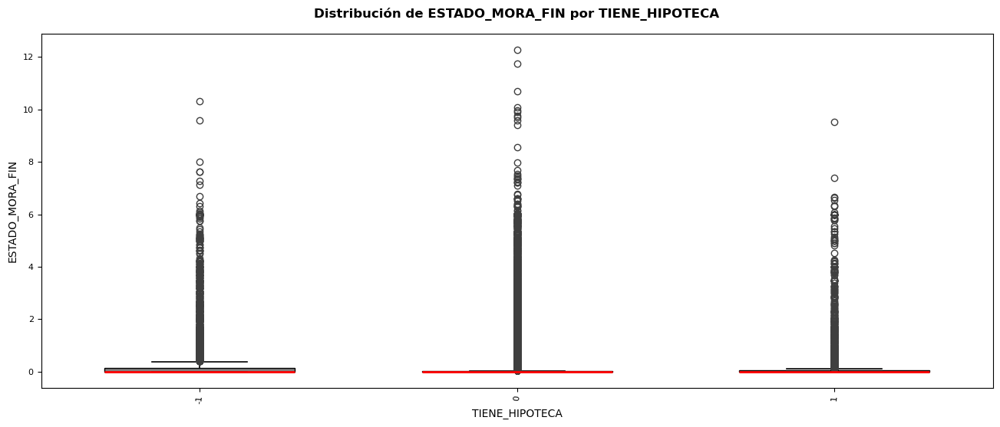

Prueba de Kruskal-Wallis: H-valor = 213.28630541764753, p-valor = 4.846935559723994e-47
Análisis bivariado mixto entre ESTADO_MORA_REAL y SEXO


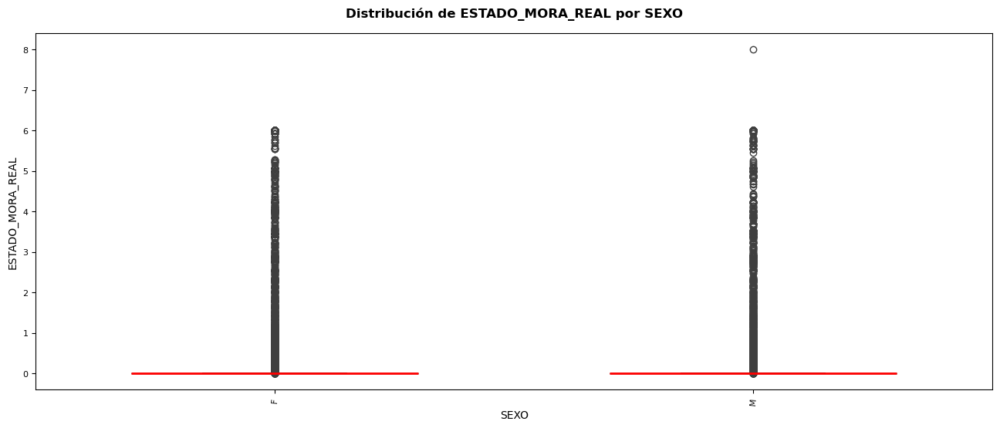

Prueba de Mann-Whitney U: U-valor = 202332625.0, p-valor = 6.0391063835830866e-05
Análisis bivariado mixto entre ESTADO_MORA_REAL y CRED_REESTRUCTURADO


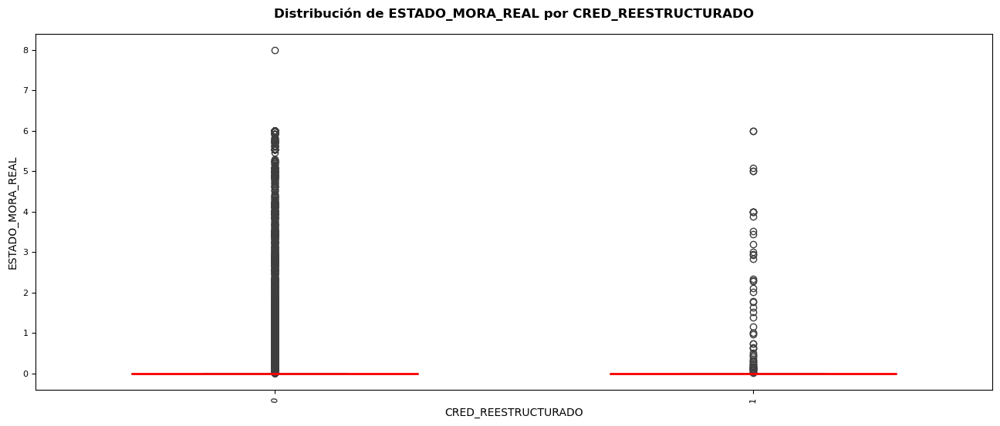

Prueba de Mann-Whitney U: U-valor = 4644859.5, p-valor = 1.938626781519142e-14
Análisis bivariado mixto entre ESTADO_MORA_REAL y TIENE_HIPOTECA


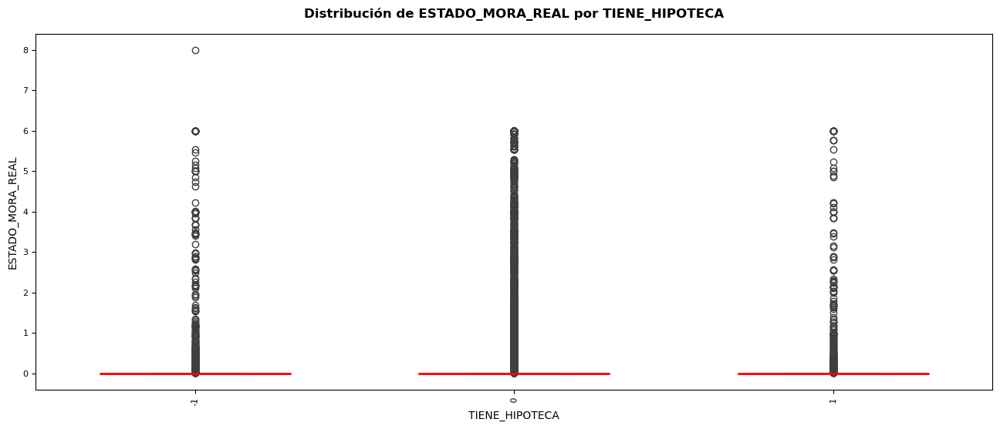

Prueba de Kruskal-Wallis: H-valor = 80.5340146090781, p-valor = 3.2528266908357366e-18


In [16]:
for col_num in num_cols:
    for col_cat in cat_cols:
        print(f'Análisis bivariado mixto entre {col_num} y {col_cat}')
        ut.analisis_bivariado_mixto(df, col_cat, col_num)

### **Transformación de variables**

In [25]:
df['SEXO'] = df['SEXO'].map({'M': 1, 'F': 0})

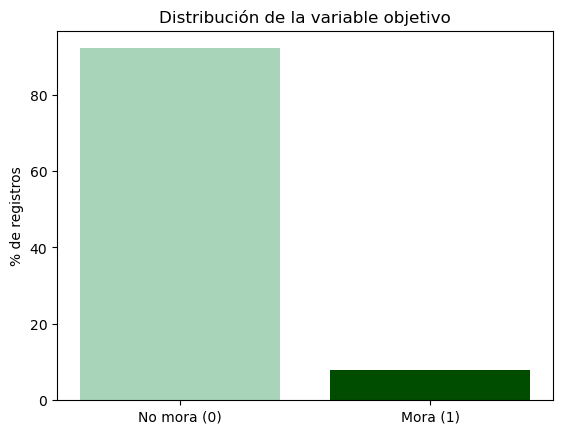

In [26]:
plt.bar(df['CLIENTE_MORA'].value_counts().index,
        df['CLIENTE_MORA'].value_counts(normalize=True)*100,
        color=['#A8D5BA', '#004d00'])
plt.title('Distribución de la variable objetivo')
plt.xticks([0,1], ['No mora (0)', 'Mora (1)'])
plt.ylabel('% de registros')
plt.show()

In [27]:
X = df.drop('CLIENTE_MORA', axis=1)
y = df['CLIENTE_MORA']

In [28]:
from sklearn.preprocessing import StandardScaler
X_scaled = StandardScaler().fit_transform(X)

In [30]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline
from collections import Counter

# Ver distribución inicial
print('Distribución original:', Counter(y))

# Paso 1: SMOTE - generar sintéticos para la clase 1 (hasta 0.4 del total de clase 0)
smote = SMOTE(sampling_strategy=0.4, random_state=42)

# Paso 2: UnderSampling - reducir clase 0 a una proporción 0.6 respecto a la clase 1
under = RandomUnderSampler(sampling_strategy=0.6, random_state=42)

# Pipeline combinado
steps = [('smote', smote), ('under', under)]
pipeline = Pipeline(steps=steps)

X_res, y_res = pipeline.fit_resample(X_scaled, y)

# Resultado final
print('Distribución balanceada:', Counter(y_res))

Distribución original: Counter({0: 36855, 1: 3145})
Distribución balanceada: Counter({0: 24570, 1: 14742})
